# Ambiguous hits

This notebook is designed to see how often we have hits that are ambiguous. I.e, masses that have multiple explanations

Want to show:
How frequently each mass in a spectrum is ambiguous

In [1]:
import os
import sys

module_path = os.path.abspath(os.path.join('..'))
if module_path not in sys.path:
    sys.path.append(module_path)
module_path = os.path.abspath(os.path.join('..', 'hypedsearch', 'src'))
if module_path not in sys.path:
    sys.path.append(module_path)
    
import testing_utils
import database

import operator

ppm_tolerance = 20
max_peptide_length = 20

import matplotlib.pyplot as plt

In [2]:
datasets = testing_utils.define_data()

dataset = datasets[0]

input_spectra_path = dataset[0]
input_spectra, boundaries = testing_utils.preprocess_input_spectra(input_spectra_path, ppm_tolerance)

correct_sequences = testing_utils.generate_truth_set(datasets[0])

path = dataset[2]
db = database.build(path)

Loading spectra...
Done


In [3]:
matched_masses_b, matched_masses_y, database = testing_utils.modified_match_masses(boundaries, db, max_peptide_length)
# matched_masses_b, matched_masses_y, database = match_masses(boundaries, db, max_peptide_length)
print('Finished matching masses')

On protein 279/279 [100%]
Sorting the set of protein masses...
Sorting the set of protein masses done
Performing Merge
Done
Finished matching masses


In [13]:
def print_matched_masses(matched_masses_b, matched_masses_y):
    with open('matched_masses_b.txt', 'w') as m:
        for x in matched_masses_b:
            m.write(str(x) + '\t' + str(matched_masses_b[x]) + '\n')
    with open('matched_masses_y.txt', 'w') as m:
        for x in matched_masses_y:
            m.write(str(x) + '\t' + str(matched_masses_y[x]) + '\n')   
            
print_matched_masses(matched_masses_b, matched_masses_y)

In [11]:
spectrum_num = 100
input_spectrum = input_spectra[spectrum_num]
with open('abundance_for_100.txt', 'w') as a:
    for i, abundance in enumerate(input_spectrum.abundance):
        a.write(str(input_spectrum.mz_values[i]) + '\t' + str(abundance) + '\n')


In [14]:
print(len('DEWMRIILEALRQAENEPPSAPKENKPYAL'))

30


In [56]:
import gen_spectra
from utils import ppm_to_da
from constants import PROTON_MASS, DOUBLY_CHARGED_B_BASE, DOUBLY_CHARGED_Y_BASE, WATER_MASS

def get_total_sum(m,z):
    total_sum = 0
    total_sum = (m * z) - (z * PROTON_MASS) - WATER_MASS
    return total_sum
def normalize_to_two(m, z):
    total_sum = get_total_sum(m, z)
    normalized_b = (DOUBLY_CHARGED_B_BASE + total_sum) / 2
    normalized_y = (DOUBLY_CHARGED_Y_BASE + total_sum) / 2
    return normalized_b, normalized_y

spectrum_num = 978
input_spectrum = input_spectra[spectrum_num]
correct_sequence = correct_sequences[spectrum_num]
print(correct_sequence)
print(input_spectrum.precursor_mass, input_spectrum.precursor_charge)

normalized_precursor_mass = normalize_to_two(input_spectrum.precursor_mass, input_spectrum.precursor_charge)
theoretical_precursor = max(gen_spectra.gen_spectrum(correct_sequence, 2, 'y')['spectrum'])
print(normalized_precursor_mass, theoretical_precursor)

DPLNPIKQ
462.766251 2
(453.76096868499997, 462.766251035) 462.761092285


In [57]:
precursor_tolerance = 12
spectrum_num = 978
input_spectrum = input_spectra[spectrum_num]
correct_sequence = correct_sequences[spectrum_num]
norm_b_prec, norm_y_prec = normalized_precursor_mass = normalize_to_two(input_spectrum.precursor_mass, input_spectrum.precursor_charge)
theoretical_precursor = max(gen_spectra.gen_spectrum(correct_sequence, 2, 'y')['spectrum'])

print(norm_y_prec, theoretical_precursor)
print(norm_y_prec - tol)
tol = ppm_to_da(theoretical_precursor, precursor_tolerance)
print(tol)
if not (testing_utils.isintolerance(norm_y_prec, theoretical_precursor, tol)):
    print('Ladies and Gentlemen, we have a normalizing fail at:', spectrum_num)

462.766251035 462.761092285
462.75618077865215
0.00555313310742


In [63]:
precursor_tolerance = 10
for spectrum_num in range(0, len(input_spectra)):
    input_spectrum = input_spectra[spectrum_num]
    correct_sequence = correct_sequences[spectrum_num]
    norm_b_prec, norm_y_prec = normalized_precursor_mass = normalize_to_two(input_spectrum.precursor_mass, input_spectrum.precursor_charge)
    theoretical_precursor = max(gen_spectra.gen_spectrum(correct_sequence, 2, 'y')['spectrum'])

    tol = ppm_to_da(theoretical_precursor, precursor_tolerance)
    if not (testing_utils.isintolerance(norm_y_prec, theoretical_precursor, tol)):
        print('Ladies and Gentlemen, we have a normalizing fail at:', spectrum_num)

Ladies and Gentlemen, we have a normalizing fail at: 825
Ladies and Gentlemen, we have a normalizing fail at: 978


# Looking for ambiguous hits

An ambiguous hit is a mass that can be defined by multiple sequences

In [8]:
from utils import hashable_boundaries

unique_matched_masses = dict()
for mz in boundaries.keys():
    key = boundaries[mz]
    unique_matched_masses[mz] = []
    key = hashable_boundaries(key)
    for x in matched_masses_b[key]:
        seq = x[2]
        if seq not in unique_matched_masses[mz]:
            unique_matched_masses[mz].append(seq)
    for x in matched_masses_y[key]:
        seq = x[2]
        if seq not in unique_matched_masses[mz]:
            unique_matched_masses[mz].append(seq)

In [9]:
for x in unique_matched_masses.keys():
    print(x, unique_matched_masses[x], len(unique_matched_masses[x]))

55.01727294921875 [] 0
55.05189895629883 [] 0
55.05296325683594 [] 0
55.05304718017578 [] 0
55.05307388305664 [] 0
55.053077697753906 [] 0
55.05308532714844 [] 0
55.0532112121582 [] 0
55.05325698852539 [] 0
55.05348205566406 [] 0
55.053497314453125 [] 0
55.05360794067383 [] 0
55.05362319946289 [] 0
55.053680419921875 [] 0
55.053802490234375 [] 0
55.05409622192383 [] 0
55.054161071777344 [] 0
55.0543212890625 [] 0
56.04767608642578 [] 0
56.04795455932617 [] 0
56.04802322387695 [] 0
56.048095703125 [] 0
56.048316955566406 [] 0
56.04841232299805 [] 0
56.04841613769531 [] 0
56.0484504699707 [] 0
56.04846954345703 [] 0
56.04851150512695 [] 0
56.048553466796875 [] 0
56.048580169677734 [] 0
56.048675537109375 [] 0
56.048797607421875 [] 0
56.048805236816406 [] 0
56.04880905151367 [] 0
56.048828125 [] 0
56.04888916015625 [] 0
56.04892349243164 [] 0
56.04893493652344 [] 0
56.04896545410156 [] 0
56.048980712890625 [] 0
56.049015045166016 [] 0
56.04902648925781 [] 0
56.04911422729492 [] 0
56.04912

70.0657730102539 [] 0
70.06580352783203 [] 0
70.06581115722656 [] 0
70.06584167480469 [] 0
70.06588745117188 [] 0
70.0658950805664 [] 0
70.06591796875 [] 0
70.06592559814453 [] 0
70.06597137451172 [] 0
70.06600189208984 [] 0
70.06607055664062 [] 0
70.06607818603516 [] 0
70.06609344482422 [] 0
70.06612396240234 [] 0
70.06613159179688 [] 0
70.0661849975586 [] 0
70.06620788574219 [] 0
70.06623077392578 [] 0
70.0662841796875 [] 0
70.06634521484375 [] 0
70.06636810302734 [] 0
70.06641387939453 [] 0
70.06661987304688 [] 0
71.04785919189453 [] 0
71.04805755615234 [] 0
71.04841613769531 [] 0
71.04853057861328 [] 0
71.04854583740234 [] 0
71.04855346679688 [] 0
71.04856872558594 [] 0
71.04869079589844 [] 0
71.04891967773438 [] 0
71.04947662353516 [] 0
71.04955291748047 [] 0
71.06840515136719 [] 0
71.06868743896484 [] 0
71.06880187988281 [] 0
71.06913757324219 [] 0
71.06930541992188 [] 0
72.078857421875 [] 0
72.07923889160156 [] 0
72.079345703125 [] 0
72.07940673828125 [] 0
72.0794448852539 [] 0


84.04442596435547 [] 0
84.04444122314453 [] 0
84.04444885253906 [] 0
84.0444564819336 [] 0
84.04446411132812 [] 0
84.04447174072266 [] 0
84.04448699951172 [] 0
84.04451751708984 [] 0
84.04456329345703 [] 0
84.04457092285156 [] 0
84.0445785522461 [] 0
84.04459381103516 [] 0
84.04460144042969 [] 0
84.04460906982422 [] 0
84.04461669921875 [] 0
84.04463958740234 [] 0
84.04464721679688 [] 0
84.0446548461914 [] 0
84.04466247558594 [] 0
84.044677734375 [] 0
84.04469299316406 [] 0
84.04470825195312 [] 0
84.04473876953125 [] 0
84.0447998046875 [] 0
84.0448226928711 [] 0
84.04488372802734 [] 0
84.0448989868164 [] 0
84.04491424560547 [] 0
84.044921875 [] 0
84.04499816894531 [] 0
84.0450210571289 [] 0
84.04503631591797 [] 0
84.04505157470703 [] 0
84.04507446289062 [] 0
84.0453109741211 [] 0
84.0454330444336 [] 0
84.04548645019531 [] 0
84.04551696777344 [] 0
84.04556274414062 [] 0
84.04557800292969 [] 0
84.0456314086914 [] 0
84.04583740234375 [] 0
84.04632568359375 [] 0
84.04682922363281 [] 0
84.07

86.0963363647461 [] 0
86.09634399414062 [] 0
86.09635162353516 [] 0
86.09635925292969 [] 0
86.09636688232422 [] 0
86.09637451171875 [] 0
86.09638214111328 [] 0
86.09638977050781 [] 0
86.09639739990234 [] 0
86.09640502929688 [] 0
86.0964126586914 [] 0
86.09642028808594 [] 0
86.09642791748047 [] 0
86.096435546875 [] 0
86.09644317626953 [] 0
86.09645080566406 [] 0
86.0964584350586 [] 0
86.09646606445312 [] 0
86.09647369384766 [] 0
86.09648132324219 [] 0
86.09648895263672 [] 0
86.09649658203125 [] 0
86.09650421142578 [] 0
86.09651184082031 [] 0
86.09651947021484 [] 0
86.09652709960938 [] 0
86.0965347290039 [] 0
86.09654235839844 [] 0
86.09654998779297 [] 0
86.0965576171875 [] 0
86.09656524658203 [] 0
86.09657287597656 [] 0
86.0965805053711 [] 0
86.09658813476562 [] 0
86.09659576416016 [] 0
86.09660339355469 [] 0
86.09661102294922 [] 0
86.09661865234375 [] 0
86.09662628173828 [] 0
86.09663391113281 [] 0
86.09664154052734 [] 0
86.09664916992188 [] 0
86.0966567993164 [] 0
86.09666442871094 []

88.03944396972656 ['S', 'SS'] 2
88.03945922851562 ['S', 'SS'] 2
88.03946685791016 ['S', 'SS'] 2
88.03947448730469 ['S', 'SS'] 2
88.03948974609375 ['S', 'SS'] 2
88.03949737548828 ['S', 'SS'] 2
88.03950500488281 ['S', 'SS'] 2
88.03951263427734 ['S', 'SS'] 2
88.03952026367188 ['S', 'SS'] 2
88.0395278930664 ['S', 'SS'] 2
88.03954315185547 ['S', 'SS'] 2
88.03955078125 ['S', 'SS'] 2
88.03956604003906 ['S', 'SS'] 2
88.0395736694336 ['S', 'SS'] 2
88.03958129882812 ['S', 'SS'] 2
88.03960418701172 ['S', 'SS'] 2
88.03961944580078 ['S', 'SS'] 2
88.03962707519531 ['S', 'SS'] 2
88.03965759277344 ['S', 'SS'] 2
88.03966522216797 ['S', 'SS'] 2
88.03968048095703 ['S', 'SS'] 2
88.03968811035156 ['S', 'SS'] 2
88.0396957397461 ['S', 'SS'] 2
88.03970336914062 ['S', 'SS'] 2
88.03971099853516 ['S', 'SS'] 2
88.03971862792969 ['S', 'SS'] 2
88.03974914550781 ['S', 'SS'] 2
88.03975677490234 ['S', 'SS'] 2
88.03977966308594 ['S', 'SS'] 2
88.039794921875 ['S', 'SS'] 2
88.0398178100586 ['S', 'SS'] 2
88.03983306884766

102.05435180664062 ['T', 'TT', 'PS', 'SP'] 4
102.05436706542969 ['T', 'TT', 'PS', 'SP'] 4
102.05439758300781 ['T', 'TT', 'PS', 'SP'] 4
102.05441284179688 ['T', 'TT', 'PS', 'SP'] 4
102.0544204711914 ['T', 'TT', 'PS', 'SP'] 4
102.05442810058594 ['T', 'TT', 'PS', 'SP'] 4
102.054443359375 ['T', 'TT', 'PS', 'SP'] 4
102.05445098876953 ['T', 'TT', 'PS', 'SP'] 4
102.0544662475586 ['T', 'TT', 'PS', 'SP'] 4
102.05448150634766 ['T', 'TT', 'PS', 'SP'] 4
102.05448913574219 ['T', 'TT', 'PS', 'SP'] 4
102.05449676513672 ['T', 'TT', 'PS', 'SP'] 4
102.05450439453125 ['T', 'TT', 'PS', 'SP'] 4
102.05451202392578 ['T', 'TT', 'PS', 'SP'] 4
102.05452728271484 ['T', 'TT', 'PS', 'SP'] 4
102.05453491210938 ['T', 'TT', 'PS', 'SP'] 4
102.0545425415039 ['T', 'TT', 'PS', 'SP'] 4
102.05457305908203 ['T', 'TT', 'PS', 'SP'] 4
102.05458068847656 ['T', 'TT', 'PS', 'SP'] 4
102.0545883178711 ['T', 'TT', 'PS', 'SP'] 4
102.05459594726562 ['T', 'TT', 'PS', 'SP'] 4
102.05460357666016 ['T', 'TT', 'PS', 'SP'] 4
102.054611206054

110.0704574584961 ['IS', 'SL', 'LS', 'SI', 'VT', 'TV'] 6
110.07048034667969 ['IS', 'SL', 'LS', 'SI', 'VT', 'TV'] 6
110.07057189941406 ['IS', 'SL', 'LS', 'SI', 'VT', 'TV'] 6
110.0705795288086 ['IS', 'SL', 'LS', 'SI', 'VT', 'TV'] 6
110.07058715820312 ['IS', 'SL', 'LS', 'SI', 'VT', 'TV'] 6
110.07059478759766 ['IS', 'SL', 'LS', 'SI', 'VT', 'TV'] 6
110.07063293457031 ['IS', 'SL', 'LS', 'SI', 'VT', 'TV'] 6
110.07066345214844 ['IS', 'SL', 'LS', 'SI', 'VT', 'TV'] 6
110.0707015991211 ['IS', 'SL', 'LS', 'SI', 'VT', 'TV'] 6
110.07071685791016 ['IS', 'SL', 'LS', 'SI', 'VT', 'TV'] 6
110.07072448730469 ['IS', 'SL', 'LS', 'SI', 'VT', 'TV'] 6
110.07076263427734 ['IS', 'SL', 'LS', 'SI', 'VT', 'TV'] 6
110.07078552246094 ['IS', 'SL', 'LS', 'SI', 'VT', 'TV'] 6
110.07079315185547 ['IS', 'SL', 'LS', 'SI', 'VT', 'TV'] 6
110.07081604003906 ['IS', 'SL', 'LS', 'SI', 'VT', 'TV'] 6
110.07083129882812 ['IS', 'SL', 'LS', 'SI', 'VT', 'TV'] 6
110.07083892822266 ['IS', 'SL', 'LS', 'SI', 'VT', 'TV'] 6
110.0708694458007

120.08043670654297 [] 0
120.0804443359375 [] 0
120.08045196533203 [] 0
120.08045959472656 [] 0
120.08047485351562 [] 0
120.08048248291016 [] 0
120.08049774169922 [] 0
120.08050537109375 [] 0
120.08051300048828 [] 0
120.08052062988281 [] 0
120.08052825927734 [] 0
120.08053588867188 [] 0
120.0805435180664 [] 0
120.08055114746094 [] 0
120.08055877685547 [] 0
120.08056640625 [] 0
120.08058166503906 [] 0
120.08059692382812 [] 0
120.08061981201172 [] 0
120.08062744140625 [] 0
120.08064270019531 [] 0
120.08065032958984 [] 0
120.08065795898438 [] 0
120.0806655883789 [] 0
120.08067321777344 [] 0
120.08068084716797 [] 0
120.08069610595703 [] 0
120.0807113647461 [] 0
120.08071899414062 [] 0
120.08072662353516 [] 0
120.08074188232422 [] 0
120.08074951171875 [] 0
120.08075714111328 [] 0
120.08076477050781 [] 0
120.08077239990234 [] 0
120.08078002929688 [] 0
120.0807876586914 [] 0
120.08079528808594 [] 0
120.080810546875 [] 0
120.08081817626953 [] 0
120.08082580566406 [] 0
120.0808334350586 [] 0
120

129.1007537841797 ['K', 'KK'] 2
129.1007843017578 ['K', 'KK'] 2
129.10079956054688 ['K', 'KK'] 2
129.10081481933594 ['K', 'KK'] 2
129.100830078125 ['K', 'KK'] 2
129.10084533691406 ['K', 'KK'] 2
129.1008758544922 ['K', 'KK'] 2
129.10089111328125 ['K', 'KK'] 2
129.1009063720703 ['K', 'KK'] 2
129.10092163085938 ['K', 'KK'] 2
129.10093688964844 ['K', 'KK'] 2
129.1009521484375 ['K', 'KK'] 2
129.10096740722656 ['K', 'KK'] 2
129.10098266601562 ['K', 'KK'] 2
129.1009979248047 ['K', 'KK'] 2
129.10101318359375 ['K', 'KK'] 2
129.1010284423828 ['K', 'KK'] 2
129.10104370117188 ['K', 'KK'] 2
129.10105895996094 ['K', 'KK'] 2
129.10107421875 ['K', 'KK'] 2
129.10108947753906 ['K', 'KK'] 2
129.1011199951172 ['K', 'KK'] 2
129.10113525390625 ['K', 'KK'] 2
129.1011505126953 ['K', 'KK'] 2
129.10116577148438 ['K', 'KK'] 2
129.10118103027344 ['K', 'KK'] 2
129.1011962890625 ['K', 'KK'] 2
129.10122680664062 ['K', 'KK'] 2
129.1012420654297 ['K', 'KK'] 2
129.10125732421875 ['K', 'KK'] 2
129.1012725830078 ['K', 'K

132.1029815673828 ['L', 'I'] 2
132.10365295410156 ['L', 'I'] 2
133.03013610839844 [] 0
133.0312042236328 [] 0
133.05972290039062 ['N', 'GG'] 2
133.05975341796875 ['N', 'GG'] 2
133.0599365234375 ['N', 'GG'] 2
133.06002807617188 ['N', 'GG'] 2
133.06008911132812 ['N', 'GG'] 2
133.0601043701172 ['N', 'GG'] 2
133.06021118164062 ['YT', 'TY', 'N', 'GG'] 4
133.06027221679688 ['YT', 'TY', 'N', 'GG'] 4
133.06040954589844 ['YT', 'TY', 'N', 'GG'] 4
133.0604248046875 ['YT', 'TY', 'N', 'GG'] 4
133.06048583984375 ['YT', 'TY', 'N', 'GG'] 4
133.0605010986328 ['YT', 'TY', 'N', 'GG'] 4
133.06056213378906 ['YT', 'TY', 'N', 'GG'] 4
133.06057739257812 ['YT', 'TY', 'N', 'GG'] 4
133.06060791015625 ['YT', 'TY', 'N', 'GG'] 4
133.0606231689453 ['YT', 'TY', 'N', 'GG'] 4
133.06063842773438 ['YT', 'TY', 'N', 'GG'] 4
133.06065368652344 ['YT', 'TY', 'N', 'GG'] 4
133.0606689453125 ['YT', 'TY', 'N', 'GG'] 4
133.06068420410156 ['YT', 'TY', 'N', 'GG'] 4
133.06069946289062 ['YT', 'TY', 'N', 'GG'] 4
133.0607452392578 ['YT'

136.07542419433594 ['GNV', 'VNG', 'VGN', 'NVG', 'GVN', 'NGV', 'AAGA', 'QAA', 'AAAG', 'AAQ', 'GAAA', 'GGGV', 'GGVG', 'AGAA', 'VGGG', 'GVGG', 'AQA'] 17
136.075439453125 ['GNV', 'VNG', 'VGN', 'NVG', 'GVN', 'NGV', 'AAGA', 'QAA', 'AAAG', 'AAQ', 'GAAA', 'GGGV', 'GGVG', 'AGAA', 'VGGG', 'GVGG', 'AQA'] 17
136.07546997070312 ['GNV', 'VNG', 'VGN', 'NVG', 'GVN', 'NGV', 'AAGA', 'QAA', 'AAAG', 'AAQ', 'GAAA', 'GGGV', 'GGVG', 'AGAA', 'VGGG', 'GVGG', 'AQA'] 17
136.0754852294922 ['GNV', 'VNG', 'VGN', 'NVG', 'GVN', 'NGV', 'AAGA', 'QAA', 'AAAG', 'AAQ', 'GAAA', 'GGGV', 'GGVG', 'AGAA', 'VGGG', 'GVGG', 'AQA'] 17
136.07550048828125 ['GNV', 'VNG', 'VGN', 'NVG', 'GVN', 'NGV', 'AAGA', 'QAA', 'AAAG', 'AAQ', 'GAAA', 'GGGV', 'GGVG', 'AGAA', 'VGGG', 'GVGG', 'AQA'] 17
136.0755157470703 ['GNV', 'VNG', 'VGN', 'NVG', 'GVN', 'NGV', 'AAGA', 'QAA', 'AAAG', 'AAQ', 'GAAA', 'GGGV', 'GGVG', 'AGAA', 'VGGG', 'GVGG', 'AQA'] 17
136.07553100585938 ['GNV', 'VNG', 'VGN', 'NVG', 'GVN', 'NGV', 'AAGA', 'QAA', 'AAAG', 'AAQ', 'GAAA', 'GGG

141.06781005859375 [] 0
141.09991455078125 [] 0
141.10011291503906 [] 0
141.10035705566406 [] 0
141.10086059570312 [] 0
141.10107421875 [] 0
141.10110473632812 [] 0
141.10116577148438 [] 0
141.10130310058594 [] 0
141.101318359375 [] 0
141.1013946533203 [] 0
141.1014404296875 [] 0
141.10150146484375 [] 0
141.10157775878906 [] 0
141.1016082763672 [] 0
141.10162353515625 [] 0
141.1016387939453 [] 0
141.10165405273438 [] 0
141.10166931152344 [] 0
141.10171508789062 [] 0
141.10174560546875 [] 0
141.1018829345703 [] 0
141.1019744873047 [] 0
141.10198974609375 [] 0
141.10203552246094 [] 0
141.10208129882812 [] 0
141.1021270751953 [] 0
141.10226440429688 [] 0
141.1024169921875 [] 0
141.10244750976562 [] 0
141.10284423828125 [] 0
141.10302734375 [] 0
141.10317993164062 [] 0
141.10354614257812 [] 0
141.10447692871094 [] 0
141.1047821044922 [] 0
141.10491943359375 [] 0
142.05029296875 [] 0
142.0686798095703 ['TY', 'YT'] 2
142.08485412597656 [] 0
142.08538818359375 [] 0
142.08592224121094 [] 0
142

148.06016540527344 ['YM', 'MY', 'E'] 3
148.06027221679688 ['YM', 'MY', 'E'] 3
148.06031799316406 ['YM', 'MY', 'E'] 3
148.06033325195312 ['YM', 'MY', 'E'] 3
148.0603790283203 ['YM', 'MY', 'E'] 3
148.06039428710938 ['YM', 'MY', 'E'] 3
148.06044006347656 ['YM', 'MY', 'E'] 3
148.06048583984375 ['YM', 'MY', 'E'] 3
148.06051635742188 ['YM', 'MY', 'E'] 3
148.06056213378906 ['YM', 'MY', 'E'] 3
148.0605926513672 ['YM', 'MY', 'E'] 3
148.06060791015625 ['YM', 'MY', 'E'] 3
148.0606231689453 ['YM', 'MY', 'E'] 3
148.06063842773438 ['YM', 'MY', 'E'] 3
148.06076049804688 ['YM', 'MY', 'E'] 3
148.06077575683594 ['YM', 'MY', 'E'] 3
148.060791015625 ['YM', 'MY', 'E'] 3
148.0608367919922 ['YM', 'MY', 'E'] 3
148.06085205078125 ['YM', 'MY', 'E'] 3
148.06088256835938 ['YM', 'MY', 'E'] 3
148.06089782714844 ['YM', 'MY', 'E'] 3
148.0609130859375 ['YM', 'MY', 'E'] 3
148.0609893798828 ['YM', 'MY', 'E'] 3
148.06106567382812 ['YM', 'MY', 'E'] 3
148.06109619140625 ['YM', 'MY', 'E'] 3
148.06112670898438 ['YM', 'MY', '

159.0892333984375 [] 0
159.08938598632812 [] 0
159.08949279785156 [] 0
159.0895233154297 [] 0
159.08961486816406 [] 0
159.08966064453125 [] 0
159.08998107910156 [] 0
159.09022521972656 [] 0
159.09034729003906 [] 0
159.09036254882812 [] 0
159.09051513671875 [] 0
159.09056091308594 [] 0
159.09059143066406 [] 0
159.09066772460938 [] 0
159.0907745361328 [] 0
159.09078979492188 [] 0
159.0908203125 [] 0
159.09092712402344 [] 0
159.0909423828125 [] 0
159.09097290039062 [] 0
159.0909881591797 [] 0
159.09100341796875 [] 0
159.09103393554688 [] 0
159.09104919433594 [] 0
159.091064453125 [] 0
159.09107971191406 [] 0
159.0911102294922 [] 0
159.09112548828125 [] 0
159.09115600585938 [] 0
159.09121704101562 [] 0
159.0912628173828 [] 0
159.09127807617188 [] 0
159.09129333496094 [] 0
159.09132385253906 [] 0
159.0913543701172 [] 0
159.09140014648438 [] 0
159.09141540527344 [] 0
159.09149169921875 ['TSK', 'STK', 'TKS', 'KTS', 'KST', 'SKT', 'ANI', 'AIN', 'ANL', 'ALN', 'LAN', 'LNA', 'NIA', 'NAI', 'IAN', '

166.08619689941406 ['VSSG', 'GSSV', 'SGSV', 'KSD', 'SVSG', 'SSVG', 'DKS', 'SKD', 'DSK', 'KDS', 'SDK', 'GSVS', 'VSGS', 'VGSS', 'GVSS', 'SGVS', 'SVGS', 'SAAT', 'ASAT', 'AAST', 'ASTA', 'ATSA', 'ATAS', 'AATS', 'TAAS', 'TASA', 'SATA', 'STAA', 'TSAA', 'ATTG', 'TTAG', 'TATG', 'GATT', 'TQT', 'TTQ', 'QTT', 'GTAT', 'AGTT', 'TGTA', 'TGAT', 'GTTA', 'ATGT', 'GSPA', 'GPAS', 'GASP', 'GAPS', 'GSAP', 'GPSA', 'QPS', 'SQP', 'QSP', 'ASGP', 'SPAG', 'PSQ', 'NTP', 'NPT', 'PGAS', 'SPQ', 'TPN', 'PTN', 'AGSP', 'PNT', 'PQS', 'SPGA', 'SAPG', 'APGS', 'PSAG', 'PGSA', 'TNP', 'PASG', 'SAGP', 'AGPS', 'APSG', 'PAGS', 'ASPG', 'SGAP', 'PSGA', 'SGPA', 'GTGP', 'GTPG', 'GPGT', 'GGPT', 'GPTG', 'PGGT', 'TPGG', 'PTGG', 'PGTG', 'TGPG', 'F'] 89
166.0862274169922 ['VSSG', 'GSSV', 'SGSV', 'KSD', 'SVSG', 'SSVG', 'DKS', 'SKD', 'DSK', 'KDS', 'SDK', 'GSVS', 'VSGS', 'VGSS', 'GVSS', 'SGVS', 'SVGS', 'SAAT', 'ASAT', 'AAST', 'ASTA', 'ATSA', 'ATAS', 'AATS', 'TAAS', 'TASA', 'SATA', 'STAA', 'TSAA', 'ATTG', 'TTAG', 'TATG', 'GATT', 'TQT', 'TTQ'

172.07162475585938 ['NNN', 'NG', 'GN', 'GNNG', 'GGGGN', 'GGGGGG', 'GGG'] 7
172.1045379638672 ['AASL', 'ASAI', 'ASAL', 'SAAL', 'SVVG', 'AASI', 'SAAI', 'SALA', 'SGVV', 'GSVV', 'AISA', 'DVK', 'KVD', 'VKD', 'KDV', 'ALAS', 'VDK', 'DKV', 'SIAA', 'VVGS', 'ISAA', 'AAIS', 'IASA', 'ALSA', 'LAAS', 'ASLA', 'GVVS', 'SLAA', 'LSAA', 'VGSV', 'LASA', 'GVSV', 'AALS', 'ASIA', 'SAIA', 'SVGV', 'IAAS', 'TALG', 'LTAG', 'IATG', 'ATLG', 'LATG', 'TAIG', 'TIAG', 'TLAG', 'AITG', 'QLT', 'ATVA', 'LTQ', 'LQT', 'GATL', 'TLQ', 'GLTA', 'ALGT', 'AVTA', 'QIT', 'IQT', 'TQL', 'QTL', 'TGLA', 'TAGL', 'TIQ', 'GLAT', 'QTI', 'AGTL', 'TLGA', 'TAAV', 'AVAT', 'ATGI', 'VTAA', 'TVAA', 'GTAI', 'AAVT', 'TQI', 'GTIA', 'ITQ', 'LGTA', 'ATGL', 'GTAL', 'TAVA', 'ATAV', 'VATA', 'LTGA', 'LAGT', 'GALT', 'GAIT', 'AGTI', 'GTLA', 'IGAT', 'AGLT', 'TGAL', 'AATV', 'TIGA', 'AGIT', 'GITA', 'AIGT', 'LGAT', 'PLN', 'LPN', 'IPN', 'NIP', 'NPL', 'PIN', 'PNI', 'NPI', 'PNL', 'LNP', 'INP', 'NLP', 'GGLP', 'GPVA', 'GPAV', 'GLPG', 'GLGP', 'GPGI', 'GAPV', 'GGPI', 

174.13372802734375 [] 0
175.07029724121094 ['SS', 'SSSS', 'SNE', 'SEN', 'NES', 'NSE', 'ESN', 'ENS', 'SDQ', 'SEGG', 'SQD', 'SGGE', 'ASDG', 'SDGA', 'GGES', 'GDSA', 'AGSD', 'SGEG', 'SADG', 'SDAG', 'ASGD', 'ADGS', 'SGAD', 'GGSE', 'AGDS', 'GDAS', 'SAGD', 'ADSG', 'QDS', 'EGSG', 'DQS', 'DTN', 'GSDA', 'DSQ', 'TDN', 'GSAD', 'QSD', 'ESGG', 'DASG', 'EGGS', 'TND', 'GADS', 'GEGS', 'GSGE', 'NDT', 'DNT', 'DGAS', 'NTD', 'GASD', 'GSEG', 'DSGA', 'GESG', 'DSAG', 'GGDT', 'GDGT', 'GTGD', 'TGGD', 'GTDG', 'TGDG', 'GDTG', 'DGTG'] 61
175.0704803466797 ['SS', 'SSSS', 'SNE', 'SEN', 'NES', 'NSE', 'ESN', 'ENS', 'SDQ', 'SEGG', 'SQD', 'SGGE', 'ASDG', 'SDGA', 'GGES', 'GDSA', 'AGSD', 'SGEG', 'SADG', 'SDAG', 'ASGD', 'ADGS', 'SGAD', 'GGSE', 'AGDS', 'GDAS', 'SAGD', 'ADSG', 'QDS', 'EGSG', 'DQS', 'DTN', 'GSDA', 'DSQ', 'TDN', 'GSAD', 'QSD', 'ESGG', 'DASG', 'EGGS', 'TND', 'GADS', 'GEGS', 'GSGE', 'NDT', 'DNT', 'DGAS', 'NTD', 'GASD', 'GSEG', 'DSGA', 'GESG', 'DSAG', 'GGDT', 'GDGT', 'GTGD', 'TGGD', 'GTDG', 'TGDG', 'GDTG', 'DGTG'

177.08665466308594 ['AS', 'SA', 'GT', 'TG'] 4
177.08782958984375 ['AS', 'SA', 'GT', 'TG'] 4
177.0894317626953 ['AS', 'SA', 'GT', 'TG'] 4
177.10037231445312 ['KHS', 'HKS', 'KSH', 'HSK', 'SHK', 'SKH'] 6
177.1016845703125 ['KHS', 'HKS', 'KSH', 'HSK', 'SHK', 'SKH'] 6
177.10214233398438 ['KHS', 'HKS', 'KSH', 'HSK', 'SHK', 'SKH'] 6
177.10223388671875 ['KHS', 'HKS', 'KSH', 'HSK', 'SHK', 'SKH'] 6
177.1024627685547 ['KHS', 'HKS', 'KSH', 'HSK', 'SHK', 'SKH'] 6
177.1024932861328 ['KHS', 'HKS', 'KSH', 'HSK', 'SHK', 'SKH'] 6
177.1025848388672 ['KHS', 'HKS', 'KSH', 'HSK', 'SHK', 'SKH'] 6
178.10494995117188 ['SPGL', 'PSLG', 'SPIG', 'PLSG', 'ISPG', 'SAPV', 'SIPG', 'SLPG', 'GPSI', 'PSGL', 'PGSI', 'APSV', 'PSIG', 'LSPG', 'SGPL', 'PGSL', 'SPGI', 'GSPL', 'PSAV', 'SPAV', 'GPSL', 'PSGI', 'PASV', 'LPSG', 'SGPI', 'GLSP', 'PKE', 'VPSA', 'PEK', 'EKP', 'EPK', 'SVPA', 'GLPS', 'KEP', 'KPE', 'VASP', 'GISP', 'VSPA', 'PAVS', 'GPIS', 'AVSP', 'SGLP', 'PVSA', 'GPLS', 'SGIP', 'SPVA', 'ISGP', 'GIPS', 'LGSP', 'VSAP', 'LPGS

183.1149444580078 ['PGPL', 'GPLP', 'GIPP', 'PGPI', 'PPVA', 'PLGP', 'PVPA', 'GPPL', 'LPGP', 'PAVP', 'GLPP', 'VAPP', 'PPLG', 'GPPI', 'PPGL', 'APVP', 'VPPA', 'PGLP', 'LGPP', 'PPGI', 'PVAP', 'PGIP', 'PIPG', 'VPAP', 'IPGP', 'LPPG', 'PLPG', 'IGPP', 'IPPG', 'AVPP', 'PPIG', 'APPV', 'PAPV', 'PPAV', 'KHV', 'HKV', 'HVK', 'VHK', 'KVH', 'VKH', 'AFK', 'KFA', 'AKF', 'KAF', 'FKA', 'FAK'] 46
183.14596557617188 [] 0
183.14669799804688 [] 0
183.14735412597656 [] 0
183.1475372314453 [] 0
183.14773559570312 [] 0
183.1477508544922 [] 0
183.1479034423828 [] 0
183.14793395996094 [] 0
183.1481170654297 [] 0
183.1481475830078 [] 0
183.14842224121094 [] 0
183.1484375 [] 0
183.14857482910156 [] 0
183.14866638183594 [] 0
183.14891052246094 [] 0
183.14898681640625 [] 0
183.14903259277344 [] 0
183.1491241455078 [] 0
183.14915466308594 [] 0
183.14927673339844 [] 0
183.1492919921875 [] 0
183.14932250976562 [] 0
183.1494598388672 [] 0
183.14950561523438 [] 0
183.14952087402344 [] 0
183.1495819091797 [] 0
183.1496124267

185.12696838378906 ['LA', 'IA', 'AI', 'AL', 'ILAA', 'LLAA', 'ALLA', 'IIAA', 'LALA', 'LAIA', 'LIAA', 'IALA', 'ALIA', 'AALI', 'AALL', 'LAAL', 'GVLV', 'IVGV', 'AAIL', 'VVIG', 'VVAV', 'AAII', 'ALAL', 'VVGI', 'VGLV', 'VGIV', 'GIVV', 'VLVG', 'GLVV', 'GVVL', 'GVIV', 'VLGV', 'IAAL', 'LGVV', 'GVVI', 'VGVL', 'AVVV', 'LAAI', 'VVLG', 'IAAI', 'IVVG', 'ALAI', 'IGVV', 'VVVA'] 44
185.1271209716797 ['LA', 'IA', 'AI', 'AL', 'ILAA', 'LLAA', 'ALLA', 'IIAA', 'LALA', 'LAIA', 'LIAA', 'IALA', 'ALIA', 'AALI', 'AALL', 'LAAL', 'GVLV', 'IVGV', 'AAIL', 'VVIG', 'VVAV', 'AAII', 'ALAL', 'VVGI', 'VGLV', 'VGIV', 'GIVV', 'VLVG', 'GLVV', 'GVVL', 'GVIV', 'VLGV', 'IAAL', 'LGVV', 'GVVI', 'VGVL', 'AVVV', 'LAAI', 'VVLG', 'IAAI', 'IVVG', 'ALAI', 'IGVV', 'VVVA'] 44
185.12734985351562 ['LA', 'IA', 'AI', 'AL', 'ILAA', 'LLAA', 'ALLA', 'IIAA', 'LALA', 'LAIA', 'LIAA', 'IALA', 'ALIA', 'AALI', 'AALL', 'LAAL', 'GVLV', 'IVGV', 'AAIL', 'VVIG', 'VVAV', 'AAII', 'ALAL', 'VVGI', 'VGLV', 'VGIV', 'GIVV', 'VLVG', 'GLVV', 'GVVL', 'GVIV', 'VLGV',

187.07009887695312 ['NEE', 'EEN', 'ENE', 'DA', 'AD', 'EEGG', 'EGDA', 'GDEA', 'GEDA', 'EDGA', 'DADA', 'EADG', 'DGEA', 'EG', 'GE', 'EQD', 'QDE', 'DQE', 'AEGD', 'DEQ', 'QED', 'GGEE', 'EDQ', 'EGAD', 'EGGE', 'DAGE', 'AGDE', 'DEAG', 'EAGD', 'GEEG', 'DAEG', 'GADE', 'GEGE', 'EDAG', 'EGEG', 'ADEG', 'GDAE', 'GEAD', 'ADAD', 'AEDG', 'DAAD', 'CNH', 'NHC', 'CHN', 'NCH', 'CHGG'] 46
187.07032775878906 ['NEE', 'EEN', 'ENE', 'DA', 'AD', 'EEGG', 'EGDA', 'GDEA', 'GEDA', 'EDGA', 'DADA', 'EADG', 'DGEA', 'EG', 'GE', 'EQD', 'QDE', 'DQE', 'AEGD', 'DEQ', 'QED', 'GGEE', 'EDQ', 'EGAD', 'EGGE', 'DAGE', 'AGDE', 'DEAG', 'EAGD', 'GEEG', 'DAEG', 'GADE', 'GEGE', 'EDAG', 'EGEG', 'ADEG', 'GDAE', 'GEAD', 'ADAD', 'AEDG', 'DAAD', 'CNH', 'NHC', 'CHN', 'NCH', 'CHGG'] 46
187.07058715820312 ['NEE', 'EEN', 'ENE', 'DA', 'AD', 'EEGG', 'EGDA', 'GDEA', 'GEDA', 'EDGA', 'DADA', 'EADG', 'DGEA', 'EG', 'GE', 'EQD', 'QDE', 'DQE', 'AEGD', 'DEQ', 'QED', 'GGEE', 'EDQ', 'EGAD', 'EGGE', 'DAGE', 'AGDE', 'DEAG', 'EAGD', 'GEEG', 'DAEG', 'GADE', '

187.1082763671875 ['SV', 'VS', 'VVSS', 'SVVS', 'VSVS', 'SSVV', 'SVSV', 'VSSV', 'TSIA', 'TLAS', 'ATLS', 'TLSA', 'LATS', 'ISTA', 'TALS', 'ITAS', 'SLTA', 'STLA', 'ALTS', 'LTSA', 'LTAS', 'TISA', 'ATIS', 'TIAS', 'TAIS', 'ITSA', 'STIA', 'IATS', 'LSTA', 'LAST', 'SALT', 'TSAL', 'ASLT', 'SIAT', 'ALST', 'ASTL', 'AIST', 'ISAT', 'SLAT', 'STAL', 'IAST', 'ASIT', 'ATSL', 'STAI', 'ASTI', 'LSAT', 'SATL', 'TASL', 'VATT', 'TTLG', 'TITG', 'AVTT', 'TATV', 'ITGT', 'TTGL', 'LGTT', 'TTIG', 'GLTT', 'GTIT', 'TTGI', 'ATVT', 'TGLT', 'ITTG', 'TGTI', 'LTGT', 'TLTG', 'TTAV', 'ATTV', 'TGTL', 'TLGT', 'VTTA', 'VTAT', 'TTVA', 'TVAT', 'TVTA', 'SAPV', 'SGIP', 'SPAV', 'PVSA', 'SPVA', 'ASVP', 'PGSI', 'AVPS', 'PLSG', 'SGLP', 'GISP', 'GIPS', 'SPGI', 'SLPG', 'PLGS', 'SIPG', 'GLSP', 'SGPL', 'AVSP', 'GLPS', 'SAVP', 'SVPA', 'SPGL', 'SLGP', 'SGPI', 'SPIG', 'PVAS', 'PGSL', 'APVS', 'APSV', 'SVAP', 'PGIS', 'SIGP', 'EPK', 'EKP', 'KPE', 'GPSI', 'KEP', 'ISPG', 'VAPS', 'LSPG', 'GPSL', 'LPGS', 'VSAP', 'GSLP', 'GSPL', 'VSPA', 'VASP', 'GPIS

197.12823486328125 ['PV', 'VP', 'VPVP', 'PVVP', 'PVPV', 'PPVV', 'VPPV', 'FVK', 'VKF', 'KFV', 'FKV', 'KVF', 'VFK'] 13
197.1282501220703 ['PV', 'VP', 'VPVP', 'PVVP', 'PVPV', 'PPVV', 'VPPV', 'FVK', 'VKF', 'KFV', 'FKV', 'KVF', 'VFK'] 13
197.12826538085938 ['PV', 'VP', 'VPVP', 'PVVP', 'PVPV', 'PPVV', 'VPPV', 'FVK', 'VKF', 'KFV', 'FKV', 'KVF', 'VFK'] 13
197.1283721923828 ['PV', 'VP', 'VPVP', 'PVVP', 'PVPV', 'PPVV', 'VPPV', 'FVK', 'VKF', 'KFV', 'FKV', 'KVF', 'VFK'] 13
197.12843322753906 ['PV', 'VP', 'VPVP', 'PVVP', 'PVPV', 'PPVV', 'VPPV', 'FVK', 'VKF', 'KFV', 'FKV', 'KVF', 'VFK'] 13
197.12844848632812 ['PV', 'VP', 'VPVP', 'PVVP', 'PVPV', 'PPVV', 'VPPV', 'FVK', 'VKF', 'KFV', 'FKV', 'KVF', 'VFK'] 13
197.1284637451172 ['PV', 'VP', 'VPVP', 'PVVP', 'PVPV', 'PPVV', 'VPPV', 'FVK', 'VKF', 'KFV', 'FKV', 'KVF', 'VFK'] 13
197.1284942626953 ['PV', 'VP', 'VPVP', 'PVVP', 'PVPV', 'PPVV', 'VPPV', 'FVK', 'VKF', 'KFV', 'FKV', 'KVF', 'VFK'] 13
197.12850952148438 ['PV', 'VP', 'VPVP', 'PVVP', 'PVPV', 'PPVV', 'VPP

199.1072235107422 ['HMK', 'HKM', 'MKH', 'KMH', 'KHM', 'DPLA', 'PIDA', 'ELGP', 'EPVA', 'VPEA', 'LDPA', 'EGLP', 'IADP', 'PLDA', 'GELP', 'EAVP', 'DLPA', 'PDLA', 'EIGP', 'EPLG', 'ADLP', 'EGIP', 'EVPA', 'LPDA', 'LADP', 'DIPA', 'DAIP', 'VEPA', 'LEGP', 'IPDA', 'DALP', 'IPAD', 'PVAE', 'APLD', 'APID', 'EPGI', 'VAPE', 'PAEV', 'PGEL', 'AEPV', 'PLEG', 'PEAV', 'DAPL', 'PGLE', 'LAPD', 'PEGI', 'DPAI', 'LPEG', 'VPAE', 'PDAL', 'PAID', 'PEGL', 'LEPG', 'LPAD', 'PADL', 'PADI', 'APDL', 'IGPE', 'ELPG', 'PELG', 'APDI', 'GPLE', 'GLPE', 'ALPD', 'GEPI', 'PIEG', 'EAPV', 'DPAL', 'AVPE', 'IPEG', 'LPGE', 'LGPE', 'ADPL', 'APVE', 'EGPL', 'PALD', 'PAVE', 'EPGL', 'EIPG', 'GEPL', 'GPIE', 'GIPE', 'PDAI', 'APEV', 'DAPI', 'AIPD', 'LGEP', 'GLEP', 'DLAP', 'VAEP', 'AVEP', 'AEVP', 'IGEP', 'PEVA', 'IDAP', 'PT', 'TP', 'TPTP', 'PTTP', 'PTPT', 'PPTT', 'TPPT', 'TTPP', 'SYK', 'KYS', 'YKS', 'SKY', 'KSY', 'YSK', 'PPSP', 'PPPS', 'SPPP', 'PSPP'] 113
199.1072998046875 ['HMK', 'HKM', 'MKH', 'KMH', 'KHM', 'DPLA', 'PIDA', 'ELGP', 'EPVA', 'V

201.12210083007812 ['RPF', 'PFR', 'FPR', 'PRF', 'RFP', 'FRP', 'IRM', 'LRM', 'RMI', 'MRL', 'MLR', 'LMR', 'RML', 'RLM', 'IMR', 'MRI', 'MIR', 'RIM', 'ILSS', 'LS', 'SL', 'SI', 'IS', 'LSLS', 'SIIS', 'IISS', 'LLSS', 'LSIS', 'SILS', 'SLIS', 'ISLS', 'SLLS', 'ISIS', 'ISSI', 'SLSL', 'SSIL', 'LSSL', 'SLSI', 'ISSL', 'LSSI', 'SSLI', 'SSLL', 'SSII', 'STLV', 'SLVT', 'TISV', 'TLSV', 'ISTV', 'STVL', 'ISVT', 'SVTL', 'VSLT', 'TSVL', 'SVIT', 'VSTI', 'ITSV', 'SLTV', 'VSIT', 'SVLT', 'LSVT', 'LSTV', 'VSTL', 'SVTI', 'TVSI', 'LVST', 'IVST', 'VLTS', 'IVTS', 'VIST', 'VITS', 'TVLS', 'VTIS', 'VTLS', 'VLST', 'TLVS', 'LTVS', 'VTSL', 'TVIS', 'LVTS', 'VTSI', 'ITVS', 'VT', 'TV', 'VVTT', 'VTVT', 'VTTV', 'TVTV', 'TVVT', 'SPVV', 'VPSV', 'VSVP', 'VVPS', 'VPVS', 'VVSP', 'VSPV', 'PVVS', 'SVPV', 'SVVP', 'PSVV', 'PVSV', 'APLT', 'APIT', 'TLPA', 'TLAP', 'ITPA', 'LTPA', 'LTAP', 'PTLA', 'ATIP', 'PLAT', 'PLTA', 'PTIA', 'PALT', 'LPAT', 'PTAL', 'ALPT', 'IPTA', 'LATP', 'PAIT', 'PATL', 'AIPT', 'ATLP', 'TAPI', 'IPAT', 'TALP', 'PITA', 'T

201.12437438964844 ['ILSS', 'LS', 'SL', 'SI', 'IS', 'LSLS', 'SIIS', 'IISS', 'LLSS', 'LSIS', 'SILS', 'SLIS', 'ISLS', 'SLLS', 'ISIS', 'ISSI', 'SLSL', 'SSIL', 'LSSL', 'SLSI', 'ISSL', 'LSSI', 'SSLI', 'SSLL', 'SSII', 'STLV', 'SLVT', 'TISV', 'TLSV', 'ISTV', 'STVL', 'ISVT', 'SVTL', 'VSLT', 'TSVL', 'SVIT', 'VSTI', 'ITSV', 'SLTV', 'VSIT', 'SVLT', 'LSVT', 'LSTV', 'VSTL', 'SVTI', 'TVSI', 'LVST', 'IVST', 'VLTS', 'IVTS', 'VIST', 'VITS', 'TVLS', 'VTIS', 'VTLS', 'VLST', 'TLVS', 'LTVS', 'VTSL', 'TVIS', 'LVTS', 'VTSI', 'ITVS', 'VT', 'TV', 'VVTT', 'VTVT', 'VTTV', 'TVTV', 'TVVT', 'SPVV', 'VPSV', 'VSVP', 'VVPS', 'VPVS', 'VVSP', 'VSPV', 'PVVS', 'SVPV', 'SVVP', 'PSVV', 'PVSV', 'APLT', 'APIT', 'TLPA', 'TLAP', 'ITPA', 'LTPA', 'LTAP', 'PTLA', 'ATIP', 'PLAT', 'PLTA', 'PTIA', 'PALT', 'LPAT', 'PTAL', 'ALPT', 'IPTA', 'LATP', 'PAIT', 'PATL', 'AIPT', 'ATLP', 'TAPI', 'IPAT', 'TALP', 'PITA', 'TAPL', 'ATPI', 'TPIA', 'ATPL', 'PATI', 'LAPT'] 114
201.12440490722656 ['ILSS', 'LS', 'SL', 'SI', 'IS', 'LSLS', 'SIIS', 'IISS', 

203.0667266845703 ['DWC', 'CWD', 'DCW', 'SD', 'DS', 'DSDS', 'SDDS', 'DDSS', 'SDSD', 'DSSD', 'SSDD', 'CPTC', 'TCCP'] 13
203.06675720214844 ['DWC', 'CWD', 'DCW', 'SD', 'DS', 'DSDS', 'SDDS', 'DDSS', 'SDSD', 'DSSD', 'SSDD', 'CPTC', 'TCCP'] 13
203.06683349609375 ['DWC', 'CWD', 'DCW', 'SD', 'DS', 'DSDS', 'SDDS', 'DDSS', 'SDSD', 'DSSD', 'SSDD', 'CPTC', 'TCCP'] 13
203.06700134277344 ['DWC', 'CWD', 'DCW', 'SD', 'DS', 'DSDS', 'SDDS', 'DDSS', 'SDSD', 'DSSD', 'SSDD', 'CPTC', 'TCCP'] 13
203.067138671875 ['DWC', 'CWD', 'DCW', 'SD', 'DS', 'DSDS', 'SDDS', 'DDSS', 'SDSD', 'DSSD', 'SSDD', 'CPTC', 'TCCP'] 13
203.0672607421875 ['DWC', 'CWD', 'DCW', 'SD', 'DS', 'DSDS', 'SDDS', 'DDSS', 'SDSD', 'DSSD', 'SSDD', 'CPTC', 'TCCP'] 13
203.0674591064453 ['DWC', 'CWD', 'DCW', 'SD', 'DS', 'DSDS', 'SDDS', 'DDSS', 'SDSD', 'DSSD', 'SSDD', 'CPTC', 'TCCP'] 13
203.067626953125 ['DWC', 'CWD', 'DCW', 'SD', 'DS', 'DSDS', 'SDDS', 'DDSS', 'SDSD', 'DSSD', 'SSDD', 'CPTC', 'TCCP'] 13
203.0818634033203 ['MSW', 'SWM', 'WMS', 'SMW', 

208.63327026367188 ['GALR', 'GARL', 'RLQ', 'GLAR', 'AGIR', 'LQR', 'QIR', 'RGAL', 'LRQ', 'RIQ', 'ARGL', 'RLGA', 'QRI', 'GRIA', 'AAVR', 'GLRA', 'LGRA', 'RGAI', 'QLR', 'GRAL', 'QRL', 'IRQ', 'ALGR', 'IQR', 'AVRA', 'LARG', 'LRAG', 'RIGA', 'ARGI', 'RGLA', 'LAGR', 'RGIA', 'IAGR', 'AARV', 'ARIG', 'ARLG', 'AVAR', 'AGRL', 'AGLR', 'RLAG', 'RVAA', 'GIAR', 'GRLA', 'ALRG', 'LRGA', 'IARG', 'IGAR', 'ARAV', 'RQI', 'VRAA', 'RAAV', 'RQL', 'RALG', 'VARA', 'RAVA', 'VAAR', 'RAGL', 'RAIG'] 58
209.05325317382812 [] 0
209.05381774902344 [] 0
209.0546112060547 [] 0
209.05520629882812 ['CS', 'SC'] 2
209.0560302734375 ['CS', 'SC'] 2
209.0562744140625 ['CS', 'SC'] 2
209.05662536621094 ['CS', 'SC'] 2
209.05686950683594 ['CS', 'SC'] 2
209.0902557373047 ['AGNSS', 'GNSSA', 'SNSQ', 'QSNS', 'NNST', 'NQSS', 'SSGNA', 'SNNT', 'SGNSA', 'SSQN', 'SQNS', 'NSSQ', 'SNQS', 'STNN', 'NTSN', 'TNSN', 'SQSN', 'AGSGSG', 'SQGSG', 'SGSQG', 'SGGASG', 'SAGGGS', 'GSTNG', 'GSTGN', 'GGGSAS', 'SGGGSA', 'SSGGQ', 'QGSGS', 'SQGGS', 'GGQSS', 'GGTG

213.08595275878906 ['CSPH', 'CPHS', 'SCPH', 'HSCP', 'PCHS', 'HPSC', 'PHCS', 'CSHP', 'SSYS', 'SSSY', 'YSSS', 'SYSS', 'DP', 'PD', 'DPDP', 'PDPD', 'PPDD', 'DPPD', 'DDPP', 'YEN', 'YNE', 'ENY', 'NYE', 'EYN', 'NEY', 'YQD', 'YDQ', 'YGDA', 'AYDG', 'YEGG', 'ADGY', 'AGDY', 'GDYA', 'YGGE', 'YGEG', 'YGAD', 'DYAG', 'QYD', 'EGGY', 'DQY', 'DGYA', 'DYQ', 'QDY', 'GYDA', 'EYGG', 'GYAD', 'GAYD', 'EGYG', 'GYEG', 'FSGD', 'FDSG', 'FGSD', 'FSDG', 'GDFS', 'SDFG', 'SFDG', 'SFGD', 'FGDS', 'SGDF', 'DSGF', 'DFSG', 'GSDF', 'GFSD', 'DSFG', 'GSFD', 'GFDS', 'DGFS', 'DGSF', 'TMSS', 'MSST', 'STSM', 'MTSS', 'TSSM', 'SMST', 'MSTS', 'TTTC', 'CTTT', 'TTCT'] 78
213.08615112304688 ['CSPH', 'CPHS', 'SCPH', 'HSCP', 'PCHS', 'HPSC', 'PHCS', 'CSHP', 'SSYS', 'SSSY', 'YSSS', 'SYSS', 'DP', 'PD', 'DPDP', 'PDPD', 'PPDD', 'DPPD', 'DDPP', 'YEN', 'YNE', 'ENY', 'NYE', 'EYN', 'NEY', 'YQD', 'YDQ', 'YGDA', 'AYDG', 'YEGG', 'ADGY', 'AGDY', 'GDYA', 'YGGE', 'YGEG', 'YGAD', 'DYAG', 'QYD', 'EGGY', 'DQY', 'DGYA', 'DYQ', 'QDY', 'GYDA', 'EYGG', 'GYAD

215.10421752929688 ['VD', 'DV', 'LEEG', 'EAVE', 'EALD', 'LAED', 'EEGI', 'EELG', 'EADL', 'IEGE', 'ADIE', 'IEEG', 'LEGE', 'ALED', 'EEGL', 'ELAD', 'DALE', 'IAED', 'IEAD', 'ADLE', 'IADE', 'LADE', 'EEAV', 'GELE', 'EGLE', 'ELEG', 'EIAD', 'EAEV', 'ELGE', 'EEIG', 'ALDE', 'DAIE', 'EIGE', 'EIEG', 'GEIE', 'EAID', 'EGIE', 'EADI', 'VEEA', 'AEDL', 'AELD', 'GEEI', 'GLEE', 'VAEE', 'AEEV', 'EGEL', 'EIDA', 'DLAE', 'DAEL', 'ELDA', 'AEDI', 'ADEL', 'LDEA', 'EVEA', 'EEVA', 'DELA', 'EDIA', 'LGEE', 'AEVE', 'DLEA', 'ADEI', 'AVEE', 'GEEL', 'DAEI', 'DEAI', 'EDAL', 'VEAE', 'EVAE', 'DVDV', 'EGEI', 'DDVV', 'AEID', 'IDEA', 'EDLA', 'VDVD', 'DVVD', 'DEAL', 'LDAE', 'DIEA', 'DIAE', 'DEIA', 'VDDV', 'EDAI', 'IDAE', 'TPTE', 'EPTT', 'PTTE', 'PETT', 'TTPE', 'ETTP', 'PTET', 'ETPT', 'TEPT', 'TTEP', 'TETP', 'PHHG', 'HHGP', 'SNNL', 'NSNL', 'NNLS', 'SNLN', 'LSNN', 'SLNN', 'SNNI', 'NNIS', 'NSNI', 'NNSI', 'NLSN', 'SNLGG', 'QSNV', 'GNEK', 'VSNQ', 'DANK', 'NGSVA', 'ENKG', 'SGNLG', 'EGNK', 'KNDA', 'GNKE', 'NDKA', 'NLGGS', 'VNGAS', 'KG

216.13345336914062 ['KKSS', 'KSKS', 'SK', 'KS', 'SSKK', 'KSSK', 'SKKS', 'SKSK', 'LFIG', 'FLLG', 'IFGL', 'FLAV', 'FLGI', 'LFGL', 'FIAV', 'LFGI', 'IFLG', 'FIGL', 'ILFG', 'LLFG', 'LFAV', 'FILG', 'IFIG', 'IFGI', 'VAFL', 'ALVF', 'IGFL', 'LFVA', 'FALV', 'LLGF', 'GFLL', 'VAIF', 'AVLF', 'ALFV', 'AVIF', 'IGLF', 'FGII', 'GIFL', 'FGLL', 'AFLV', 'AFVL', 'GLFI', 'AFVI', 'LAVF', 'AIVF', 'LGFL', 'AFIV', 'VFAL', 'GLLF', 'VIFA', 'LGLF', 'AVFL', 'LVFA', 'GFIL', 'LIGF', 'FLVA', 'VLFA', 'GLFL', 'GILF', 'GFLI', 'LAFV', 'VIAF', 'FGIL', 'FAVL', 'IAVF', 'GKNL', 'KGNL', 'KGIN', 'GINK', 'LGKN', 'KGLN', 'GKLN', 'GLNK', 'IGKN', 'VAKN', 'NAVK', 'KGNI', 'NGLK', 'LGNK', 'GNLK', 'GKNI', 'AKVN', 'VNKA', 'KNGI', 'NAKV', 'VKAN', 'KLNG', 'NVAK', 'LKGN', 'NKLG', 'KNIG', 'VNAK', 'LNGK', 'LKNG', 'ANVK', 'KANV', 'NLGK', 'NKAV', 'KVNA', 'INKG', 'KNAV', 'AVNK', 'NKGL', 'KNLG', 'NKVA', 'NLKG', 'KIGN', 'KNGL', 'INGK', 'VKNA', 'KLGN', 'AVKN', 'ANKV', 'GGAVK', 'LGKGG', 'QGVK', 'GQVK', 'IGKGG', 'GQKV', 'GGVAK', 'GKIGG', 'VGGAK', 'G

218.0782470703125 ['FDGD', 'DGFD', 'DGDF', 'GFDD', 'MESS', 'MSES', 'MSSE', 'ESSM', 'SSEM', 'SMES', 'SMSE', 'SEMS', 'TMSD', 'SDTM', 'TSDM', 'MTSD', 'DSTM', 'TSMD', 'MSTD', 'STDM', 'MSDT', 'TDMS', 'SMTD', 'TMDS', 'MDST', 'DSMT', 'TDSM', 'SMDT', 'DMST', 'DTMS', 'TTCE', 'CTTE', 'TCTE', 'CTET', 'DDW', 'WDD', 'DWD', 'CPES', 'PCES', 'ESCP', 'SPEC', 'SEPC', 'EPCS', 'PCSE', 'CSPE', 'SCPE', 'TCPD', 'DCTP', 'DCPT', 'CPDT'] 50
218.0830841064453 ['FDGD', 'DGFD', 'DGDF', 'GFDD', 'MESS', 'MSES', 'MSSE', 'ESSM', 'SSEM', 'SMES', 'SMSE', 'SEMS', 'TMSD', 'SDTM', 'TSDM', 'MTSD', 'DSTM', 'TSMD', 'MSTD', 'STDM', 'MSDT', 'TDMS', 'SMTD', 'TMDS', 'MDST', 'DSMT', 'TDSM', 'SMDT', 'DMST', 'DTMS', 'TTCE', 'CTTE', 'TCTE', 'CTET', 'DDW', 'WDD', 'DWD', 'CPES', 'PCES', 'ESCP', 'SPEC', 'SEPC', 'EPCS', 'PCSE', 'CSPE', 'SCPE', 'TCPD', 'DCTP', 'DCPT', 'CPDT', 'GNNM', 'NGNM', 'NMGN', 'NNMG', 'QANC', 'AQNC', 'CAQN', 'GMGNG', 'NAQC', 'GGGMGG', 'GGMGGG', 'AGQCG', 'QQGC', 'QGQC', 'CGQQ', 'GCQQ', 'QGCGA'] 67
218.08323669433594 

223.1075897216797 ['DSNK', 'SNSGV', 'KDNS', 'VSNGS', 'NSDK', 'SVSNG', 'KSDN', 'KDSN', 'SNGSV', 'KNSD', 'SNKD', 'SKDN', 'NSKD', 'DKSN', 'SAASAG', 'VSGGSG', 'SGKDG', 'SGDGK', 'ANATS', 'ASSQA', 'GDSGK', 'TNASA', 'STANA', 'SDGGK', 'ASSAQ', 'QSAAS', 'SSAQA', 'GDGKS', 'SAAQS', 'NATAS', 'GDGSK', 'AAQSS', 'GSGGSV', 'ASTAN', 'TAGASG', 'SAATGG', 'GSTQA', 'QTSQ', 'QSTQ', 'GTQSA', 'TGSGAA', 'QSQT', 'TQQS', 'QQST', 'SAAGGT', 'TGSQA', 'GSQTA', 'STQGA', 'NTTQ', 'SQTQ', 'TNTQ', 'QTTN', 'QNTT', 'TQTN', 'NQTT', 'NTQT', 'TGTGAG', 'GTGAGT', 'GTQGT', 'PPSY', 'PSPY', 'SPYP', 'YPSP', 'PYPS', 'AFPE', 'PEAF', 'APEF', 'EPFA', 'EAFP', 'FPAE', 'PFAE', 'PEFA', 'EFAP', 'FPEA', 'FAPE', 'AEPF', 'EPAF', 'ELAM', 'ELMA', 'EIMA', 'LMAE', 'LAME', 'IMAE', 'LEAM', 'LAEM', 'MAEI', 'MEAL', 'AIME', 'EMAL', 'EALM', 'EIAM', 'MEIA', 'EAMI', 'EAML', 'EAIM', 'IAEM', 'ALEM', 'MAEL', 'IEMA', 'MEAI', 'MELA', 'LVCE', 'VECI', 'EVLC', 'EICV', 'DCLI', 'EVCI', 'AMLE', 'LDCL', 'CLLD', 'AEML', 'CIEV', 'DICL', 'DCLL', 'LDIC', 'IDCL', 'LDLC', 

227.06683349609375 ['CCNN', 'SCDE', 'CSDE', 'CSED', 'DESC', 'EDSC', 'DECS', 'ESCD', 'DDTC'] 9
227.06689453125 ['CCNN', 'SCDE', 'CSDE', 'CSED', 'DESC', 'EDSC', 'DECS', 'ESCD', 'DDTC'] 9
227.06703186035156 ['CCNN', 'SCDE', 'CSDE', 'CSED', 'DESC', 'EDSC', 'DECS', 'ESCD', 'DDTC'] 9
227.06736755371094 ['CCNN', 'SCDE', 'CSDE', 'CSED', 'DESC', 'EDSC', 'DECS', 'ESCD', 'DDTC'] 9
227.06752014160156 ['CCNN', 'SCDE', 'CSDE', 'CSED', 'DESC', 'EDSC', 'DECS', 'ESCD', 'DDTC'] 9
227.06761169433594 ['CCNN', 'SCDE', 'CSDE', 'CSED', 'DESC', 'EDSC', 'DECS', 'ESCD', 'DDTC'] 9
227.0679931640625 ['CCNN', 'SCDE', 'CSDE', 'CSED', 'DESC', 'EDSC', 'DECS', 'ESCD', 'DDTC'] 9
227.0680389404297 ['CCNN', 'SCDE', 'CSDE', 'CSED', 'DESC', 'EDSC', 'DECS', 'ESCD', 'DDTC'] 9
227.06809997558594 ['CCNN', 'SCDE', 'CSDE', 'CSED', 'DESC', 'EDSC', 'DECS', 'ESCD', 'DDTC'] 9
227.0681610107422 ['CCNN', 'SCDE', 'CSDE', 'CSED', 'DESC', 'EDSC', 'DECS', 'ESCD', 'DDTC'] 9
227.06881713867188 ['CCNN', 'SCDE', 'CSDE', 'CSED', 'DESC', 'EDSC'

228.1339111328125 ['LN', 'NL', 'NI', 'IN', 'LNLN', 'LNIN', 'LNNL', 'NILN', 'NLLN', 'NNII', 'NLNL', 'NNLL', 'NINI', 'INNI', 'ILNN', 'LLNN', 'NLIN', 'LNNI', 'NINL', 'NLNI', 'INLN', 'KPASA', 'KSPAA', 'SPAKA', 'AKPAS', 'PKAAS', 'NVALG', 'GIIGN', 'VAING', 'LIGGN', 'GLNLG', 'LAVGN', 'VALGN', 'GLLGN', 'ANIGV', 'NLGGL', 'NLIGG', 'NVIAG', 'AVING', 'LVGAN', 'SAAPK', 'AKSPA', 'LVQN', 'QVIN', 'QVLN', 'QIVN', 'VNQL', 'NLAVG', 'NVLQ', 'VAGIN', 'VNQI', 'LVNQ', 'ANGLV', 'QNLV', 'VQNL', 'LGANV', 'NVAVA', 'AGLNV', 'LVNGA', 'VIQN', 'GGLIN', 'QVNL', 'VNLQ', 'GVNLA', 'NVIGA', 'NLQV', 'NVQL', 'VQIN', 'NQVL', 'NLVQ', 'GVAIN', 'NVLGA', 'QNVI', 'NIQV', 'LGNVA', 'QLNV', 'NVIQ', 'NQIV', 'NVQI', 'AVAAAA', 'ALQAA', 'QLAAA', 'AIQAA', 'QAVVG', 'VAG', 'IGG', 'VGA', 'GLG', 'GIG', 'LGG', 'VGAVAG', 'AVG', 'GVA', 'AGGVGI', 'TKAPG', 'KPTQ', 'GAAVGV', 'APGTK', 'APTGK', 'VAGGLG', 'QGLVG', 'GLVGQ', 'AAVGGV', 'GGAVAV', 'QPTK', 'KTPAG', 'QGLGV', 'ALAAAG', 'QV', 'VQ', 'PKTQ', 'QQVV', 'GGL', 'QVVQ', 'GAV', 'AGV', 'TPKQ', 'ATGPK'

229.11904907226562 ['AKPCG', 'KCPQ', 'DL', 'ID', 'LD', 'DI', 'EV', 'VE', 'DIDL', 'DELV', 'VEVE', 'LEDV', 'LVDE', 'DLID', 'DEIV', 'EDLV', 'LDLD', 'EDIV', 'LDDL', 'LDEV', 'VLDE', 'IIDD', 'VELD', 'DVLE', 'VDEL', 'DDLL', 'DLDI', 'VEDL', 'EDVL', 'VDLE', 'DDIL', 'LLDD', 'LEVD', 'IDDL', 'VLED', 'DVEL', 'IEDV', 'DVEI', 'VVEE', 'EIDV', 'DEVL', 'VEDI', 'ELVD', 'IDEV', 'LDVE', 'DLVE', 'VEEV', 'DLEV', 'DILD', 'EDVI', 'EVVE', 'LIDD', 'LDDI', 'DEVI', 'EVEV', 'DDLI', 'ILDD', 'ELDV', 'DIVE', 'EVLD', 'DVIE', 'DLDL', 'EVDI', 'DIDI', 'VIED', 'LDID', 'EEVV', 'VDEI', 'IEVD', 'IDLD', 'EIVD', 'LVED', 'DIID', 'IDDI', 'YRH', 'HRY', 'RYH', 'HYR', 'YHR', 'RHY', 'NRW', 'NWR', 'WRN', 'WNR', 'RWGG', 'GRWG', 'WGRG', 'MIGH', 'GHMI', 'GLHM', 'GHLM', 'VHVC', 'MLHG', 'LHGM', 'LMHG', 'AVHM', 'HVVC'] 97
229.1190948486328 ['AKPCG', 'KCPQ', 'DL', 'ID', 'LD', 'DI', 'EV', 'VE', 'DIDL', 'DELV', 'VEVE', 'LEDV', 'LVDE', 'DLID', 'DEIV', 'EDLV', 'LDLD', 'EDIV', 'LDDL', 'LDEV', 'VLDE', 'IIDD', 'VELD', 'DVLE', 'VDEL', 'DDLL', 'DLDI'

230.158935546875 ['KGVR', 'VGRK', 'GKVR', 'GVRK', 'RGVK', 'GVKR', 'VRKG', 'RVGK', 'RKGV', 'GKRV', 'VKGR', 'KVGR', 'KVRG', 'KGRV', 'KRVG', 'RKR', 'RRK', 'KRR', 'TLLI', 'TLLL', 'LTLL', 'LTIL', 'IITI', 'LLTL', 'LTII', 'LLLT', 'LITL', 'ILLT', 'ILTL', 'LILT', 'TILL', 'ITLL', 'TLII', 'LITI', 'LLIT', 'TIII', 'IITL', 'LLTI', 'TIIL', 'IILT', 'ITLI', 'LTLI', 'ITIL', 'TLIL', 'ILIT'] 45
230.1593780517578 ['KGVR', 'VGRK', 'GKVR', 'GVRK', 'RGVK', 'GVKR', 'VRKG', 'RVGK', 'RKGV', 'GKRV', 'VKGR', 'KVGR', 'KVRG', 'KGRV', 'KRVG', 'RKR', 'RRK', 'KRR', 'TLLI', 'TLLL', 'LTLL', 'LTIL', 'IITI', 'LLTL', 'LTII', 'LLLT', 'LITL', 'ILLT', 'ILTL', 'LILT', 'TILL', 'ITLL', 'TLII', 'LITI', 'LLIT', 'TIII', 'IITL', 'LLTI', 'TIIL', 'IILT', 'ITLI', 'LTLI', 'ITIL', 'TLIL', 'ILIT'] 45
230.6611785888672 ['LSKL', 'LKLS', 'LLSK', 'KISL', 'IKLS', 'SLKL', 'KLSL', 'KSLL', 'SLIK', 'SLLK', 'LSLK', 'LKIS', 'ISKL', 'LLKS', 'SKII', 'SIKL', 'SIKI', 'ILSK', 'SKLL', 'KLSI', 'LKSL', 'KLIS', 'KSIL', 'ISKI', 'SKIL', 'IKSL', 'IISK', 'KIIS', 

232.09291076660156 ['NSSSS', 'SSSSN', 'SSGSGS', 'GSGSSS', 'SGGSSS', 'SSGGSS', 'SGSGSS', 'GSS', 'SSG', 'SGS', 'SGSSSG', 'CGACK', 'CKQC', 'KCCQ', 'YDPS', 'YSPD', 'SPYD', 'YDSP', 'DSYP', 'DYPS', 'SPDY', 'PYDS', 'EFEG', 'EFAD', 'FEGE', 'EEFG', 'FEEG', 'AFDE', 'DFEA', 'FADE', 'EAFD', 'ADEF', 'AEDF', 'EGFE', 'FGEE', 'GFEE', 'DEFA', 'EDFA', 'FDEA', 'AFED', 'DAFE', 'FEDA', 'GEEF', 'EFDA', 'TETM', 'MTTE', 'ETMT', 'TTME', 'TEMT', 'FHGC', 'CHFG', 'NSEN', 'NNES', 'NENS', 'ASGDN', 'SAGDN', 'NGGES', 'DSQN', 'NAGSD', 'NSQD', 'DNSQ', 'TNND', 'NQSD', 'SGADN', 'TNDN', 'SADGN', 'NDQS', 'SDNQ', 'DQSN', 'ASNDG', 'ANDSG', 'QDSN', 'SDQN', 'QNSD', 'SQDN', 'SANGD', 'SQND', 'SNGGE', 'DQNS', 'DTNN', 'AGGGSD', 'ASGDGG', 'SGGQD', 'GGDGAS', 'DGGQS', 'GDGASG', 'GSGQD', 'DSAGGG', 'ESGGGG', 'GDSQG', 'DNGGT', 'QDSGG', 'TDGNG', 'DGNGT', 'EWE', 'EEW', 'WEE', 'EMSP', 'SPEM', 'ESPM', 'SMPE', 'MPSE', 'PMSE', 'MPES', 'PSEM', 'TMPD', 'PMDT', 'DMTP'] 108
232.0941162109375 ['NSSSS', 'SSSSN', 'SSGSGS', 'GSGSSS', 'SGGSSS', 'SSGGS

235.11856079101562 ['MIHS', 'HLMS', 'SIMH', 'MSIH', 'HSLM', 'SHMI', 'MSHL', 'SHML', 'SHLM', 'LSHM', 'ISHM', 'LHSM', 'SMIH', 'HTVM', 'HVMT', 'VHTM', 'THVM', 'EPIE', 'EPLE', 'PEEL', 'IPEE', 'LPEE', 'EEIP', 'LEPE', 'PEEI', 'LEEP', 'EPEI', 'PELE', 'EELP', 'PEIE', 'EIPE', 'EIEP', 'PLEE', 'ELEP', 'PIEE', 'ELPE', 'EPEL', 'EEPL', 'PH', 'HP', 'HPPH', 'YRM', 'YMR', 'MRY', 'RYM', 'MYR', 'RMY', 'LPHC', 'HIPC', 'LCPH', 'PHLC', 'HCLP', 'LPCH', 'LHCP', 'SLYS', 'YSLS', 'LSYS', 'SYLS', 'YSSI', 'SIYS', 'YLSS', 'ISSY', 'SYSL', 'YSSL', 'SSYL', 'LSSY', 'SLSY', 'IYSS', 'LYSS', 'YSVT', 'SYVT', 'VYTS', 'VTYS', 'VYST', 'TVYS', 'VTSY', 'SVTY', 'TYVS', 'TTTF', 'FTTT'] 80
235.11924743652344 ['MIHS', 'HLMS', 'SIMH', 'MSIH', 'HSLM', 'SHMI', 'MSHL', 'SHML', 'SHLM', 'LSHM', 'ISHM', 'LHSM', 'SMIH', 'HTVM', 'HVMT', 'VHTM', 'THVM', 'EPIE', 'EPLE', 'PEEL', 'IPEE', 'LPEE', 'EEIP', 'LEPE', 'PEEI', 'LEEP', 'EPEI', 'PELE', 'EELP', 'PEIE', 'EIPE', 'EIEP', 'PLEE', 'ELEP', 'PIEE', 'ELPE', 'EPEL', 'EEPL', 'PH', 'HP', 'HPPH', 'SL

240.13525390625 ['HDII', 'LHID', 'LEHV', 'APNPV', 'LIHD', 'LNPPG', 'HLEV', 'ELHV', 'HDLL', 'PGPIN', 'PPNLG', 'HVLE', 'LHDI', 'HLDI', 'DHLL', 'ILHD', 'HLVE', 'EHVL', 'VHLE', 'HILD', 'IHID', 'IHDL', 'LLHD', 'NIPPG', 'VHIE', 'LHVE', 'HLLD', 'PPLGN', 'LHLD', 'IHDI', 'HLDL', 'EIHV', 'EHVI', 'HVIE', 'IHEV', 'LDHL', 'IVHE', 'IEVH', 'DIIH', 'ELVH', 'LDLH', 'EVIH', 'VLEH', 'LLDH', 'GPNPL', 'VELH', 'NVPPA', 'VHEL', 'IDHL', 'EIVH', 'IGPNP', 'VIHE', 'ANVPP', 'LVHE', 'EVLH', 'VEHI', 'VHEI', 'DLHL', 'DLIH', 'DLHI', 'AAPAPA', 'APAPAA', 'PAPAAA', 'PAA', 'AAP', 'APA', 'PAGPGV', 'PGQVP', 'PGVGAP', 'AAAPAP', 'APAAAP', 'FIFA', 'LFAF', 'FLFA', 'FFAL', 'AFFL', 'AFFI', 'AFIF', 'FFLA', 'AFLF', 'KVNH', 'NKVH', 'HNKV', 'HNVK', 'NVHK', 'KNVH', 'KNHV', 'KVHN', 'VKGHG', 'RPAPG', 'KGVHG', 'QPPR', 'AGRPP', 'APPGR', 'PRPQ', 'RQPP', 'PAPRG', 'PRGAP', 'AGPPR', 'PQPR', 'AFNK', 'AFKN', 'NAKF', 'NFAK', 'KNFA', 'NKAF', 'KNAF', 'NFKA', 'FNKA', 'AKFN', 'ANKF', 'FKAN', 'KGAFG', 'KGFQ', 'GAFGK', 'GKQF', 'GQFK', 'FGQK', 'QKFG',

243.13267517089844 ['YLHA', 'LHAY', 'LAHY', 'AHYI', 'AYHL', 'LHYA', 'IHAY', 'HAYI', 'AYLH', 'YHAL', 'ALHY', 'AHIY', 'FISH', 'FLSH', 'LFSH', 'HISF', 'SFHL', 'SLFH', 'SIFH', 'FSLH', 'HFLS', 'FSHL', 'NLWA', 'ISHF', 'WNLA', 'HSFL', 'FHSL', 'FHLS', 'FSHI', 'HFSI', 'HFIS', 'AWNL', 'WANL', 'AWIN', 'LAWN', 'WAIN', 'FTHV', 'TVHF', 'LQGW', 'GLWQ', 'QVWA', 'TVFH', 'WIQG', 'QGWL', 'VGWAA', 'QLWG', 'VTHF', 'LWQG', 'LWGQ', 'FHTV', 'VFTH', 'FVTH', 'WALGG', 'AGGWL', 'HFTV', 'WQGL', 'WLQG', 'ALGWG', 'WGAAV', 'VQAW', 'PAKGM', 'APKGM', 'VPKCG', 'MKQP', 'CPVKG', 'PVGCK', 'KPMQ', 'KMGAP', 'KPCGV', 'QPMK', 'PMKQ', 'MKPQ', 'VGCKP', 'DRRG', 'RDRG', 'RDGR', 'DRGR', 'RRGD', 'RGRD', 'GDRR', 'DGRR', 'GRRD', 'IE', 'LE', 'EL', 'EI', 'LEEL', 'ILEE', 'ELLE', 'EIIE', 'EEIL', 'ELIE', 'EEII', 'LELE', 'LEEI', 'IIEE', 'ELEL', 'LLEE', 'ELEI', 'IEEI', 'EIEL', 'EELL', 'IEIE', 'IEEL', 'EELI', 'EILE', 'IELE', 'PHHL', 'HLPH', 'HHIP', 'PHHI', 'ARAW', 'WAAR', 'RAAW', 'AAWR', 'AWAR', 'KRCP', 'RPCK', 'PCRK', 'RFY', 'RYF', 'FYR', 'Y

244.09336853027344 ['NE', 'EN', 'NEEN', 'EENN', 'ENEN', 'NENE', 'NEGAD', 'EADGN', 'GGNEE', 'GEGEN', 'DENQ', 'ADGNE', 'ENQD', 'DQEN', 'DEAGN', 'NGEDA', 'DNQE', 'NDQE', 'EQND', 'DNEQ', 'EQDN', 'QNED', 'EGGEN', 'DGANE', 'NEDQ', 'ADENG', 'EGDGGA', 'GEDAGG', 'GDA', 'ADG', 'DAG', 'EGADGG', 'EDAGGG', 'DGA', 'QDDAG', 'QADDG', 'EGDQG', 'QGDEG', 'GDAGEG', 'QGDGE', 'GGEEGG', 'QEDGG', 'QD', 'AGD', 'GGE', 'DQ', 'GAD', 'EGG', 'DDQQ', 'GEG', 'DGDAQ', 'DQQD', 'QDDQ', 'QDQD', 'ADQDG', 'GQADD', 'DAQGD', 'DQDQ', 'QQDD', 'GQEGD', 'EGGDGA', 'MMHS', 'HSMM', 'SMHM', 'EEMP', 'MEPE', 'PMEE', 'PEME', 'EMEP', 'EMPE', 'MEEP', 'PEEM', 'EPME', 'SHDE', 'SHED', 'DESH', 'DHSE', 'DSHE', 'DEHS', 'ESDH', 'HEDS', 'SDEH', 'HDSE', 'DHTD', 'DHDT', 'DTDH', 'TDDH', 'DDHT', 'CPHM', 'YSMS', 'SSMY', 'YTTC'] 92
244.0933837890625 ['NE', 'EN', 'NEEN', 'EENN', 'ENEN', 'NENE', 'NEGAD', 'EADGN', 'GGNEE', 'GEGEN', 'DENQ', 'ADGNE', 'ENQD', 'DQEN', 'DEAGN', 'NGEDA', 'DNQE', 'NDQE', 'EQND', 'DNEQ', 'EQDN', 'QNED', 'EGGEN', 'DGANE', 'NEDQ',

245.07662963867188 ['DE', 'ED', 'DDEE', 'EDDE', 'DEDE', 'EEDD', 'DEED', 'EDED', 'HDDC', 'DCDH', 'CCYT', 'TYCC'] 12
245.07667541503906 ['DE', 'ED', 'DDEE', 'EDDE', 'DEDE', 'EEDD', 'DEED', 'EDED', 'HDDC', 'DCDH', 'CCYT', 'TYCC'] 12
245.0767059326172 ['DE', 'ED', 'DDEE', 'EDDE', 'DEDE', 'EEDD', 'DEED', 'EDED', 'HDDC', 'DCDH', 'CCYT', 'TYCC'] 12
245.07672119140625 ['DE', 'ED', 'DDEE', 'EDDE', 'DEDE', 'EEDD', 'DEED', 'EDED', 'HDDC', 'DCDH', 'CCYT', 'TYCC'] 12
245.0767822265625 ['DE', 'ED', 'DDEE', 'EDDE', 'DEDE', 'EEDD', 'DEED', 'EDED', 'HDDC', 'DCDH', 'CCYT', 'TYCC'] 12
245.07679748535156 ['DE', 'ED', 'DDEE', 'EDDE', 'DEDE', 'EEDD', 'DEED', 'EDED', 'HDDC', 'DCDH', 'CCYT', 'TYCC'] 12
245.0768280029297 ['DE', 'ED', 'DDEE', 'EDDE', 'DEDE', 'EEDD', 'DEED', 'EDED', 'HDDC', 'DCDH', 'CCYT', 'TYCC'] 12
245.07684326171875 ['DE', 'ED', 'DDEE', 'EDDE', 'DEDE', 'EEDD', 'DEED', 'EDED', 'HDDC', 'DCDH', 'CCYT', 'TYCC'] 12
245.0768585205078 ['DE', 'ED', 'DDEE', 'EDDE', 'DEDE', 'EEDD', 'DEED', 'EDED', 'HDD

247.1283721923828 ['KYSN', 'YKSN', 'NSYK', 'YNKS', 'YNSK', 'SNKY', 'KYNS', 'SKNY', 'NYKS', 'KSYN', 'GSYGK', 'SYGGK', 'SGYGK', 'GYKGS', 'GKGYS', 'SKGGY', 'PGGPPS', 'SGGPPP', 'FTPF', 'FFTP', 'TFPF', 'LYLC', 'MVVY', 'YLLC', 'LCLY', 'YMVV', 'CIYI', 'FLTM', 'TMFL', 'MFLT', 'LFMT', 'LTMF', 'TLFM', 'MTFL', 'FITM', 'FTIM', 'TMLF', 'HNGLA', 'LGNAH', 'QHLN', 'QLHN', 'HAVAN', 'HNQL', 'HNIQ', 'HLNQ', 'IHNQ', 'ANLHG', 'HQNL', 'GIHAN', 'NHLQ', 'LNHQ', 'NQHI', 'NQLH', 'GHNAI', 'HANVA', 'QNLH', 'IHGNA', 'NHQI', 'AGINH', 'GNAHI', 'ALGNH', 'GHQGL', 'QHVQ', 'QHQV', 'GHAVQ', 'AVQHG', 'GAHQV', 'IGGHGA', 'QVHQ', 'FNNV', 'NVNF', 'NFNV', 'AAAFN', 'GVFGN', 'AAANF', 'GNGFV', 'FVGGN', 'GFAAQ', 'QFAQ', 'AQFQ', 'AFQQ', 'FAQQ', 'QFQA', 'QAFQ', 'FQAQ', 'QQFA', 'AGQAF', 'GKAMS', 'MGASK', 'GAMSK', 'GSKVC', 'MNTK', 'MSQK', 'NKTM', 'QSMK', 'KDCK', 'QKMS', 'KQSM', 'QSKM', 'KNTM', 'SKCGV', 'TMKN', 'CKKD', 'CKDK', 'KMSQ', 'KNMT', 'SMQK', 'KGMTG', 'GTGKM', 'AATKC', 'AATCK', 'PVFM', 'PMFV', 'MVPF', 'VPMF', 'LD', 'EV', 'DI', 

256.0921325683594 ['EMFC', 'HEED', 'HEDE', 'HDEE', 'EDEH', 'EDHE', 'EHDE', 'DHEE', 'EEDH', 'MESY', 'MYES', 'YMDT', 'MDTY', 'TDYM', 'DDFD', 'FDDD', 'DFDD', 'HCHD', 'HDHC', 'SQSSC', 'NCTSS', 'SSCSQ', 'SCQSS', 'QSSCS', 'SAGSSC', 'SSQSC', 'ACSSSG', 'SCSQS', 'AGSSCS', 'SCTSN', 'CQSSS', 'TGSGSC', 'TCSGGS'] 33
256.0921630859375 ['EMFC', 'HEED', 'HEDE', 'HDEE', 'EDEH', 'EDHE', 'EHDE', 'DHEE', 'EEDH', 'MESY', 'MYES', 'YMDT', 'MDTY', 'TDYM', 'DDFD', 'FDDD', 'DFDD', 'HCHD', 'HDHC', 'SQSSC', 'NCTSS', 'SSCSQ', 'SCQSS', 'QSSCS', 'SAGSSC', 'SSQSC', 'ACSSSG', 'SCSQS', 'AGSSCS', 'SCTSN', 'CQSSS', 'TGSGSC', 'TCSGGS'] 33
256.09307861328125 ['HEED', 'HEDE', 'HDEE', 'EDEH', 'EDHE', 'EHDE', 'DHEE', 'EEDH', 'MESY', 'MYES', 'YMDT', 'MDTY', 'TDYM', 'HCHD', 'HDHC', 'SQSSC', 'NCTSS', 'SSCSQ', 'SCQSS', 'QSSCS', 'SAGSSC', 'SSQSC', 'ACSSSG', 'SCSQS', 'AGSSCS', 'SCTSN', 'CQSSS', 'TGSGSC', 'TCSGGS', 'METM', 'TEMM', 'TMEM', 'ETMM', 'TMME'] 34
256.0932922363281 ['HEED', 'HEDE', 'HDEE', 'EDEH', 'EDHE', 'EHDE', 'DHEE', '

258.1439514160156 ['FPNR', 'RNFP', 'PNRF', 'RFNP', 'FPRN', 'PRFN', 'RNPF', 'NPRF', 'PRNF', 'FNPR', 'FRNP', 'WART', 'WTRA', 'TRWA', 'TWRA', 'PRGFG', 'WTAR', 'RMNI', 'MRIN', 'RLNM', 'MLRN', 'RNLM', 'LNRM', 'MRNL', 'IMRN', 'MRNI', 'LMNR', 'RLMN', 'RIMN', 'NRLM', 'RMLN', 'NMRL', 'RGLGM', 'MRGAV', 'GRMGL', 'LCAAR', 'VMRGA', 'RQMV', 'RVMQ', 'AMVGR', 'QRMV', 'RMQV', 'MRQV', 'GGMRI', 'QMVR', 'VMQR', 'RAMVG', 'GGIRM', 'RQVM', 'QRVM', 'VQRM', 'VMRQ', 'ALRAC', 'VRQM', 'ACRAL', 'ACRLA', 'LRAAC', 'ILSSN', 'IISSN', 'SIISN', 'SILSN', 'SSLNL', 'NLLSS', 'NILSS', 'ISSNL', 'NSSIL', 'LLNSS', 'NSLIS', 'SLLNS', 'SSNLI', 'SLSLN', 'SLNIS', 'SLINS', 'ISINS', 'LSSLN', 'LLSNS', 'LSG', 'SLG', 'SIG', 'ISG', 'SGALSV', 'LSIGGS', 'IGVASS', 'VASASV', 'QLSSV', 'SGAISV', 'SLGSGL', 'LASGSV', 'EK', 'KE', 'IGS', 'EIGSK', 'KKEE', 'VAS', 'GEKLS', 'SKGLE', 'GLS', 'SVLQS', 'VSA', 'ASV', 'IDKAS', 'SGL', 'KEKE', 'NTLSV', 'VSKEA', 'EKEK', 'GSI', 'VSLSQ', 'IGGLSS', 'LGS', 'EEKK', 'LSKDA', 'GIS', 'GSL', 'SAV', 'SLSIGG', 'AVS', 'KEE

262.1615905761719 ['HRKT', 'KRTH', 'THRK', 'RHKT', 'PNVVL', 'PNVIV', 'VPVLN', 'LPSKP', 'PKIPS', 'LPNVV', 'VPNVI', 'SLPKP', 'LKPPS', 'PPSLK', 'PLPSK', 'IPPKS', 'SIPPK', 'LSPPK', 'SKPLP', 'PLAAGI', 'ALAPGL', 'ALPAGI', 'IAPAAV', 'LLPAQ', 'QLPAL', 'AVPVGV', 'PKPTV', 'QLAPI', 'APALVA', 'AAAVLP', 'APQLL', 'IQPIA', 'LALAPG', 'LAGLAP', 'LAGAPL', 'LPLAQ', 'ALGLPA', 'AAGPLL', 'LLAQP', 'IQPAL', 'ALLGAP', 'PGIGVV', 'LQAPL', 'IQPLA', 'ALGIPA', 'QALLP', 'AILPQ', 'LQALP', 'AQLLP', 'LALPQ', 'FKTK', 'KKFT', 'KTKF', 'FKKT', 'FTKK', 'KFKT', 'TFKK'] 57
263.0712890625 ['SAGCCC', 'CSCGSS', 'GCQCD'] 3
263.0867004394531 ['YDDM', 'YDMD', 'CEYE', 'MYDD', 'CYEE', 'MM', 'GNYSC', 'CHCY', 'NSCDS', 'DE', 'ED', 'DMME', 'MDEM', 'MMED', 'EMMD', 'MEDM', 'EDMM'] 17
263.08685302734375 ['YDDM', 'YDMD', 'CEYE', 'MYDD', 'CYEE', 'MM', 'GNYSC', 'CHCY', 'NSCDS', 'DE', 'ED', 'DMME', 'MDEM', 'MMED', 'EMMD', 'MEDM', 'EDMM'] 17
263.0869445800781 ['YDDM', 'YDMD', 'CEYE', 'MYDD', 'CYEE', 'MM', 'GNYSC', 'CHCY', 'NSCDS', 'DE', 'ED', 'D

268.16705322265625 ['LPNLP', 'NIPIP', 'INPLP', 'NLPLP', 'PLNIP', 'NPLPI', 'NPPII', 'PLNPI', 'GIP', 'LPG', 'GLP', 'VPA', 'LGP', 'PVA', 'AVP', 'IPG', 'PIG', 'PLG', 'VAP', 'IGP', 'PAVPAV', 'PGL', 'PGI', 'PAV', 'APV', 'GPL', 'GPI', 'GPLLPG', 'PPVIQ', 'VQLPP', 'PAVVAP', 'LQVPP', 'PLVPQ', 'VPAAPV', 'PAIPGV', 'AGPPIV', 'LPPQV', 'GLPAVP', 'LQPVP', 'LPQPV', 'PPQIV', 'QPVLP', 'VAPAPV', 'VPPLQ', 'VPPIQ', 'PVPLQ', 'VPPGAL', 'QPVPL', 'LVPPQ', 'GKHVI', 'PARPL', 'VAVHK', 'LPPRA', 'KHVIG', 'GLKHV', 'VKGHI', 'IPRAP', 'VHIGK', 'HVGKL', 'KIVGH', 'PLRAP', 'GVKHI', 'PRPAL', 'PARIP', 'RPPLA', 'GIVHK', 'PLPRA', 'IRPAP', 'AVKVH', 'ALPPR', 'LPAPR', 'KVHIG', 'ARPPL', 'APLPR', 'APPLR', 'HGLVK', 'PPLAR', 'GVHIK', 'PRALP', 'PKYK', 'KPYK', 'KKYP', 'YKPK', 'KYKP', 'KKPY', 'PKKY', 'AAFVK', 'IGAKF', 'VAFAK', 'KGLAF', 'KFLQ', 'LKFQ', 'QFIK', 'FAVAK', 'KLFQ', 'LKQF', 'PPPPK', 'FQKL', 'QKFL', 'IFQK', 'KIFQ', 'AFKAV', 'LFQK', 'KQFL', 'LFKGA', 'FIKQ', 'GLFAK', 'FLQK', 'FIKGA', 'PPPKP', 'LQFK', 'KQLF', 'IFKQ', 'FIQK', 'GFAL

274.1038818359375 ['NNSCQ', 'CGDDR', 'DYHM', 'MHDY', 'WQEC', 'CQWE', 'QWCE', 'NESES', 'SNESE', 'SENSE', 'SDA', 'GSE', 'GES', 'SAD', 'ADS', 'SGE', 'SEG', 'EGS', 'DAS', 'ESG', 'DSA', 'ASD', 'SDADAS', 'GSEEGS', 'EASSGD', 'SDSAGE', 'DESSGA', 'DQESS', 'GASSED', 'EDSNT', 'GSSADE', 'NTDTD', 'TDQDS', 'TDDNT', 'DDAGTS', 'GDSTDA', 'TDTDN', 'DTG', 'TGD', 'DGT', 'TDG', 'GDT', 'GTD', 'PMQCS', 'PCNTM', 'SGSGGGGS', 'DSPDN', 'NPDDS', 'DYSY', 'DSYY', 'YDYS', 'SYYD', 'YDSY', 'YSDY', 'NNNAD', 'GGEGNN', 'NNQDG', 'GNNQD', 'NDQGN'] 59
274.10418701171875 ['NNSCQ', 'CGDDR', 'DYHM', 'MHDY', 'WQEC', 'CQWE', 'QWCE', 'NESES', 'SNESE', 'SENSE', 'SDA', 'GSE', 'GES', 'SAD', 'ADS', 'SGE', 'SEG', 'EGS', 'DAS', 'ESG', 'DSA', 'ASD', 'SDADAS', 'GSEEGS', 'EASSGD', 'SDSAGE', 'DESSGA', 'DQESS', 'GASSED', 'EDSNT', 'GSSADE', 'NTDTD', 'TDQDS', 'TDDNT', 'DDAGTS', 'GDSTDA', 'TDTDN', 'DTG', 'TGD', 'DGT', 'TDG', 'GDT', 'GTD', 'PMQCS', 'PCNTM', 'SGSGGGGS', 'DSPDN', 'NPDDS', 'DYSY', 'DSYY', 'YDYS', 'SYYD', 'YDSY', 'YSDY', 'NNNAD', '

280.1015625 ['SPGDSD', 'EDANE', 'EENGE', 'ENGEE', 'ANEED', 'EADNE', 'DANEE', 'EANDE', 'EAEDN', 'EEENG', 'ENADE', 'EGDAGE', 'QEEDG', 'QEADD', 'DGEEQ', 'EGAEGD', 'DGEEAG', 'GDEEQ', 'GEEGGE', 'QDEDA', 'DAGEGE', 'EEGDQ', 'DEQGE', 'EAGGED', 'DGQEE', 'EEGQD', 'EADQD', 'DQDAE', 'QADDE', 'EEAGDG', 'EGEDQ', 'DAGADE', 'PTCGPC', 'CAS', 'SAC', 'ASC', 'CSA', 'SCA', 'ACS', 'CGT', 'GCT', 'GTC', 'TGC', 'TCG', 'CTG', 'MMYD', 'GENHC', 'ENHCG', 'YDFD', 'DFYD', 'YFDD'] 51
280.1021728515625 ['SPGDSD', 'EDANE', 'EENGE', 'ENGEE', 'ANEED', 'EADNE', 'DANEE', 'EANDE', 'EAEDN', 'EEENG', 'ENADE', 'EGDAGE', 'QEEDG', 'QEADD', 'DGEEQ', 'EGAEGD', 'DGEEAG', 'GDEEQ', 'GEEGGE', 'QDEDA', 'DAGEGE', 'EEGDQ', 'DEQGE', 'EAGGED', 'DGQEE', 'EEGQD', 'EADQD', 'DQDAE', 'QADDE', 'EEAGDG', 'EGEDQ', 'DAGADE', 'PTCGPC', 'MMYD', 'GENHC', 'ENHCG', 'YDFD', 'DFYD', 'YFDD', 'CHHY', 'HCYH'] 41
280.128662109375 ['GRQCN', 'CRNGGA', 'RNGGAC', 'WWW', 'KDNSN', 'DSNKN', 'KDSNN', 'DNKNS', 'GEESR', 'EGSRE', 'DAESR', 'ADRES', 'EEGSR', 'QSAASN', 'DS

285.1743469238281 ['KFRH', 'HFRK', 'RFHK', 'INVKN', 'NKVLN', 'NVLNK', 'ERIIG', 'ILRGE', 'IRLAD', 'LRDIA', 'LARDL', 'GASKPK', 'LDLRA', 'RADLL', 'LRGEL', 'DLARL', 'ELRVA', 'RLDLA', 'VEIRA', 'VNKGVA', 'KNVVGA', 'LGERI', 'DALLR', 'LARLD', 'LLGRE', 'AREVL', 'NTPKK', 'VAERL', 'RGEII', 'RDLAI', 'DLARI', 'IERAV', 'RALDL', 'QSPKK', 'GEILR', 'DLALR', 'AKALAN', 'VVNQK', 'REGIL', 'KVGAVN', 'KQSKP', 'ARVEL', 'LEGLR', 'LRADL', 'EVRAL', 'AVLER', 'NGAVKV', 'RVVVD', 'GELLR', 'NKTKP', 'GRELL', 'EVLAR', 'IDRAL', 'GKNVIG', 'GEIIR', 'RALID', 'LRELG', 'LERGL', 'ARLDL', 'RLAEV', 'ERGLL', 'KNQVV', 'ELLGR', 'LAREV', 'LRVEA', 'AIREV', 'DLLRA', 'RDILA', 'EGLRL', 'KQSPK', 'ALDRI', 'VEALR', 'AEVLR', 'EGRIL', 'ARIVE', 'LRAEV', 'ERLIG', 'GERLI', 'LDIRA', 'REVAL', 'REALV', 'NKKPT', 'LADLR', 'ALRDI', 'IREGL', 'NVKQV', 'GEIRL', 'ALLRD', 'EIARV', 'LEVAR', 'RIEGL', 'EIRAV', 'RVEAL', 'RDAIL', 'ELRAV', 'GELRL', 'LDLAR', 'NVQKV', 'ADIRL', 'IRLEG', 'NGVLKG', 'EILRG', 'LRIEG', 'ALQGAK', 'KLAAQG', 'PGKKGT', 'QLQKA', 'RPTLT', '

290.1698303222656 ['LSIHQ', 'EHLKA', 'RPPDI', 'HDVKV', 'EHAKI', 'HLTNL', 'HIAKE', 'KHLAE', 'HEAKI', 'HISQI', 'THNLL', 'KALHE', 'HAEKL', 'EKHLA', 'LLTHN', 'SLLHAG', 'IQHSL', 'GILASH', 'HEKAL', 'IHSIQ', 'HSLQL', 'ELKHA', 'IHQSL', 'HLQIS', 'RLPDP', 'KAHIE', 'EKALH', 'LEHAK', 'AHIEK', 'AVHASL', 'SIHQL', 'LHALGS', 'QHSLI', 'LHNIT', 'HITNL', 'LKHEA', 'LTHNL', 'AHEKI', 'LSQHL', 'EHLAK', 'HITLN', 'DIPPR', 'HINTI', 'VDHVK', 'RPPID', 'ALLGHS', 'LIHQS', 'LTHLN', 'HINIT', 'LAHEK', 'LHSLQ', 'VSHALA', 'AIKEH', 'RLDPP', 'DIRPP', 'INTIH', 'VERPP', 'AEHLK', 'QAKPGP', 'AVTGHL', 'QHLTV', 'AGTHVL', 'HTIQV', 'QPPKQ', 'VTHQL', 'PPQQK', 'LHLTGG', 'VQTHL', 'LVTHQ', 'QKPPAG', 'QQPPK', 'TGHVAI', 'QPQPK', 'PPKQQ', 'HVTIQ', 'KFFVG', 'FGKFV', 'FGVFK', 'VHVSR', 'HKKAN', 'RSVHV', 'RTLAH', 'THRAL', 'RTAHI', 'HATRI', 'LHART', 'QGHKK', 'TIAHR', 'HLTRA', 'KKGQH', 'TLHRA', 'KFFR', 'FRKF', 'FFKR', 'RKFF', 'KFRF', 'YQIR', 'LQYR', 'RAVYA', 'LARYG', 'RIYAG', 'RLQY', 'QYRI', 'RYLQ', 'QLRY', 'LYQR', 'YARGL', 'LYRQ', 'IRQY', 'Y

297.11956787109375 ['EGYEN', 'NDEAY', 'NYGEE', 'NAEDY', 'QGYED', 'GEQYD', 'EDQGY', 'EQYGD', 'QYDAD', 'ADDYQ', 'EDYQG', 'YDEQG', 'NSDFE', 'EFNSD', 'FDTDN', 'DQSFD', 'FDADGS', 'GDGDFT', 'WCICS', 'VSSCES', 'SCESSV', 'SESCVS', 'SVDCST', 'VSSTDC', 'MDASST', 'TASMDS', 'TVSDCS', 'EGTTTC', 'CCCIAV', 'CCIAVC', 'HTCHN', 'NSNNY', 'GGGNYGS', 'GGNYGSG', 'GGSGGYGG', 'DHNEP', 'PEDHN', 'EDPNH', 'HPDEN', 'YYHE', 'WGYAD', 'GADWY', 'DWYQ', 'DQYW', 'WYDQ', 'AGDYW', 'SWDFG', 'RCMMA', 'GPSYGM', 'EAFNM', 'SSMWT', 'LCDFN', 'EMNAF', 'CLNFD', 'NCFEV', 'FCNEV', 'DLFNC', 'EVFNC', 'QMFDA', 'AMFDQ', 'GGFCEV', 'CTPSGF', 'EFVGGC', 'EGQMF', 'MDQFA', 'EGFGCV', 'ADFMQ', 'SSSTET', 'TDSSTT', 'DSSTTT', 'MSMSVG', 'ETCKM', 'SDGEW', 'DGWES', 'DWESG', 'DWSEG', 'GEDWS', 'ECLDN', 'CIDNE', 'EVCNE', 'ENLDC', 'ELCDN', 'SMPDSG', 'NAEME', 'MGSSPD', 'ENCDL', 'ENEMA', 'DNCEL', 'DVAADC', 'ASTCPD', 'LCGGED', 'QMAED', 'PEGTCS', 'EQAMD', 'ADDGCL', 'SDCTPA', 'DAVDCA', 'QEAMD', 'DDMAAA', 'DCDLQ', 'MAEGGE', 'VQDCE', 'GDGLEC', 'DGCGLE', 'EGDCG

301.1268310546875 ['HNGEY', 'HNYDA', 'GNYHE', 'HQYGD', 'WENGN', 'HFGDGS', 'HSGDFG', 'NQDGW', 'SASMSH', 'CSPGNAA', 'CTNAPN', 'TSCHTA', 'THSATC', 'QPGCSQ', 'CGGSAAPG', 'AMWDP', 'DMAWP', 'PAMWD', 'ASEPSE', 'SSPEEA', 'SEPSEA', 'SSEPEA', 'EELND', 'ENIDE', 'ENLDE', 'IEDNE', 'ENEVE', 'NDELE', 'DENLE', 'INEED', 'DENEL', 'EDIEN', 'NLDEE', 'EENLD', 'NEIED', 'NEVEE', 'EENVE', 'ENVEE', 'NEDLE', 'NLEDE', 'NLEED', 'EIDEN', 'ELDEN', 'IDENE', 'ENELD', 'LNDEE', 'NEELD', 'TEEGPS', 'DPESAT', 'EEAEAA', 'DGLAED', 'ESTADP', 'EVDEQ', 'EDEVQ', 'DEIQD', 'EGAIDD', 'DDVVGD', 'EGEDAV', 'DALGDE', 'QEVDE', 'DQDEI', 'DQIED', 'VAGDEE', 'DQEVE', 'EVEADG', 'EADIDG', 'EQDDI', 'GEADVE', 'EDTSPA', 'DDDIAA', 'QDEID', 'DQLED', 'DLQED', 'DLDEAG', 'EQEVD', 'AEDAVD', 'VEEDQ', 'DEEVGA', 'DDLQE', 'EDLQD', 'VDQEE', 'TSPADE', 'VDEEQ', 'LGGDEE', 'GIEADD', 'EDDLQ', 'GETTPD', 'DPTDTA', 'ETPDTG', 'HY', 'YH', 'HYYH', 'WYNH', 'NW', 'WN', 'WGG', 'GWG', 'GGW', 'HFNAM', 'FHCVGG', 'PQSSSN', 'SSGPSNA', 'SGPSNAS', 'GSSASPN', 'SDNGNI', 'EDNKN'

307.2061462402344 ['KVEKK', 'KLKDK', 'GKVLKS', 'SGKVLK', 'KVKKE', 'LDKKK', 'KKKVE', 'EKVKK', 'KVSKGL', 'DKKKL', 'KKIKD', 'DKKLK', 'VVAKKS', 'KDIKK', 'KKKDL', 'LKSKVG', 'KKDKL', 'KKKDI', 'KLDKK', 'KKDLK', 'DKIKK', 'GVKKSL', 'KKGLVS', 'VAKKSV', 'VKKSLG', 'VLKKSG', 'KVLKSG', 'KGKTVV', 'LTAAKK', 'LKSRK', 'KRKLS', 'KKISR', 'SKRKL', 'RSKKL', 'KRKSL', 'RLKSK', 'KKRSL', 'RKKSL', 'VRTKK', 'AKKPAV', 'PAGKLK', 'KAGKPI', 'KQKLP', 'KKQPL', 'GIPKAK'] 45
307.5223083496094 [] 0
307.643310546875 ['AGNNWA', 'NQHFS', 'GQHGFS', 'QGQNW', 'GPCKNN', 'PCKNNG', 'PCNNKG', 'PQERC', 'APRCEG', 'QERCP', 'AACDPR', 'PECRQ', 'WWGSP', 'RYMY', 'CYHPI', 'VCPAGW', 'VPCQW', 'PLDSSN', 'SLNPSD', 'ASSPSSP', 'EVNPSS', 'ENVSPS', 'VESNSP', 'SKDPAD', 'ENIQE', 'IQENE', 'ALEGEN', 'AEEVNA', 'NELQE', 'DLAANE', 'AAELDN', 'KSDPEG', 'ENLEQ', 'ENLDAA', 'DSGEKP', 'QELEN', 'EVDGNV', 'QINEE', 'NEIQE', 'LNEDAA', 'AENGLE', 'ANEVEA', 'SSVDQP', 'VDGNDL', 'ENQEL', 'LEQEN', 'SSTPSGP', 'QENEL', 'PSGSIGD', 'SGDPKE', 'ANAEDI', 'KSPDDA', 'QSPVDS', 'E

313.15435791015625 ['HWLGM', 'AFRCF', 'HLAESS', 'SSHLAE', 'PAANSSP', 'NPALND', 'SHLAES', 'PPAANSS', 'PALNDN', 'AHSLES', 'SLHSAE', 'INDPNA', 'SAPG', 'PASG', 'APSG', 'ASPG', 'SPAG', 'LTSAHD', 'PTSAGPN', 'PSAG', 'QPS', 'PNT', 'PGSA', 'NTP', 'HTLGSE', 'PSQ', 'PTN', 'QSP', 'NPT', 'PAGS', 'TNP', 'QGAPPSS', 'TPN', 'SQP', 'PQS', 'AGPS', 'SGPA', 'APGS', 'SPQ', 'SPGA', 'TEKHE', 'HTKEE', 'HSGTEL', 'SAGP', 'VEPGNQ', 'EGHITS', 'NGPVEGA', 'PGAS', 'GSPA', 'EHTEK', 'DHSTAL', 'AGSP', 'GPAS', 'GSAP', 'HSALDT', 'GASP', 'NQPEGV', 'PQPASSG', 'LHSGTE', 'TSADLH', 'ASGP', 'GAPS', 'SGAP', 'NGVPEQ', 'GPSA', 'DLQGNP', 'DNGIPQ', 'EEKTH', 'VPADQN', 'PSGA', 'GAPPSSQ', 'PDNLQG', 'DVGQPQ', 'HDTTGL', 'PQAAEQ', 'HDVTTA', 'QAAEPQ', 'DAAAPGAA', 'GGPGAGDL', 'DTTGLH', 'VAQPGGD', 'PAQQAE', 'HGLTTD', 'HTVATD', 'GTEVHT', 'TPGG', 'PTGG', 'GTPG', 'TGPG', 'GPGT', 'PGGT', 'GGPT', 'GPTG', 'PGTG', 'GTGP', 'YNLYA', 'IYANY', 'NIYAY', 'NYALY', 'LAYNY', 'IAYNY', 'QYYIG', 'FNYLS', 'LYSNF', 'SYINF', 'YSNFL', 'LYNFS', 'YQSFV', 'VFYNT', 'Y

317.1056213378906 ['QGDNCD', 'GSEEDD', 'ESDDAD', 'DESADD', 'DSDEAD', 'GSDDEE', 'DGEDES', 'EDGDES', 'DDDETG', 'DDADDT', 'CPVCDD', 'NDS', 'DNS', 'SDN', 'NSD', 'DSN', 'SND', 'DSGG', 'GDSG', 'DGSG', 'SDGG', 'GSDG', 'GGSD', 'GDGS', 'DGGS', 'SGDG', 'GSGD', 'DSEWD', 'DDWES', 'CSYTCG'] 30
317.1073303222656 ['GSEEDD', 'ESDDAD', 'DESADD', 'DSDEAD', 'GSDDEE', 'DGEDES', 'EDGDES', 'DDDETG', 'DDADDT', 'CPVCDD', 'NDS', 'DNS', 'SDN', 'NSD', 'DSN', 'SND', 'DSGG', 'GDSG', 'DGSG', 'SDGG', 'GSDG', 'GGSD', 'GDGS', 'DGGS', 'SGDG', 'GSGD', 'DSEWD', 'DDWES', 'MPDSSD', 'SPSMDD', 'EEEMN', 'DSPSMD', 'EMEEN', 'NEEEM', 'DEAMAD', 'DGEEAM', 'AEDADM', 'MAEDAD', 'EQDEM', 'CDVAED', 'DDGCLE', 'CSYTCG', 'CSDPDP'] 43
317.1277770996094 ['SSEDDV', 'DSDSDL', 'EASEES', 'DVESDS', 'VSSEDD', 'ATEESD', 'ETSAED', 'DATEES', 'TSAEDE', 'EEDSTA', 'ESGEET', 'AEDTES', 'EETDSA', 'DETSAE', 'TGTEED', 'TGEEDT', 'MSDPAM', 'ESPMMG', 'EPCVCT', 'TIPCDC', 'QHHDD', 'HDHGAD', 'GDRNCS', 'HSYMN', 'QTCYH', 'SHFCAS', 'QSSSNE', 'NTSNES', 'NDQSTS', 'ESG

326.1453552246094 ['YSRDE', 'SRYED', 'ASGGAYGS', 'GAGSYSQ', 'RYTDD', 'YSGQQS', 'YAGGGTGS', 'GGYGSTQ', 'ASSGSFN', 'PHSEAE', 'SSTGFGN', 'PDVSDH', 'DVHPSD', 'EAHSPE', 'GGSSTGFG', 'CLPPHC', 'MFWW', 'YPFEN', 'PYFEN', 'FPEYN', 'ENPYF', 'DWYSV', 'VSDWY', 'NPYFE', 'NEYFP', 'GFYPAD', 'FPYGDA', 'FYGPEG', 'QDFYP', 'FSDPGF', 'FWETS', 'TWFTD', 'MYLNE', 'EYNIM', 'IYVCGD', 'MSPAYT', 'EALCAY', 'GDLMAY', 'DLMQY', 'MDQLY', 'GYDAML', 'GMEGYI', 'YDAMLG', 'VCYDLG', 'QVEYM', 'TTMYPG', 'GTTMYP', 'FTMSPS', 'FEALSC', 'DMVFSA', 'ESLAFC', 'FCASIE', 'DEKMF', 'SLAFCE', 'FACESI', 'DKEFM', 'ADMVFS', 'GSDFLM', 'MDIFSG', 'ATFCLD', 'FCLDTA', 'VGMDTF', 'NPN', 'NNP', 'PNN', 'GPSNASH', 'NDGLNH', 'STH', 'THS', 'HTS', 'TSH', 'PNGG', 'GPNG', 'HST', 'GGPN', 'SHT', 'GNGP', 'GNPG', 'GNVHDQ', 'GPGN', 'NGGP', 'PGNG', 'GGNP', 'HQGEAQ', 'QEQQH', 'GGGPG', 'PGGGG', 'GPGGG', 'GGPGG', 'GGGGP', 'NMKNY', 'MAREY', 'DICYR', 'RCYVE', 'MYREA', 'YQKQC', 'CQQKY', 'ADVHPM', 'PHPTMS', 'TMDRF', 'HCAPEI', 'FMRDT', 'RTMDF', 'TFMRD', 'CKNFGT', 'NENH

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['NHRDDA', 'ADRNDH', 'DRNDHA', 'GQNGQSH', 'QQNSHGG', 'QHDDGR', 'YMVEW', 'MVEWY', 'LSEESY', 'EESYSL', 'ISESYE', 'SDTELY', 'ETSLYD', 'VETEYS', 'YSTEVE', 'DLTSEY', 'DTTYVE', 'LCEFCL', 'PSHHSY', 'WPSSHN', 'PSSHNW', 'SHIGCPN', 'NNFFW', 'SYSKEN', 'YSKENS', 'NKSSYE', 'YSNSGTV', 'NDTYKS', 'DTYKSN', 'SESYGGK', 'GSGGSVTY', 'GTTSYAQ', 'QGTTSYA', 'YGSTQAT', 'SANTSFT', 'LHDDEV', 'APNPVDD', 'PNPVDDA', 'DVNGPEP', 'PDAA', 'DPAA', 'DAPA', 'ADPA', 'PEAG', 'EAPG', 'AAPD', 'GAEPAGPE', 'PEAAPDAG', 'PAAD', 'APEG', 'AEPG', 'FTGSGSAT', 'PAEG', 'SQGTFTS', 'GSTFQST', 'AAPPQED', 'EPAG', 'PQE', 'PEQ', 'AGEP', 'EPQ', 'GAEP', 'EAGP', 'QEP', 'AGPE', 'QPE', 'PGEA', 'GPEA', 'PAGE', 'AADP', 'EQP', 'PEGA', 'AEGP', 'EGPA', 'APGE', 'GAPE', 'EPGA', 'GEPA', 'GPEAGAEP', 'APDA', 'GEAP', 'DAAP', 'EGAP', 'PADA', 'GKFCGLC', 'MCKAGFA', 'VSYPFD', 'EFFGVE', 'PESFFT', 'FDLFDA', 'AFDLFD', 'LDAFFD', 'DFDLAF', 'FFDTTP', 'TPFDFT', 'WHHTF', 'LCSEYL', 'DSYMVI', 'SLDYMV', 'ESMVVY', 'CSEYLL', 'TEYCVL', 'TMVVDY', 'EVCTYL', 'HFCHLA', 'HLSAENG

357.177734375 ['LYANNH', 'GSVAHFN', 'NGSVAHF', 'WPSRGE', 'HFNVSQ', 'NLQGWN', 'GKDFHQ', 'NLWGGQG', 'GSPSRPM', 'SKEKHC', 'DARPAMA', 'PAREGAM', 'IPDCQR', 'GPRCEVA', 'QAERMP', 'DQRCPL', 'EAGRCVP', 'PECRQV', 'QERCPV', 'SGVWWP', 'FFFDR', 'LHFWE', 'MPWALGG', 'VVPCQW', 'SLNPSDV', 'LNPSDVS', 'LVPSSDN', 'NLE', 'INE', 'LNE', 'KSPSPSE', 'NIE', 'ILNEEN', 'PSESKPS', 'EIN', 'NEI', 'ENL', 'ENI', 'LEN', 'NEL', 'ELN', 'IEN', 'KPVSDAD', 'LEQLND', 'VAEEVNA', 'EAKSPAE', 'EASPQSI', 'KGESPVD', 'SSAPELQ', 'EIANGLD', 'KDKEPD', 'KSPDDAV', 'AASPEKE', 'IAGIEND', 'EVEAAVN', 'LQELND', 'DGKLDSP', 'ENLEQV', 'ANEVEAV', 'QELDIN', 'AVAEEVN', 'ASAGEPLS', 'LNEDAAV', 'LEVENQ', 'AEAKSPE', 'NEQVEI', 'ASTLNPE', 'DVTVSPN', 'DLNVAEA', 'EVQNEI', 'EQVNEL', 'GEEGLNL', 'NLDEQL', 'ESSALPAG', 'LNDQEL', 'EAASPEK', 'LDAG', 'LDQ', 'PTSA', 'EGVA', 'LGEG', 'ATPS', 'LGDA', 'LGGE', 'GVAE', 'GLAD', 'GIAD', 'GLGE', 'DLGA', 'SPAT', 'PSAT', 'ALGD', 'TPSA', 'APST', 'DAVA', 'DLQ', 'QQLIDD', 'ELGG', 'IDQ', 'IADG', 'DLAG', 'STAP', 'LAGD', 'TASP', '

360.1573791503906 ['NSAS', 'SASN', 'NASS', 'NSSA', 'SANS', 'ANSS', 'SSNA', 'ASSN', 'SNAS', 'GGSAS', 'GQSS', 'ASSGG', 'SSGGA', 'STGN', 'AGSSG', 'SGGSA', 'SQGS', 'SSQG', 'SGGAS', 'GAGSS', 'SQSG', 'GSQS', 'TSGN', 'GSSQ', 'GSGSA', 'ASGSG', 'STNG', 'TGNS', 'GASSG', 'QSSG', 'SGSQ', 'SGAGS', 'GNST', 'QSGS', 'SSGQ', 'NSGT', 'NTSG', 'TNGS', 'SGQS', 'SAGGS', 'SNTG', 'NSTG', 'AGSGS', 'GNTS', 'SGNT', 'GSTN', 'TGSGG', 'GTSGG', 'GGTGS', 'TGGSG', 'GGSTG', 'GTGSG', 'GGSGT', 'EYPNQS', 'YGESGPQ', 'YEPQGGS', 'PGGGTEGY', 'GNFSSPE', 'SQPGDFS', 'TQSESW', 'DTSPNGF', 'AAAFNED', 'NFQEAE', 'GNGEVDF', 'SQFSDGP', 'AAEGQFD', 'FGVQDGD', 'WTSDTQ', 'GMWICQ', 'SDSNMAI', 'GSIGDCSV', 'MTQSPSS', 'EDTMKN', 'MGQSSLD', 'QKEMDS', 'VVCSNDT', 'NMDISTG', 'MTEDNK', 'DCKDKE', 'MASDEGK', 'AAEQMST', 'DGCKTVD', 'TMDGKAD', 'QMTVSDG', 'AEVTASGC', 'SCAGAETV', 'GAETMTQ', 'FGYTSY', 'DPF', 'FDP', 'DFP', 'PDF', 'FPD', 'PFD', 'VDEMFP', 'ERCCRA', 'IDM', 'DLM', 'LDM', 'DIM', 'DMMELV', 'DML', 'VME', 'LMD', 'EMV', 'MEV', 'MVE', 'MDL', 'MLEDVM',

369.17572021484375 ['DRHSSPG', 'VDNRDH', 'QRDHEA', 'EQGREH', 'EHREGQ', 'EDRHQA', 'QEHREG', 'FPEFLC', 'HCK', 'KHC', 'CHK', 'HKC', 'CKH', 'YITPMM', 'MDVFLM', 'MFLEIC', 'EHLGYH', 'GPPSFHN', 'NVEAWH', 'GLEWNH', 'DWIQGH', 'RLCNYS', 'YASRMQ', 'NYTCRV', 'LGRYCGS', 'KDCRYA', 'TVYCRN', 'FQSSRM', 'RMQSFS', 'NAHSRGN', 'RGGHQNS', 'ASRGGGNH', 'YSVSNSV', 'LSYSASQ', 'SGYTQIS', 'TQYESK', 'YTGASEK', 'SLGNTYT', 'TTYKAGD', 'GTTVYQS', 'PPSS', 'PSPS', 'PSSP', 'SPSP', 'SPPS', 'SSPP', 'KFSSTAD', 'EHLLED', 'TSFEGSK', 'QTSSVFS', 'LHLDEE', 'HLDEEI', 'HIEDLE', 'DSTKAFS', 'GFESTSK', 'HELDEL', 'IEHIDE', 'LHDEEI', 'DDSKPPP', 'VEELHE', 'PAEA', 'VDGP', 'AAPE', 'APAE', 'PEAA', 'GDVP', 'DGVP', 'VPDG', 'EPAA', 'APEA', 'EAAP', 'DPVAGPEA', 'PAAE', 'PDGV', 'VPGD', 'DPGV', 'QEPVPAD', 'EPGADPVA', 'GVPD', 'AEPA', 'PDVG', 'AAEP', 'AEAP', 'EAPA', 'GVDP', 'GPVD', 'GPDV', 'ADPVAGPE', 'DGPV', 'PGVD', 'FCACLAK', 'MAFKQM', 'QMFMAK', 'RGAEWH', 'RHWQE', 'GHWARE', 'SYPIFE', 'IPYESF', 'SLPEFY', 'YPLDFT', 'TVEYPF', 'FELFAE', 'RFCRSS', 'R

372.1973571777344 ['VLGMENV', 'LGMENVV', 'KMSLDPA', 'SLPDCKV', 'SGLPASVM', 'LMDVVAN', 'NMILGDV', 'AKDMSPL', 'EKLPMGS', 'LADCNLL', 'SCGVSPVL', 'KKEEMP', 'VLANLCE', 'NGVDLLM', 'AKMSLDP', 'PKKEEM', 'AELLMNA', 'EEKPKM', 'VLVMENG', 'EKPKME', 'MDVVANI', 'LENLAAM', 'VSMPQSI', 'ELGIQVC', 'EGLGVIAC', 'ACLGALVD', 'ALLQMDA', 'CLGALVDA', 'SLLCPTGA', 'ATCKELP', 'MEQLGIA', 'LECTKPA', 'GVIACIGE', 'DIPKGMT', 'TSPLLQC', 'PTECKAI', 'GMALLEAG', 'ILEQMQ', 'MGLQELA', 'GCDILLQ', 'QMLEQL', 'LQMLEQ', 'CTVQIPT', 'GLYYVF', 'TIFAYF', 'FFLSTF', 'RDSLRD', 'SRRLDD', 'NGSAVASR', 'SDLDRR', 'RSNEKQ', 'ASANGVSR', 'SNQKRE', 'NGTGGRSI', 'GVRAASSGG', 'KGQGERS', 'QAKDRGS', 'QSRQKD', 'TNGEGRK', 'AVGSGRSQ', 'ATGNDRK', 'YLHNSK', 'YNHIKS', 'SNIKYH', 'NHIKSY', 'NSHYKL', 'NHVYTK', 'HAYDKK', 'KEGHKY', 'RYTPQP', 'KHKSDF', 'LFRPDN', 'PRSFPAS', 'LDPNRF', 'FRINPD', 'RPDNFI', 'NDPRLF', 'RNFDIP', 'ERFNVP', 'RNFPDL', 'ARSFPPS', 'RVTWAE', 'RIPGDFG', 'TARIWD', 'DPFVQR', 'WDRAIT', 'DGQWKK', 'FGDLGRP', 'KATHGTF', 'PTTWRT', 'IERMVN', 'RLNMVE

377.5498962402344 [] 0
377.55218505859375 [] 0
377.55238 [] 0
377.552734375 [] 0
377.6965637207031 ['IPNASSPS', 'HSISELS', 'SHSISEL', 'PNLQSVD', 'VAVSADPN', 'NKPDIDA', 'AVSADPNV', 'DINAPDK', 'SPGEAKSP', 'QNSVPDI', 'HTDLSSL', 'STHSVIE', 'PKIEDGN', 'PGEAKSPS', 'PEEIER', 'PKANEDV', 'ELKPGDN', 'SNGLDPVA', 'VNPKGEE', 'PNIDEKG', 'NNDVLTP', 'SKQSEPP', 'HVLTTSD', 'AKPQVDD', 'DGVVASQP', 'NAALPTDA', 'SPEQLAQ', 'LGAATPEN', 'SGPPSGTGL', 'IPAANTGE', 'DQKDVPA', 'VEPGTVNG', 'LQEQSAP', 'AASQPGEL', 'AEQAGSPL', 'DLTPAQQ', 'EAQTPVQ', 'ATEQQVP', 'AGGATVEPA', 'AQTPVQE', 'NYLYLS', 'YKYALD', 'AYEKYV', 'LYVYNT', 'YKFSLD', 'YESKVF', 'ESKVFY', 'LKDYFS', 'FVKSYE', 'YSKDLF', 'ISFYDK', 'KSLDFY', 'FSDIYK', 'KSYIDF', 'QYFTTL', 'LSFATFS', 'PDFPLSP', 'WLEPDL', 'DLPPFPS', 'DFPLSPP', 'DFPPPSL', 'PLELWD', 'TTSFGLF', 'IFTTGFS', 'KHGTRCA', 'WAWRGP', 'PLPMLSD', 'DSLPLPM', 'TLPLEPC', 'YRRMF', 'SRSPASPA', 'LNSPDRA', 'TSHNVSK', 'VASNEPR', 'DGKKNNP', 'RSPASPAS', 'RDSLPAN', 'EPSRGIN', 'RDSNAPL', 'RPPSGTSA', 'DAVRGSPA', 'RPAKGED'

382.21539306640625 ['DRYISK', 'KLSDYR', 'ERKYSV', 'SEKRYV', 'DSKIRY', 'KYLDSR', 'SGLRVYS', 'GVYTSRV', 'AYSLRTA', 'PNGI', 'NAPV', 'KSAEPHL', 'LPGN', 'PNGL', 'PNAV', 'NPLG', 'PLNG', 'IPNG', 'NLPG', 'NPGL', 'NPIG', 'PNLG', 'VANVEHI', 'LHNITPS', 'LGHVENL', 'NLLDAHV', 'GIPN', 'LNPG', 'INPG', 'ANPV', 'NPAV', 'PLGN', 'PVAN', 'AVPN', 'LPNG', 'PNIG', 'IGPN', 'NIPG', 'GNIP', 'GINP', 'ANVP', 'NAVP', 'GNPI', 'NGPI', 'LGNP', 'PAVN', 'NGPL', 'PGNL', 'NVPA', 'NLVPPQN', 'VNAP', 'GPIN', 'NGIP', 'GLNP', 'GVNHIIE', 'GPLN', 'LNGP', 'NPVA', 'HTGPGILS', 'TIFGTRS', 'EGVHGGLI', 'EALLGAHA', 'RTFSATV', 'VALEGVGH', 'TFSATVR', 'LHGGDLVA', 'GVLLQDH', 'FTRKET', 'SHVPTLQ', 'INHPVTT', 'GNPKATPP', 'GVLDALHG', 'AKHPTDI', 'LSRTGFT', 'IPGGG', 'VPAGG', 'PGGLG', 'PGAVG', 'PAGAAGQPI', 'APVGG', 'PVQG', 'LGGPG', 'TATAPLAH', 'VGAPG', 'VQPG', 'GPVAG', 'QVPG', 'GGLPG', 'PAGVG', 'PAATTLHA', 'PGQV', 'AAAPA', 'PGVGA', 'VQGP', 'GPVQ', 'PAAAA', 'QGPV', 'GVPQ', 'APPQQLQ', 'QGVP', 'PGAGV', 'VPGQ', 'AAPAA', 'AGGVP', 'GQPV', 'AGPGV', 'VG

387.870849609375 [] 0
387.8713073730469 [] 0
387.872551 [] 0
388.1487121582031 ['PPCESACS', 'ECEAAPCA', 'HFC', 'FCH', 'FHC', 'CFH', 'CHF', 'HCF', 'ADYHCGQ', 'DNAS', 'SDNA', 'GENS', 'ANDS', 'SNGE', 'NSEG', 'GNSE', 'SNEG', 'EGNS', 'NGES', 'SENG', 'DSNA', 'NADS', 'DANS', 'SNAD', 'ESGN', 'ASND', 'NASD', 'SEGN', 'SGEN', 'NESG', 'GESN', 'DSAN', 'SDAN', 'ASDN', 'ADSN', 'ANSD', 'SAND', 'EGSN', 'SDGAG', 'DSQG', 'SDQG', 'GDSQ', 'AGSDG', 'QGDS', 'NDTG', 'DGAGS', 'QSDG', 'DGQS', 'EGGGS', 'ADGSG', 'DQGS', 'DGSQ', 'NTDG', 'SDGQ', 'GGSDA', 'DTNG', 'DSAGG', 'ESGGG', 'SQDG', 'AGDGS', 'ASGDG', 'GGEGS', 'GSDGA', 'TDNG', 'GDGAS', 'DGASG', 'GSQD', 'SGQD', 'SQGD', 'GNDT', 'GQSD', 'NGDT', 'QDSG', 'SGDQ', 'TGND', 'GGGSE', 'DNGT', 'GSDAG', 'NGTD', 'TNGD', 'TDGN', 'GDNT', 'GEGSG', 'GASGD', 'SGGEG', 'GGSGE', 'TGDN', 'DGTGG', 'GGTGD', 'GTGGD', 'YEHDET', 'SDAGWEE', 'DQEWES', 'EDNTWE', 'FQDDPDG', 'DMGNEID', 'MADDVDQ', 'VDDCQDV', 'AAEQDEM', 'VDVDDCQ', 'YWACHGG', 'CFNWHS', 'GDNNYPGG', 'NCSLNNE', 'RENEMD', 'ASGQEMNG',

394.8918762207031 [] 0
394.9478759765625 [] 0
395.043212890625 [] 0
395.12701416015625 ['SDDDSPGD', 'GDGEEEDG', 'ASDC', 'CGES', 'GSCE', 'CGSE', 'DSAC', 'CDSA', 'GCES', 'DASC', 'DSCA', 'SCAD', 'CASD', 'ESCG', 'SCEG', 'CEGS', 'SCGE', 'SCDA', 'CESG', 'SDCA', 'ESGC', 'SECG', 'SGCE', 'CSAD', 'DGTC', 'GDTC', 'TDCG', 'GSYECQC'] 28
395.145263671875 ['HDEYED', 'GCAY', 'YQC', 'QYC', 'GACY', 'YCQ', 'YACG', 'GYCA', 'YGAC', 'AGYC', 'CYQ', 'QCY', 'GFCS', 'FCGS', 'FSCG', 'SCFG', 'GFSC', 'FGCS', 'CSGF', 'CFSG', 'GCSF', 'GCFS', 'CGFS', 'YTYDDM', 'HDYDGNS', 'AMDNNEN', 'CQPNSDGS', 'SHCICMN', 'SAEDEAAD', 'EEAEDSQ', 'DEESEAQ', 'ESQEGEE', 'ASDDDVGE', 'EESQEGE', 'TDQDAEE', 'DVDTQDD', 'EPEQVCC', 'HCPG', 'CPHG', 'CGPH', 'GHCP', 'RQGDNCD', 'GNMYHAD', 'DACHAYQ', 'GGMQDWN', 'YCGSCWA', 'SCW', 'SWC', 'WSC', 'CWS', 'SSDS', 'DSSS', 'SDSS', 'SSSD', 'DEECFF', 'EECFFD', 'MNM', 'MMN', 'NMM', 'GCIC', 'MGGM', 'CGLC', 'ACVC', 'GMMG', 'MMGG', 'CACV', 'MAAC', 'AACM', 'GICC', 'CCGI', 'CICG', 'VACC', 'ICCG', 'CCGL', 'NSHDAMD', 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['TESRRKN', 'VSSARSGRA', 'KRGETSGR', 'GLRSGGTSR', 'LAVNMVPF', 'CPQIVIAF', 'TVMLWLQ', 'GIWMGLLT', 'VMLWLQT', 'RRHREH', 'RHHRRE', 'LDISDSKI', 'SIKVETVD', 'TVVVISASD', 'DLTDKLVS', 'TDLDVKSL', 'EKLEASIT', 'ELDTVVKS', 'ELEALKST', 'STKEEILA', 'KLEASITE', 'TELEALKS', 'TSSLLEQL', 'AITEKETV', 'STVVTGVDI', 'GTSTVLLAE', 'TTNIDTLL', 'LCIVMAALG', 'HYSLSRK', 'NNPYVRK', 'NYKRNPV', 'ARPRVEY', 'WLRNSKS', 'NFRNIQV', 'SFDRLPR', 'GHLPPDVR', 'LHSQGIVH', 'KQPSFRQ', 'AHVPPQKN', 'GHSVIHIQ', 'QALGRAAFG', 'TQAIAHIH', 'PHLGQKPGG', 'GHPPAVKAGG', 'RRIEVSM', 'NRSKAICV', 'EVSRLRM', 'NDMKVRK', 'KQGARMSL', 'GQKCSVIR', 'RTRVLMD', 'KMGKKQNG', 'SGKCQRLV', 'LCQRVKSG', 'GRKKCLGE', 'MGKKQNGK', 'TNLRKMGA', 'IGSKVCARG', 'GKRGTQLM', 'AIFKQFH', 'RNIPMLF', 'MRNIIPF', 'GLRFIMGP', 'MARVVAPF', 'ARVVAPFM', 'SGPSSSKKL', 'LDSLSRIS', 'ESSIRSLV', 'VLESSIRS', 'IVSTDSRL', 'KEAINTSK', 'IQKSLAGSS', 'SETVRLVS', 'TQNSKISL', 'TEIIASRT', 'AVAKASKDT', 'PAKTSTSKA', 'TGSELKQK', 'TNTVTKIN', 'KTEGAEKK', 'ITRLETAS', 'KKQKTEE', 'VTDLVRST', 'LCMARALL',

439.2513122558594 ['LEQKKSY', 'EQKKSYL', 'LNTLGSYK', 'QKKSYLE', 'NTSYIIGK', 'VTYKLQSG', 'YTGKGVTIG', 'LGYTGKGVT', 'GYTGKGVTI', 'KSKFADLS', 'LHSEILSP', 'VKTNSSFI', 'SAFVKESK', 'PDPASLKAP', 'VPPENVLGA', 'LAHLLEAE', 'PAVPSSGLPA', 'DTISKKGF', 'VFKKTSEG', 'NPEKIPPT', 'LGGVPNLPE', 'EALGPAPQL', 'FSKIQTTA', 'PVTHLDLT', 'AFQTTISK', 'LGDGVQLPP', 'VTHLDLTP', 'LTEPPKGPG', 'TAATVPPAAP', 'PLQYYLV', 'LQYYLVP', 'IYPYVIQ', 'PVKYLEF', 'AVVSYFIP', 'FEKVYLP', 'YFEVKIP', 'VVTVPAYF', 'FFPSVVLS', 'ENFLLLF', 'FAFVIDLA', 'HLKRMNP', 'HMKQPRV', 'LVYIASMV', 'CIYSALIL', 'DYLMKIL', 'DLLMKYI', 'LYTIIMAA', 'TAMAILLY', 'GLLTTLFM', 'MGLLTTLF', 'SHPRRSR', 'AYKSTIGR', 'AKTYSIGR', 'VSNNHVLI', 'NSKISLPH', 'SLAGHKSPV', 'NLHGGSLVV', 'LHGGSLVVN', 'IAAEKHNL', 'RVPENIPA', 'VASRKTFS', 'HDLRLEL', 'SFLRSGTK', 'HNAIINTL', 'KNLDHGVL', 'DHLRELL', 'HVLNKDGL', 'NKVLNPPGG', 'GSHIVIAQA', 'GHKSPVTAV', 'LIHQSLAGG', 'GIKHELQA', 'AVPVDRAAP', 'LSVAVAQAH', 'RLAGDPAPV', 'QAIKEHLG', 'HLNQAVTL', 'IHQSLAGGI', 'PRGVPQIE', 'HQSLAGGII', 'LLEHAKGAG', 

442.2332763671875 ['APMIMEIP', 'CVPLIMEP', 'GYSKAYGR', 'NYKSFRS', 'RPHEYLS', 'QRPYPSPG', 'VAHFNVSQ', 'DAGHKLNF', 'TWRNVPE', 'FNKHDGAL', 'DFIKHNQ', 'AHFNVSQV', 'EELARFH', 'PNLTWRD', 'WREPEGK', 'PEWKERG', 'EGPRPQAF', 'RPLNCVEA', 'LAARPSPSC', 'ARPLNCVE', 'VDARPAMAA', 'KQGGLGPMN', 'MKQKHTE', 'HQTSMGIK', 'DMRAPAQI', 'VDAAMAARP', 'HTCSPTKK', 'DLKKHGCT', 'VLAPRCEGG', 'LGFFFDR', 'FSPIGFPH', 'GFFRDLF', 'IWLHFDA', 'SRRPRDD', 'PRRGSGGGSA', 'GDRAAQGRA', 'VGYIMYR', 'VSMVFRY', 'SYLCFIR', 'YLLFCSR', 'TMFSRFL', 'WIVVQCGP', 'NSPISSIPS', 'AVPSS', 'VSPAS', 'GIPSS', 'LPSSG', 'SSPAV', 'DPEKLSVN', 'PSSGL', 'QLSSVSPPS', 'KSPNELVD', 'PSISG', 'IDEILNNA', 'LSPSG', 'NKPSVLED', 'SLSPG', 'SPLSG', 'EPSK', 'NLVD', 'SSGLP', 'SVSPA', 'VVNE', 'KSPE', 'SEKP', 'ASVSP', 'NVLD', 'NDVL', 'SSIGP', 'LEDVKNSP', 'SPEK', 'KPES', 'PEKS', 'SKPE', 'LDVN', 'LVND', 'EKSP', 'NLENALDL', 'PSGSI', 'GPLSS', 'IDVN', 'VDLN', 'EKPS', 'ESPK', 'EPKS', 'SKEP', 'VNLD', 'DVLN', 'SSPVA', 'PSEK', 'LNVD', 'PESK', 'SNKIPEVD', 'VSSAP', 'VNVE', 'PSPKES

445.9157409667969 [] 0
446.16326904296875 ['SDPSEMDE', 'EEDGEEAM', 'EDMEEEQ', 'EAESNMND', 'VDCSDEAGN', 'EGDCGLGDSG', 'GAAAEDSCDA', 'YDDYNGY', 'GYGGYDDY', 'NACCECIGP', 'LDSDESED', 'MEEPGMDT', 'GDSW', 'SDWG', 'DSWG', 'WSDG', 'DWGS', 'SWDG', 'GSDW', 'ANESEDTSG', 'SAPCS', 'EANM', 'AMEN', 'NAEM', 'DICN', 'LNCD', 'DLNC', 'MEAN', 'AMNE', 'NIDC', 'NAME', 'NLDC', 'IDNC', 'ENAM', 'NMEA', 'ICND', 'NCDL', 'VCNE', 'MNEA', 'NEMA', 'DCNL', 'EVNC', 'ECVN', 'LCDN', 'NCVE', 'CIND', 'CNEV', 'NMAE', 'DCLN', 'EVCN', 'CDNL', 'NCLD', 'ENMA', 'CIDN', 'EMNA', 'VNEC', 'CLDN', 'PTGCS', 'MAEGG', 'IDCGG', 'DAGAM', 'DCGAV', 'QAMD', 'MAADG', 'DGCGL', 'DAMQ', 'LCGGD', 'TCSPG', 'CTPSG', 'GCDLG', 'AMGGE', 'GSPTC', 'AMQD', 'SPTCG', 'VACGD', 'MADQ', 'AVDCG', 'AQDM', 'DGLCG', 'EQMG', 'MQQDAVDC', 'DCGGL', 'CGLGD', 'DCGLG', 'ICGGD', 'GDCGL', 'AMADG', 'VDQC', 'CVDQ', 'GMQE', 'QDCV', 'GCEVG', 'VCQD', 'QGEM', 'DMAQ', 'EGQM', 'MDQA', 'GTSCP', 'VCGDA', 'VQDC', 'MGEGA', 'QMDA', 'GEGCV', 'GCVDA', 'QCDV', 'GQEM', 'CQDV', 'VDCGA', '

449.75482177734375 ['RDPASKRS', 'GRVDNIRS', 'RVVSRNGE', 'DPASKRSR', 'KRRAQEE', 'QRKEAER', 'RNGELTAR', 'RRQLQES', 'RGELSQAR', 'RERAQEK', 'DKAAERRA', 'RKQREEA', 'GQRASRLE', 'ESRRQIQ', 'QRQEIRS', 'SAQQQARK', 'MSYFKLK', 'APVMWLSL', 'EIWPKMI', 'WPVTVAML', 'INLILDES', 'LLEISDLN', 'ISPVDSVLS', 'ISDLNELL', 'EDSILNLL', 'DLELLASGV', 'LELLASGVD', 'IPTDLIASS', 'LVKEIADE', 'ADLSLVDAL', 'LSQELDLV', 'SIPTDLIAS', 'VEELIKDA', 'VLEEIAKD', 'ILDSVGIEA', 'VIAIGDSEL', 'EDEVKLAL', 'IISPKTEE', 'LAVEDSIGL', 'DLVVDKDL', 'ELDALLKD', 'AEDLVEKL', 'SLDQVEII', 'EVINVLET', 'EDELLGKL', 'EEGKEILV', 'LPSKETIE', 'LDGIVTDAI', 'TVELIAAAE', 'QLDLIVDT', 'PATLVLTSD', 'QDITLVVE', 'TIEPTSGIV', 'EKTLETVP', 'TLPGSEVLT', 'HEAKIRY', 'NVYHAKGK', 'RAGYSLLH', 'RPRVEYP', 'QRLVYTH', 'HGRYLTVA', 'KPRPAFSN', 'RAIWEKN', 'RNLFGPVN', 'NITWLRN', 'GSSFHRII', 'ARFVTHVS', 'AGLWVRSGA', 'GLWVRSGAA', 'SKPRPFAGG', 'AAGLWVRSG', 'WLREQGK', 'GAAGLWVRS', 'WGRGLQTV', 'ALGRAAFGPG', 'AGPLFQQR', 'DPKRAKAM', 'PKGMLARGS', 'KKMREGPA', 'KPCGVRLSG', 'KMREGPAK', 

453.24462890625 ['MYLNNRL', 'CLYQQIR', 'AAYGALRAM', 'KMRDFIN', 'LMVNSRFG', 'GLMVNSRF', 'NMRVEFK', 'AAKVCREF', 'FGVWGMKV', 'YEKEKLN', 'SLDNKAYI', 'EKYNIEK', 'ENSLVAYK', 'VKSYENLA', 'SLVSNYLQ', 'NYEEKIK', 'KYGQISEV', 'VSAGAAVVSY', 'IPTKTYSN', 'ALSDGGKLY', 'DGKILYSQ', 'YIRETEL', 'KIEKQYD', 'AAIVGYKDS', 'KDLYANTV', 'EAAAKYLSA', 'DKVVGKDY', 'NEGIKVYT', 'LLGEGSYGK', 'SGPLATYSK', 'ALYADVSGK', 'VQYKEKE', 'TYRELIE', 'KKLDEQY', 'KTYVGDQL', 'TQAVDYVK', 'YTAAALSGGL', 'INVYATTAA', 'ELGYTGKGV', 'KSIFDLSN', 'FGLNVSSIS', 'ASLGFSVDK', 'KFISDKDA', 'STSEPFKK', 'GDLESFKK', 'VASDAKSFV', 'SDSLAFVKG', 'DKKKEEF', 'IPHSELDL', 'GTVLNVSFS', 'SGDELKKF', 'KGFSVVADT', 'AVSGPPPADL', 'TFIGNSTAI', 'EASPALPPAA', 'QSTIKEAF', 'PILHTDLD', 'TTFQISLN', 'GPETVPLPN', 'NFTITSLQ', 'EAFSLTAKG', 'KVPEQPPE', 'KVFDTEGK', 'TAFKSLQE', 'LDLHPTLD', 'TTAFSGIGGL', 'KVEAFQTT', 'TKVEAFQT', 'GTGVTPPPTP', 'RPWKHAE', 'LSWELLY', 'RLMNRFS', 'RKAGCKNF', 'LCAPNRHL', 'PRHQGVMV', 'LTMPYSVI', 'ILEMSALF', 'ELLLTGFM', 'GHRRQQAA', 'NKGLNSYK', 'YLQRESK'

457.5389709472656 [] 0
457.5709533691406 [] 0
457.576787 [] 0
457.7222900390625 ['LVPSSDNNS', 'VSETSSVSH', 'ALNPESNTS', 'LPTSSNAEN', 'SLSSTVHSD', 'SLEVENQN', 'NKELADEN', 'SSPEREVE', 'SSPQQSDLA', 'VPEGSSAASAG', 'SPQQSDLAS', 'VEPRTEDS', 'DNQGLAEVS', 'NQGLAEVSD', 'EEEAVARE', 'LGVASDNQE', 'QLLDTNDN', 'DLQQNSEV', 'QDVDNASLA', 'DDTERLPS', 'DQVLQENS', 'EELEREQ', 'ESNPKTQE', 'EEQEELR', 'DRPEVTES', 'DRDDVALE', 'SNPTGLQES', 'LQQNSEVD', 'EEEEAVAR', 'NGTEPQLSS', 'ADNKDQLE', 'EEEREGLA', 'SGTSAAAPEAA', 'ALEATDNQA', 'DAIQTGVDN', 'QVDQLTND', 'DQDQQSLV', 'TASDNQPTV', 'EQGDKVGEA', 'VVEASDQGQ', 'NVDQTLQD', 'QAEGSTPDK', 'ASDNQPTVT', 'QIGLDESGGG', 'TNEQALEQ', 'TNDLSQPTG', 'AQQESEIAG', 'TGNDEVIGQ', 'TDQKESQP', 'NTEAIQEQ', 'MDKVCLSH', 'MGIKMESH', 'CDPPLTRM', 'ACVNAPMVQ', 'GRHRYED', 'SGNSRGHFA', 'WASGNGGRQ', 'KWAFSMY', 'KDYSVTYG', 'DGTTTKYF', 'QPLPFSDE', 'EPGEPEFK', 'TEETWPGI', 'RECPTGGGR', 'RWWQQE', 'DCPVIAIDS', 'NIELPMDT', 'CISSDTPLP', 'PDMAEIEK', 'LMSQEVPE', 'PIDVCEIGS', 'PCIEVGDSI', 'KPDMAEIE', 'LGIPATECE

459.2259826660156 ['FDFQNHK', 'EEMELSVV', 'MDVELTVE', 'IITDEELC', 'MVLEDVTE', 'TELLEEVC', 'SMERHYL', 'NCGTHYKL', 'MVHDPHSL', 'WSRMDQL', 'NLTWRDM', 'ELSWCRAA', 'QDCRFVPA', 'CLREAWTG', 'ANVSS', 'NAVSS', 'ISGNS', 'LSGNS', 'SINGS', 'SLSNG', 'VNSAS', 'NGLSS', 'KSNE', 'SNEK', 'SKEN', 'ESNK', 'NSEK', 'ANSSV', 'SVASN', 'GSSLN', 'NSSAV', 'ASVSN', 'SKNE', 'ASSNV', 'SASVN', 'EKNS', 'KNSE', 'NKES', 'ENSK', 'NASVS', 'NESK', 'KENS', 'ASVNS', 'NEKS', 'AESSRDALS', 'SDGAK', 'KSEGG', 'AKDGS', 'GLGGSS', 'TAQKSAESN', 'AVSGGS', 'NSVTG', 'SKGAD', 'SEGGK', 'SKDAG', 'VSGSQ', 'ESGKG', 'GDASK', 'SKDQ', 'QSDK', 'SQDK', 'SQKD', 'DTKN', 'TDKN', 'KSGGE', 'SEGKG', 'NDTK', 'SGKEG', 'TNDK', 'GSQSV', 'VGSTN', 'SSQGV', 'QSKD', 'KAGSD', 'SGSVQ', 'GAKSD', 'NTKD', 'NSGTV', 'QAALSSGQSS', 'GSLGSG', 'ATSRKDEE', 'QKSD', 'TVSGN', 'SGGSAV', 'GKSGE', 'SGGASV', 'NVSGT', 'SAKDG', 'SGEGK', 'DTNK', 'QKDS', 'SLDAEGTSR', 'DNKT', 'KDSQ', 'GSGEK', 'TKDN', 'KQDS', 'QDKS', 'GKEGS', 'GGSKE', 'DQSK', 'QDSK', 'NKTD', 'KGSDA', 'EGKGS', 'DKAGS'

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['MRLRVGRQ', 'CQRRARLI', 'TLLSVRPMV', 'MITLAKNKP', 'QNLCLLAKL', 'VLAEMARIL', 'KAVGVLAGVMA', 'IICGLIKGGAA', 'LASAR', 'RKLLRTND', 'ALASR', 'KRQEVSRL', 'KAKGN', 'SARLA', 'LKRQEVSR', 'VDRK', 'SAARL', 'SLARA', 'LLRDRQKS', 'VVGRS', 'VRLSGEARK', 'ASRAL', 'SRVGV', 'RASLA', 'SRALA', 'LAARS', 'RREVEKAK', 'KKNGA', 'ARSIA', 'ARLAS', 'LSRAA', 'KGNKA', 'REVEKAKR', 'GNAKK', 'AKSGRVNKGV', 'ASARL', 'AALRS', 'KSGRVNKGVA', 'SVVGR', 'ASALR', 'DVRK', 'ARASL', 'AARSL', 'RDVK', 'VKDR', 'DKVR', 'KRDV', 'KDVR', 'VKRD', 'KDRV', 'DSILRRAKG', 'KKQN', 'QNKK', 'RKVD', 'KQNK', 'QKNK', 'KVDR', 'RVDK', 'VGRSV', 'NKKQ', 'KNAKG', 'VRKD', 'DVKR', 'KNKQ', 'VRDK', 'RDKV', 'KNQK', 'DKRV', 'KVRD', 'VRGSV', 'RKDV', 'KNKAG', 'NKAGK', 'ASLAR', 'SLALRARATG', 'TRNKAQAKV', 'LGTRA', 'KAGKGG', 'AVRTA', 'GKAGKG', 'GRTAL', 'LTRQ', 'ATVRA', 'RALGT', 'KKQGG', 'LARGT', 'VRTAA', 'TRGAI', 'TGLRA', 'TRVAA', 'ARTIG', 'RATGL', 'RTIGA', 'LTARG', 'RGLAT', 'TLQR', 'AVTAR', 'LTQR', 'KGQGK', 'RTLQ', 'RLTQ', 'AAVTR', 'LQTR', 'TRLQ', 'RTRGAIIQT', 'T

504.263916015625 ['SSTQGARRY', 'HTNGRVNVE', 'GPDVGRPDRG', 'PAQSTARTGH', 'RGAGTPGQPGQ', 'WIYMLNSV', 'WVSQYLVM', 'NMLQFYIP', 'CGLGTWYLL', 'ELGSSVALYS', 'SEYEKEKL', 'TYSNEVVTL', 'EDASKVITY', 'KADTTYVEV', 'VGIDLGTTYS', 'SKLLFTDDS', 'DVADPEPLGL', 'EAEELGPLPA', 'PGSETIIPDP', 'TTIFTDAKE', 'GSATDFTLTI', 'VMNGTMFLL', 'IVMNGTMFL', 'SYPR', 'PSYR', 'YSPR', 'YRSP', 'SYRP', 'SRYP', 'PYRS', 'YSRP', 'RSPY', 'YRPS', 'LYPQDHPR', 'NKNF', 'NNFK', 'KNFN', 'FEAR', 'EFAR', 'RAEF', 'FREA', 'VVWVGTNNH', 'FARE', 'REAF', 'EAFR', 'TPLEHRSW', 'ERAF', 'TISREHPW', 'AFRE', 'AERF', 'KNGGF', 'FAER', 'RAFE', 'AREF', 'ARFE', 'FERA', 'VQGSWQHAL', 'LVQGSWQHA', 'PAPHT', 'KLYSNRAAC', 'RLYSRMEA', 'DLYRSRLC', 'IQIANHICN', 'ANHICNLLQ', 'GHCKNLEPK', 'QIANHICNL', 'NIQIANHIC', 'QAHNVILCQ', 'IVHIQAGQCG', 'FYPKWRE', 'PVSARYWF', 'NWVGKGFFA', 'KCGSK', 'RMMSTGSKK', 'CGSKK', 'MPIFLGNHP', 'PFSQRLFM', 'FVWA', 'LGWF', 'WIGF', 'WLFG', 'WAFV', 'IGFW', 'AVFW', 'FGWI', 'FWAV', 'GFLW', 'NKLKSSDAY', 'NVYNTKTVS', 'SRLEYSLTG', 'VRLTYSTGE', 'SSTRSL

509.271240234375 ['ALHYYLQAG', 'LHYYLQAGA', 'FYPEPRNI', 'VSWYQQKP', 'VTWKTYHT', 'FLHLTGGGYA', 'LWQGSLFNA', 'ASKFAEHVF', 'GKWNEAFLA', 'KHWEPEIP', 'FHVGLTFQS', 'HVGLTFQSF', 'FQAGELKWG', 'GKHW', 'PYEIRVMQ', 'LYRMQVEP', 'QWTKILGSC', 'STISVTNQVS', 'KLEKNTTDS', 'KSDLKAATDS', 'STTGSLGINSV', 'STVKDKAASE', 'TEAKESKKD', 'SKSDLKAATD', 'VDTGKVKSSD', 'LLTSSEERT', 'TISVTNQVSS', 'DSKSDLKAAT', 'LEKNTTDSK', 'TKEEVSKSQ', 'TVKDKAASES', 'SLGINSVTGTS', 'TDTSDKKLQ', 'KDGDGTITTK', 'KAEATTTTVGG', 'MIVGKKCAAD', 'MTVLRDMGL', 'QCMKLVEGK', 'LGCQVCLTKA', 'STQGARRYP', 'GERSHLHLS', 'SPSRFRGAAS', 'ARFNVARDS', 'SASPSRFRGA', 'PSRFRGAASS', 'RSQRLNFD', 'HHSKEIER', 'VFAGRDASRG', 'GVFAGRDASR', 'GTTASRRWT', 'APTQTRAGPH', 'VFYYKMKG', 'SPENILTYV', 'YSEAIKLDP', 'LDNYLTSPL', 'IELAYEQVA', 'NTTDVYLLP', 'VPEDKYTAL', 'YPELTLKGD', 'PEDKYTALV', 'VIVAEEGYGV', 'TPTVLYDVQ', 'FVTLLDVND', 'EVKIPSDTF', 'GSFEDALLAI', 'KGLEFDDVL', 'DPSTKDFLL', 'ISLEDIQAF', 'FEVKIPSDT', 'FQSLAELEV', 'DLLFVSSGPT', 'ELVDDLFKG', 'KLFDSDPIT', 'DLIAEFLQS', 'VSPPAP

512.9135131835938 [] 0
513.2095336914062 ['TWEDPGHSD', 'AEDMDGRYS', 'EHEEGAPCTA', 'HSNSS', 'SSNSH', 'SHSNS', 'HSSSGG', 'YSVNWMED', 'SEWQMAYE', 'DDGWMYGTV', 'DCAQYFAPE', 'PEDASFCFQ', 'EDASFCFQP', 'DDSSFVDGTT', 'EEGGEAPEEP', 'DAYLDAMMN', 'CLFEDGLCGS', 'GYGNQGGGYGGG', 'CRRSDEDY', 'VAMDNNENH', 'HPYD', 'DPHY', 'DHYP', 'HDYP', 'HYDP', 'DPNW', 'DNPW', 'WNDP', 'NWPD', 'ESHQDADIE', 'PEPEQDNGGT', 'AYNVNSMNM', 'RYDDMAAAM', 'CPPGAS', 'PCASGP', 'ASGPCP', 'QPSCP', 'SGMCKAGFAGD', 'TNPCASGPCPP', 'PPCTN', 'PSQCP', 'MPFYGYHE', 'WYY', 'YWY', 'YYW', 'NEVDFQEY', 'NGQAACHSAQG', 'MVQAWYMD', 'NDMTATVEY', 'EASYQTELC', 'EAFISSCESA', 'DPPPKDDEM', 'GLTDETAFSC', 'PSHHSYMNA', 'VYFC', 'YCVF', 'SFMF', 'FSMF', 'MSFF', 'PANGNAQNEE', 'SNECFKCGR', 'NECFKCGRS', 'NYNYEQVN', 'NTDGVNFYN', 'FAAERDDYG', 'GFHPDENDL', 'EWLESHQD', 'FQDDPDGLH', 'GDMDQIMES', 'ICEEDNCTV', 'CESACSLPTD', 'CEEDNCTVI', 'EELVSCADCG', 'GTEELCCAAE', 'CYRCGETGH', 'DEEFDLEE', 'EEFDEDEL', 'EEEEDLFD', 'YAEM', 'DICY', 'EYCV', 'DLCY', 'LCDY', 'IYDC', 'YMAE', 'MA

516.7872924804688 ['SSPERAKYL', 'LYSDARNVL', 'DRNLLSVAY', 'GRNSYLEVL', 'LNYLDGIRS', 'NRKLIDEY', 'RELEKVYN', 'ELNDYKLR', 'YSLGSALRPS', 'LDLKRQYD', 'GENYAIKKQ', 'VGVAYNSKVGG', 'SPIDTAKRY', 'RLYKDDQL', 'GVGVAYNSKVG', 'KYVDQRLE', 'DVELYRQK', 'RSFEGKDLV', 'PPSPISEAPR', 'IQHSLINPE', 'LEFIRSTAN', 'VRKDFALDS', 'GFEKISKGAN', 'FRDSDILGK', 'VKFTRSPES', 'FARASGIIDT', 'LPQLDSQHL', 'HPQVSALLGE', 'EIFLTNGRT', 'GLHQLDGTPL', 'AKTQGNIFAT', 'APVPAPAGDQK', 'IPATPGVGAPGN', 'SNKTTLQKM', 'LLSLFHYAS', 'YFNVGLIQP', 'PTKAPGFVYA', 'NKFLIDGFP', 'RCGGNFLKR', 'LYGMNLINL', 'CKLINSLYP', 'GVCPSAYKLL', 'IGVCPSAYKL', 'PMQILYKGT', 'AQAVVGYVLM', 'SEMKLKAFP', 'INTINLFLC', 'FQSIVIGCAL', 'VLMTTFPNK', 'GIEGKFGMLV', 'ACLFGGIIEK', 'TKVMKCVLE', 'AMVLTKMKE', 'NRAAAYSKLG', 'RKYRDLAE', 'RAAAYSKLGN', 'YKEVERAR', 'RYKEVERA', 'AKAYARIGNS', 'YQQIRSQK', 'LRYAKGQSQ', 'GGTRIIYDR', 'DRLPSNIHV', 'GSRELFVRS', 'TRRSLFSSP', 'QSERLLAHP', 'KGRSFNLTAG', 'QKGRSFNLT', 'VSLQVHPDR', 'SEKQFQKR', 'SLQVHPDRV', 'VQPPPDNKR', 'SPRPAATTLH', 'KKHAHLTDT', 'TK

520.3124389648438 ['PMVNLDKLK', 'NVEKPVKML', 'LPMGSIKNVV', 'MKNPSIVGVL', 'KPMVNLDKL', 'ICLQDIKKP', 'LNLIGGLAIAC', 'MKLPEKLQA', 'ALMKAVATVGP', 'LCGTVLGGPKL', 'GRGRGSRVRG', 'RHLLRCLF', 'QKLRREVE', 'GKLIDRRAE', 'SAPRVSRLAT', 'ERLGKIRDA', 'LGRAKDREI', 'KVKGANDGIR', 'RVAAAITKNN', 'RADAEVLRK', 'RREKLIQD', 'RLDELKRQ', 'QDVRVTARL', 'VLRRAEATAA', 'TPEGRRITK', 'PACALLLLFP', 'IVEVKEDLL', 'VDVGLLIESL', 'ELVSIIDGVL', 'EVLIDVLKE', 'EELGLALVLT', 'IPILMVVCAV', 'LYRVISGHL', 'LHYLRKLD', 'RHYTIAALL', 'VPVVNNRLF', 'HSLQLLPIH', 'NIKAAWGKIG', 'FKHIAKEGK', 'RLWDLVAGK', 'KGNVVVQWK', 'RLTPEWKK', 'KPDIPKGRF', 'PITGWRKTV', 'ALPAHVPPQK', 'AKMKNKQLP', 'KMKNKQLPA', 'RKDQQRVK', 'PKKKDLSLE', 'KILKEKDSP', 'ELQKSLNIL', 'KISSVQSIVP', 'EDNVLVLKK', 'LDLIRLSLD', 'VPVSLESKKA', 'EKNISLLIQ', 'GSPASKVLVVT', 'ALIKAAGVSVE', 'GQISEVVVVK', 'LQSLLKDLQ', 'EKEVLQKAI', 'GVGKELVDLK', 'LAEKLGGSAVI', 'LSDGVAVLKVG', 'EVLKQLAEK', 'KEVLQKAIE', 'QSGLAVLKEL', 'TKLDQILLN', 'KLDALQGILS', 'TVPIKDKGTV', 'AIATLIEKQA', 'IVGSVVAQITA', 'NLPFARRAL', '

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



559.3421020507812 ['VCRSFVKIIA', 'EKMFKLLAR', 'ELFKMRAKL', 'MIIQKLFRS', 'PKLHIVQVVC', 'RKGSLRYAKG', 'RKKRYEKQ', 'VRKKAGSFSR', 'PRSATVRVHI', 'ALVGKSLYVSV', 'TLKATVLNYL', 'ALELIKKGYT', 'KQTLEILKY', 'AYKLLLGTEK', 'DIAIEVLHLL', 'IKTKESLVFA', 'LGPLNIPLLAD', 'AAFRL', 'ALARF', 'LRFAA', 'AFRLA', 'LARFA', 'LAFRA', 'FVVGR', 'VRVFG', 'GQRIKQIRH', 'VKKLLESRY', 'SVALYSRKVL', 'GTIKRLIYAT', 'LNNIKNIPIP', 'VANVEHILKI', 'TGKISFKNLK', 'KQKFEKKSL', 'RIPELAINPL', 'ASLELIPHKK', 'LKQKFEKKS', 'DGVVLVAPPLR', 'GAKPPEKAKPL', 'GKIGIVELAHV', 'RLEAPVLVAAP', 'VGLGHLKDIAL', 'HIIALAQALSV', 'ALQAALKNPPI', 'GVPPLRTPVSI', 'ILKHTGPGILS', 'PVLHLQKTTV', 'VVITHLAPGTK', 'FLIPGKKYVA', 'LWLGLPAVPAV', 'SKVITYLRR', 'RDKYGLKKK', 'YRTRVLKIS', 'RDKYGIKKK', 'KHIAKEGKKP', 'RKQILEIVH', 'KTKSFQLKR', 'LATKRFKGKS', 'GLKVKQLHVGG', 'RRVF', 'VFRR', 'RFRV', 'FRVR', 'RFVR', 'VRFR', 'IVNWKLILH', 'KRKKRYEK', 'YKKLGRKRS', 'RILSILRHQ', 'PKKRKTIHQ', 'LRRD', 'RLDR', 'VRRE', 'RRLD', 'NKRAA', 'IDRR', 'LRDR', 'RDRL', 'RDLR', 'RREV', 'RVRE', 'ERVR', 'R

563.3032836914062 ['QCPGMRKRPA', 'RIHQCKQCK', 'PSASSLDAISPV', 'IENPADVSVIS', 'DVVIENNLDI', 'LESNKIPEVD', 'IANSPEEAISL', 'IIDSPDNLKE', 'LDVVIENNLD', 'VVIENNLDID', 'ELVQPSISGVD', 'NVLTGIIDSPD', 'VLTGIIDSPDN', 'TEVQLSSVSPP', 'VDKASLGPIED', 'VEEVKEEGPK', 'PDTEAALAKDI', 'EGLPLDTDKGV', 'SPGDLQTLALE', 'PEKLQAEVTE', 'PASKVPTTVED', 'AEQIVATESVP', 'PTATSQLPLES', 'QIGEILGADLD', 'SPTATSQLPLE', 'TQEKEGILPE', 'AASAPLVETSTP', 'SAEIPVAQETV', 'VVAVTAVDPDTG', 'GDIPVTVTVQD', 'TLGKETAPPTE', 'GVAAVLATPTED', 'LGKETAPPTET', 'RDKY', 'DRKY', 'DYRK', 'KYRD', 'RKYD', 'YDKR', 'GRVSY', 'DYKR', 'KDYR', 'YDRK', 'RYLTNAYSR', 'SYVGR', 'SGRVY', 'KRYD', 'YARAT', 'TRAYA', 'ARTYA', 'LRAYLHGAQD', 'FNKHDGALKN', 'ATSFR', 'EAKHP', 'SHPLAG', 'SHQPI', 'VAAPHS', 'APLGHS', 'AEHPK', 'LTPNH', 'RTFSA', 'PIHQS', 'GASPLH', 'HEAKP', 'ELARFHKDGA', 'PAVHAS', 'LNAEAVRGQW', 'HIQSP', 'EAVRGQWANL', 'QLHSP', 'AGPHSL', 'HPSLQ', 'EHAPK', 'HNITP', 'PHITN', 'FASTR', 'AGGALFVHRDT', 'HTGPGI', 'RTGTF', 'GTPHVA', 'HVPQT', 'RTGFT', 'PGAHVT', 'TTGRF', 

567.3218994140625 ['KAPGFVYAWL', 'RQHRGRGRE', 'ARGSYNIKSR', 'PPPNLTSNRR', 'AIAEELGRRH', 'IAEELGRRHA', 'AVHRRAAELE', 'TRGVRTDHIP', 'TSKTGKHGHAK', 'MVTYLFKHI', 'VVRLCRRFC', 'SYVLSDNIKL', 'DALVGKSLYVS', 'LTEEAYKKLG', 'GVTLYNITTGL', 'ILSSILASFNS', 'NIELP', 'EILNP', 'PLENL', 'NIPEL', 'PSPVSV', 'PELLN', 'SVVSPP', 'PIENL', 'VPSPVS', 'PEIIN', 'LINPE', 'NELIP', 'PNLLE', 'PLNEL', 'PENIL', 'ILENP', 'EPLLN', 'IELNP', 'SVVPSP', 'LEINP', 'LNPEL', 'IINEP', 'LNEPL', 'PINLE', 'ELNLP', 'VVSPPS', 'NIFLKDSITT', 'SPSFSTTALLK', 'SVLKQFLSET', 'NLQIPPEDLI', 'SELTGKFEKL', 'LDSLKGTFASL', 'KPVSEDIPGPL', 'IPELAINPLGD', 'LKSELTGKFE', 'ETVPLPNVPSV', 'ATKFILKEDS', 'VAEPGL', 'GIPEAV', 'PLPSAT', 'VPAADL', 'LLPQD', 'VPEAVA', 'IAVEPG', 'QIDPL', 'IDPLAG', 'DVPAAL', 'LIQPD', 'VPVGVD', 'PQLDL', 'DLPGAL', 'LPVQE', 'VPEQI', 'QVLPE', 'PQLID', 'PQIEV', 'LDLGAP', 'PQEVL', 'ADLVPA', 'QLLPD', 'PSTLPA', 'DQLLP', 'VPLQE', 'GLPELG', 'PTSPAI', 'PPTLSA', 'EVLQP', 'PQEIV', 'DPVALA', 'ELVQP', 'EIVQP', 'EPQVI', 'IPVQE', 'LPQLD', 'IPTSAP'

570.367919921875 ['SLLLLLFPLE', 'LRRVCLVVSL', 'RRRT', 'RRTR', 'RTRR', 'EKAKKRKGRG', 'LNLLSASKAKL', 'LASGKL', 'ALKSAV', 'KLKAE', 'SKALGL', 'AKLKE', 'LKGLAS', 'LKEKA', 'KQISI', 'KKLEA', 'ALKKE', 'LKQLS', 'IKVSAA', 'LKLQS', 'IQSLK', 'AKEKI', 'KLTLN', 'QKIIS', 'VVKDK', 'KKALE', 'LLQSK', 'LSQLK', 'LIQKS', 'EALKK', 'LASLGK', 'ALLKGS', 'AELKK', 'SLLKQ', 'EAIKK', 'KASLLG', 'TIKNI', 'IQKSI', 'SILQK', 'KDKVV', 'SKQLL', 'ILQSK', 'LQKLS', 'LQKSL', 'EAKLK', 'VSVKVG', 'IKKAE', 'IKSLQ', 'SLIKQ', 'LLSKQ', 'EKALK', 'AKIKE', 'KIAEK', 'AEKIK', 'QSIKL', 'KEAKI', 'KQILS', 'KLISQ', 'TKINL', 'GASIKI', 'KIAKE', 'NILTK', 'LGSKAL', 'KILQS', 'IQKSL', 'QSLLK', 'ELKKA', 'IAKEK', 'VDKVK', 'KDVVK', 'QISLK', 'ILSQK', 'EAKKL', 'KKDVV', 'LSKQI', 'LLAKSG', 'KNTLI', 'SLIQK', 'AISIGK', 'LSKGLA', 'IKLQS', 'EKKLA', 'ALKEK', 'TNIIK', 'NLTIK', 'SVKALA', 'NLLKT', 'KLQSL', 'LLSKGA', 'SKQIL', 'LTKLN', 'VASKLA', 'LNKTI', 'LEAKK', 'QKLIS', 'IQSKL', 'NKITI', 'QISIK', 'KAVSLA', 'SQLKL', 'ASLLAVKKAKE', 'EASLLAVKKAK', 'LLKSQ', 'IQKLS'

574.3068237304688 ['AITTTTTSTTPA', 'MTSPMGTKSIL', 'DTKVMKCVLE', 'DRKYRDLAE', 'LDEQRRYVS', 'KALQDGRAYGS', 'AQYRETLRE', 'YRTQQEAAAK', 'FRSSGSLLNNA', 'HTSALSSHVLN', 'LHKSKSEEAH', 'SSDINAKRFQ', 'SIHNGPSVQVQ', 'PHTLSSSAHTK', 'SKNGSFTPRTA', 'KGADINAPDKH', 'ADPTLLDGHAR', 'QPAGAAGQPIGQA', 'PAGAAGQPIGQAQ', 'DGFHRLRQH', 'ELTALIDLDY', 'LTALIDLDYE', 'NDMKVRKSST', 'KDSSRGVAKMS', 'KRMTAKSASAD', 'NKPYA', 'TYEHALRYL', 'KYGQP', 'YKPGQ', 'GGYPKA', 'GKAYPG', 'DVLYNLSWR', 'IFHKYSGKEG', 'KDGDYWRLL', 'KYVANTVFHS', 'LWRVGDYGSL', 'HALSKYGAATF', 'VQFDLAPRGY', 'FPKSN', 'FNPKS', 'PFSNK', 'SPNFK', 'KNSFP', 'SNFKP', 'FSKNP', 'AARSFPPSSFV', 'VAARSFPPSSF', 'KGSIFVWASGN', 'KPFFLRNED', 'IQAFN', 'AAGLFN', 'FQANL', 'TKAKAAFENW', 'VAAAFN', 'PIEHGIVTNW', 'AAFVAN', 'TAWKS', 'FQNLA', 'PEHPL', 'PEHIP', 'HEPIP', 'FALAGN', 'PAPPPN', 'ATWKS', 'FNQAI', 'WTKAKAAFEN', 'NAQFL', 'LAPETGHLWAA', 'APETGHLWAAL', 'NQQPPPPPPPP', 'FQGQI', 'LFQGQ', 'QVAQF', 'LQGFQ', 'AGQVFA', 'VQAFQ', 'VQFAQ', 'AFAVQG', 'QGFQL', 'GGPPAPP', 'GPQPPP', 'GQLQF'

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



499
614.8545532226562 ['LDSLSLALSQIS', 'TDLIASSGEIIK', 'TTLSKGLTESLP', 'VGTEDLKTLSAI', 'TTGLTAKELEAL', 'ESKCPLMVKVL', 'VLIDMVLNKMA', 'EKLIVAMMKPS', 'RYRDNTPLVL', 'STLRTYHQKI', 'RLPPLPPREDG', 'EPQVISPIHAR', 'LHSQGIVHKDI', 'KQVDVFRQNL', 'AQFEIRQKNL', 'HHVGKLLKEGE', 'AQPKQSALPAHV', 'RCGRKNRKTQ', 'GWQGRLRFAR', 'RGWQGRLRFA', 'EVVDSYLPVIL', 'GRMGLALSSLNK', 'LESTRRMLQL', 'ARKELKKMQD', 'SLSPYKPRWL', 'HGILPLSWNIP', 'PLHAALHIFLD', 'FLVGFPRPVQS', 'QIHFTKTPKF', 'VKAMRLFVGEP', 'NMPVTARVVFI', 'CLLGPRPLPPSP', 'RFSCLALLPGVA', 'KAMRLFVGEPV', 'PFWPGLFAKAL', 'SSGEIIKVSAAGK', 'SETSLQSIRLL', 'QSSLVSELKQK', 'TSLQSIRLLES', 'TPKTEAKESKK', 'SSLVTSKLAGGQV', 'KTLELREASVT', 'EETIKKRLET', 'TEVKEQTKGKV', 'VLKMMVGNNLK', 'RKTKIIEMMP', 'ARKQVDVFRQ', 'RKTIHQDVHI', 'DITRHRPPLAA', 'GIILINQYIAE', 'YEKLEQVPKL', 'VSKEVFLSLPQ', 'FKEEEPVKKI', 'VFSLAANLIAID', 'KFPLAQTESLL', 'GLPELGSPGLPPL', 'KFEVKVAVPET', 'VPTLTGAFGILAS', 'PVTVTVQDFLK', 'KRQLSMTLRGG', 'QRKKMTRTTP', 'SIACILGVLLASS', 'IVTKDDAMLLK', 'SRLKEAINTSK', 'RYLQEVINVL', '

618.8353881835938 ['QCTAISRIYTV', 'MSKLGFLSERS', 'NLIAIDSHVLCG', 'LCRNEVPVVPE', 'ELCRNEVPVVP', 'PTLAMNPQAQAL', 'VPKFTSHYYI', 'KVWISFAQFE', 'AYCHRQKVLH', 'GQEPGPRSATVR', 'GRQVREPGQDL', 'IRSIFYVPEM', 'NTINLFLCVAF', 'FCEGFLKGLLQ', 'LFVAAGCKVEAF', 'TKTYSNEVVTL', 'VKEEEPPEKAV', 'SLDAISPVQIDP', 'TASSVVSPPAPLE', 'PSPKVSDTVVEP', 'EPELAQLLVDQ', 'LEEGLQLPSPTA', 'LILHDDEVTVT', 'DLPAIPGVTSPTS', 'DAPPLTLDGIKD', 'LPAIPGVTSPTSD', 'AKIPEPTPTVDS', 'EAVPTVVGIPDGT', 'PVTTPEEIAQVA', 'KMMVKYGTISP', 'LPPPPKMASSMV', 'YKAAFRQVQGS', 'QQIRSQKGYF', 'RHIWSLEISN', 'EQSVWIRSHL', 'KLHVDPENFR', 'PNLRAVGWNEV', 'HKRPSAPIDFS', 'IEQSVWIRSH', 'PDNHKFKQLQ', 'IHWRTLEDGK', 'ATWVVLGHSER', 'WLTDKIREHG', 'IGGDTTRHVLW', 'RPVQSWPGAVGT', 'MQYPVFPFIL', 'LMQYPVFPFI', 'LVFEYLDKDL', 'EGVHGGLINKKC', 'QLKEEMARHL', 'AAELRHVMTNL', 'NLRACSAPGGLVP', 'ALQEKHAMKQA', 'AGSPLLCGPRAGGV', 'KGKQLMDQVAH', 'HLAECQATLLR', 'HGCLLEAARLTA', 'HRTNSENIKR', 'RDRSPSPLRGN', 'HKRGETDKRQ', 'YLYNPAMVKR', 'ADKYKKKMWG', 'NLGHWLGMITL', 'FKFGCTSLRVP', 'TMAPTRKFFVG',

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



858
630.3091430664062 ['RENDETVSNTL', 'DSLLESDRQQS', 'RESKDQLSEDA', 'QREEAESTLQS', 'MEEMLGNVAGAR', 'ANCNIKSPQTCV', 'MGQKQAQQVME', 'CQDFLVRSFY', 'TPHGMFVSGTPF', 'VASHYTGLVSED', 'NYQTLVPENEA', 'PDQQLYNVEAT', 'VQPSEEQQGYI', 'EKPDLAGYEAQG', 'NGAVYSPTTEAAP', 'QQPDADTIGYVA', 'DAIEASSIGFNPG', 'IENNLDIDGFGA', 'TFPNKELADEN', 'KPPGGESSDLFGS', 'IEDGNDFGVAIQ', 'EQSVWITDVGSG', 'FPPSSEQLTSGGA', 'NLTLWTADSAGE', 'VFVSEAGPAGAGES', 'IDKDGNGTVDFP', 'AVQSTLQSEEW', 'DDQQPAVFGTTV', 'YHNKS', 'NSHYK', 'RNFPD', 'DPNRF', 'FRPDN', 'RPDNF', 'RSWEA', 'RSEWA', 'DPRGFG', 'PGFDGR', 'GRWET', 'WTARD', 'GFRDPG', 'DKVAVLSVDDCN', 'DKVMKELDENG', 'SMSLLDNQGLAE', 'KVMKELDENGD', 'SSLESKPEQVCA', 'ALAPGSQSSEMSL', 'SELEKLNPTGCS', 'ELEKLNPTGCSS', 'GMTQEELVSNLG', 'QGTEKPDICSSI', 'GMDVELTVEER', 'PTETERCIESL', 'CGSEKPEVITSQ', 'GIGMTQEELVSN', 'SMTEAEQQQLI', 'SCGDAELLGQATL', 'ATSTTCTATVPPQ', 'MKEHERREY', 'RYHQIGSGKCE', 'RETMGHRYVE', 'VRSSADANNESK', 'RSAEKRSAEDE', 'EREQSKAQSSQ', 'EVVCAPPTAYID', 'VELSCEKFPPE', 'MSAPSR', 'NDRML', 'MRNEV'

631.718836 ['EEEEEEEEGDG', 'GEEEEEEEEGD', 'DDDDDEEEEGL', 'EEEEEEEGDGE', 'DQDEEEEEEE', 'DEEEEEGGEEE', 'EEEEEGDGEEE', 'EEEEEEGDGEE', 'RDEDEDEEDE', 'SESSEEEEEPE', 'ESSEEEEEPES', 'EDEKEEDEEE', 'EEDEKEEDEE', 'GDQPGASGDNDDD'] 14
631.7608642578125 ['SSGGSYRDSYDS', 'TFGSYECQCRS', 'CSPGNAASEESQT', 'TCSPGNAASEESQ', 'ASMQDDAGTSGGPS', 'GATESTGNQESCP', 'DCTETHTGTSASA', 'AYADVHPMMMD', 'SQISVADDDDES', 'DETSAEDEGISQ', 'MMEDANEIQEA', 'EPTVYSDDEEP', 'QHEFTSCAGAET', 'RCLFCSYTCGQ', 'ASSQPESSDANTS', 'NTNEEAGDGTTTA', 'QQDAVDCATQAM', 'MQQDAVDCATQA', 'GDNDDDEPPPLP', 'GADTVMNESEDL', 'IGADTVMNESED', 'DVAADCEVKCMP', 'QFDHYYHEAA', 'DTPRCNKSCEAG', 'GDTPRCNKSCEA', 'AQSSQPKSACGNC', 'CTGEGDTPRCNK', 'ILECGYTYCCI', 'YNVPGGMQDWN', 'NVPGGMQDWNY', 'TFSCDGHHLYT', 'MREWDDWKD', 'KLCHSEMCRCA', 'FLEDEGEDRNG', 'AFTERDNPSED', 'SSFEGAEGDRPE', 'SEEQFGGDGAAAAA', 'FTGSDGTGGDAAAPG', 'TMFGSQHQMDV', 'RGDFTIPCDCGP', 'EGEDDRTVCKE', 'DDIEADHVGFY', 'GLDPEGYGNPDF', 'FDEEASGFIHE', 'DISEFQHEEF', 'GGSRNMGGPYGGGN', 'MDATANDVPSPY', 'DMSGRMQNEGR'

635.3546752929688 ['KVCKFDIALNH', 'CLRWTPVIVSN', 'GTGRAPVMWLSL', 'TLWQRMVASVP', 'MAIQEGRLAWL', 'FGVLATVPCPRGA', 'AAWTPACLGKKAA', 'WPFAWLQVAGL', 'LWPFAWLQVAG', 'LETLLRNIDNS', 'KLQAANAEDIKS', 'STEVEAAVNRLV', 'LASLEAEQASIR', 'SILVLDKDGDGR', 'GGDVKIESQKLN', 'DGEALSTLVLNR', 'AEGSEIRLAKVD', 'LVLDKDGDGRIS', 'ALLDDSKELQR', 'LTEIGERGVNLS', 'EKAVQSLDKNGV', 'EGSEIRLAKVDA', 'NGTEPQLSSKVK', 'VRITSLEVENQ', 'IGVASSEELVRQ', 'EADVATVRLGEK', 'QQEKEKLQEK', 'KEADVATVRLGE', 'ELRLKDEGTVQ', 'TAEQLLREAKE', 'LRLKDEGTVQE', 'DSPKVAAGTEGKK', 'IAQVATISANGDK', 'AELEQLKGQGKS', 'SPKVAAGTEGKKD', 'ALAGNQDTKKEI', 'AALKQRLEEET', 'LKQQSELQSQV', 'KGKLQALEGENT', 'AAAGITVGVVSSQQ', 'QKKTLQEVQEG', 'TEAIQEQITRV', 'QTSVGLLDTPRT', 'SMSTHLRLLVM', 'PRELAMLLCNK', 'LMAKGLHCSTVK', 'HAERKGSLRYA', 'GEVRRGYHKVS', 'RHPSREALGPAP', 'RGFARGLEPER', 'GGQRAAWRVLSS', 'RIVQKHPHTGD', 'LIRVEHHQQQ', 'RVKLPMFYSF', 'TYLNPVGLVTPN', 'YKHTLTVDTLP', 'WTPVIVSNSVVS', 'APIDFSKLDPGK', 'LFSLIETHEAK', 'LFANLSIPQLDG', 'FGNIPNIVAELT', 'ETDWKVIAINV', 'EGPVKVVVAENF

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



0
680.6050415039062 [] 0
680.7818603515625 ['GMQDFNYLSSNC', 'CSFDGANENVWH', 'NEEDVLGDETEE', 'SNMNNSPFDLCH', 'NSCQSSWAYWF', 'ETGATKDSCTHND', 'PQGGSGYDYSYAGG', 'WHSYPSEDDDK', 'AYNYCFSTCLGH', 'YGGQSSMSGYDQV', 'EDEVTTEANQNE', 'EEDEVTTEANQN', 'QEDSQATETPDTG', 'FTPDKNDYEFC', 'CSIRCYSHGSHE', 'VYDDGPTGPDVED', 'SYGMLPCDSFAST', 'YPNGYSAHMHCV', 'LGSMDEEEEAATP', 'VAGHEDSNGCINY', 'ERTDQNASDDDI', 'DGQSDSQAVDGDGK', 'GSAAGGTEGGSAEAEGA', 'MDQAAAQLAQDNC', 'WEFTCQHGELE', 'LDENDNAPQFSE', 'TDEQALEDHFSS', 'LWTSDQQDEEAG', 'TENCDLLPSSGEN', 'DEMIREADIDGD', 'YSPDANIYAYDS', 'AAAGSGSGGGGSAAGGTEG', 'NCDCLQGFQLTH', 'MDDLDRNKDQE', 'SEPCSGVSRQEEA', 'NQQEEDTNGCLK', 'QEEDTNGCLKQN', 'SAESNPKTQEQCG', 'QCGVEPRTEDSSA', 'PGDIGQYTHEFD', 'DGNGEVDFHEFI', 'CHDMFDFLHLT', 'NHQDELSEEEM', 'SLCGGEDDIEADH', 'KNADNMLFCDSC', 'DNEVDFQEYCV', 'WEPEENLDCPE', 'GNNSSQSSCSYGGL', 'SPTCGPCNCDVHK', 'QCIECKTCSSCR', 'PEPEQDNGGTTES', 'EDICPSTHNMDV', 'QMFDAKNMMAAC', 'YSAADEDEVSFQ', 'FDFLGSSADESAD', 'MVQAWYMDEST', 'YGGGGPGYGNQGGGY', 'GPGYGNQGGGYGGGY'

684.8626708984375 ['VRSVNSPSMPALE', 'VRAALMDGSQLEP', 'GSEDLKKHGCTVL', 'CIRVGVQLEASPD', 'FPQYPDKELHI', 'FAFQYIKENGGL', 'GYPTIKFFKNGD', 'KDFWPKVPDSPA', 'EGWILFVTGVHE', 'KAGDFKAGVAFFE', 'GWILFVTGVHEE', 'FATLLPQDPTFH', 'QMRAPQCVPLIM', 'HRFTAPQCLASR', 'TGPSNQKRERVD', 'RSLQAAVDQRDQ', 'ETYLMSNRFIL', 'GLDPYNMLPPKAA', 'YGLFMREGIVTT', 'PDKELHITACLF', 'ARVLGMMARTHSG', 'DRRGHRRSFAE', 'SSISASSKGLSLSY', 'SNGDILSEPAALSI', 'DIIPEEDIISRS', 'ELGLEEGVDNLKA', 'TIEELKEPEKNG', 'SKSTSPTLTPSPSP', 'VPKEPSSTVNTEV', 'LLDNQGLAEVSDI', 'DVILANVTQPSTE', 'DDPALTLVAGLTSN', 'DTQEKEGILPEK', 'VKGPDGLTALEATD', 'TAEEVAGGIEAIVQ', 'PGSTEAVTTPGTVAV', 'GSTEAVTTPGTVAVP', 'YSKYLDSRRAQ', 'NLVDYSRPSAKH', 'GNGYISAAELRHV', 'HYVSVPQVSRSGA', 'SVGLRAYLHGAQD', 'IISGNSRGHFAID', 'QFASTRRSLFSS', 'KKAWGNNQDGVVA', 'NFGIGGDTTRHVL', 'LNFGIGGDTTRHV', 'FGAGGGKAGKGGPTPQ', 'KLGYCAPPYIYV', 'PINFTVFLTMFG', 'GPINFTVFLTMF', 'PIAGLRCRCPPGF', 'IAALLSPYSYSTT', 'TIAALLSPYSYST', 'FYALLTSIDSEK', 'SFSFLLLITSSDG', 'LWTIEELKEPE', 'EILNSPDRACRL', 'DVKRRAMADPEV'

690.360107421875 ['QEGFVFSKYRH', 'GDYWRLLPPGSH', 'PADLPKNWDWR', 'GDTVKYEIEKCL', 'DTDSMFVLLKGAT', 'ISLAKTTFDEAMA', 'AISLAKTTFDEAM', 'MLVQGSWQHALQ', 'RPRHHHGRSGSN', 'LLASSMS', 'ISSALMS', 'LMASSSL', 'SSSIAML', 'SSALMSL', 'SLVMAST', 'LKSMTE', 'TSEMLK', 'CSVVSTI', 'LVSATMS', 'TGISMSL', 'TDMTKL', 'MGTSLTV', 'MDTTLK', 'EKMTTV', 'DLTKMT', 'VTEKMT', 'KDAANNNQPELAL', 'SAGADKNLVTGDHI', 'GGSDLGEAPTRIAPG', 'QLEGHAVQSTLQS', 'GGGSDLGEAPTRIAP', 'AKPLNLQDQDQQ', 'AQPPATQNGSLVQS', 'RTGTETQAKFTSA', 'LSGQITGLTEGQHG', 'LDFTFVCPTEII', 'SPVHSPSAHRHSV', 'GTAWARRSQDLH', 'TLRCWALGFYPA', 'FMGFIQERAWL', 'KHACHL', 'IKHACH', 'EALGVDRAVYAAY', 'PESRFYSNSVLV', 'KNTDGVNFYNIL', 'LNDFISYLQRE', 'RELNDFISYLQ', 'PRLYTSSTWSSL', 'ELNDFISYLQR', 'KQEAQELFKNY', 'KETEKKWASQY', 'QALEQVFSKYGQ', 'YTQQLAFKQPSS', 'AQPQLPYSQTAPP', 'VNDITAEHISIW', 'HLIPKIEDGNDF', 'VASFGEGSRELFV', 'GSPAFQPPEIANGL', 'APEHVLETINFQ', 'CGPDVGRPDRGRL', 'FKSFRENWQR', 'GKSVESRELYVM', 'TYKKNIMALSDGG', 'KAMESSLEFLRS', 'VAKMSLDPADLTH', 'CGGFLTKLNGSITS', 'VQLLVEKHAD

695.353176 ['GMNTLVGYDLVPE', 'ASQPCSIVDVEFL', 'EDGWLIKMTLSD', 'CEKFPPEETLKS', 'DCKDKEPDVLFV', 'EVLAEKPDSAFAM', 'FVLDCKDKEPDV', 'SCEKFPPEETLK', 'SPFDGIVLVQCTE', 'PSIYSF', 'SPYLFS', 'YPIFSS', 'SYFIPS', 'DKESYPVFYLF', 'YLAEFA', 'PVTSFY', 'FVEGVY', 'YLFAEA', 'AFYAEL', 'VLDYFG', 'FAEYLA', 'DLVFGY', 'FYLEAA', 'FFVSVD', 'FFLESA', 'IFSAEF', 'EAFSLF', 'SFELFA', 'FFDITA', 'GLTDRSRLGCQVC', 'ANMQHRYVELF', 'RAQDFVQWLMN', 'LCRNAH', 'RMVGHN', 'AARCGHV', 'CRHLQG', 'GHCQRL', 'TSDLSLPDCKVMV', 'ILKTLLEGCCGEE', 'SLPCDICKTVVTE', 'TPTMKELQTMVE', 'YSPRTPDRVSET', 'HSTDARELSKTY', 'ANEIQEALGRSYG', 'QEGNKPSTQKQY', 'YQGGRTGEAIVDAA', 'QDEFKRLAENSA', 'VDLRTFPSSRDD', 'NLVGPQSIEGGAHE', 'GPEAGAEPAGPEAVR', 'QPQGTTQPPAQPAS', 'PQGTTQPPAQPASQ', 'MNGKNWAKLCKD', 'HHHSSHAAVAGPSI', 'VCSRSINVEKASD', 'ARCSENSEKIIGT', 'LADESLESTRRM', 'DRIMEKADSNKT', 'MEKADSNKTRID', 'ADESLESTRRML', 'LDREMSRSVDVT', 'LQTNKSGSGTMNLG', 'SVTDKRVQTMNE', 'GERVTLTCKASEN', 'RKAMKGLGTDEDS', 'SLYSMI', 'LMSLYS', 'SLSLMY', 'MLIYSS', 'LYSMSL', 'YSMSLL', 'GSNLY

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['ILGDIERARAIYE', 'QLREYQDLLNVK', 'LGDIERARAIYEL', 'IQNAQYLLQNSVK', 'YTQRVIAQELANL', 'QKVDLQSLPTRAY', 'LVYQAKLAEQAER', 'NRVTLLYGSPGATAV', 'DAIIGILAYRNTAQ', 'SSPNGILLFREASK', 'KEVNRLSFQLGDL', 'PEVKLIGNIHGNEV', 'NRLSFQLGDLLKD', 'EEFVVEKVLDRR', 'TLLLAFDNNKVRD', 'KSLETNTHVKKFS', 'LRFIRGVVDSEDI', 'GFEDGIVRLKLQGS', 'RLAIAKEFGDKAAE', 'LAIAKEFGDKAAER', 'LSNTGLAQLAPSHPL', 'VRSEGAVQVNFTLV', 'VLSQHLGKPPEVTN', 'ERLAIAKEFGDKAA', 'GQEQIDAFLKTLR', 'RVLLTTQVENQFA', 'RLVEQVRFPMML', 'KRIHQLYQNYR', 'RDFRNKPYPVRA', 'TRAIRDFRFHLS', 'KVLGICGNVGSGKSSL', 'MKVRKSSTPEEVK', 'YIYKRKSDGIYI', 'YPKDINVKWKID', 'APLNIRSIFYVPE', 'GLVWGSSKLVPVGYG', 'AAAWKGYADIVQLL', 'KFLSPSFSVLKEH', 'RLFATLLPQDPTF', 'KERSKRSVQKDSA', 'KCGYLPGNEKLLAL', 'WAENKKSLLSMLV', 'VKECSHITFLTIK', 'RKNRQDPAAHLGR', 'RRKNRQDPAAHLG', 'KTTPTVSKATSPSTL', 'GERSHLHLSLLKE', 'RDSNAPLKFNKKT', 'ENTVFDAKRLIGR', 'FQRVLVSLSAAGRD', 'QSIVPALEIANAHR', 'TPEKRTDKIFRQ', 'ARRLLEPGADPVAGP', 'KKGQHAAEIQPLAQ', 'AQQPLKQQQPPKQ', 'RKFRFRKETHN', 'TKVLVALYEEPEK', 'GELVLVKEYAEVIG

756.427734375 ['LRLLGCSVLAPRCE', 'RRGASGNHVYTKAL', 'VEDFGELRPRRR', 'VRPGNFKRADVDR', 'GTRSVSHLRRVFD', 'RDAADKPRGFARGL', 'HLRTDPGHEAKIR', 'VLEVISD', 'IIDEVVS', 'LSLEDVV', 'DVLSLLD', 'SLEDVVL', 'LAELLSE', 'ELVDSVL', 'EIEAIIS', 'SDLIDLV', 'VITVLDD', 'IAELDTL', 'TELAIDL', 'ETIVLEA', 'LDETIAL', 'ELTALID', 'LDIEIAT', 'VETDIVV', 'ILLDEAT', 'ATEELLV', 'ELVETIA', 'ELETILG', 'ETIGEIL', 'IETIGEI', 'GEEILIT', 'EEIVATL', 'LLEITEG', 'TETTLPI', 'YHIISSNLEKIVN', 'YVLSDNIKLHSLQ', 'HIKSYEKEKASLP', 'ITNPPRTNVLYEL', 'YKPPAQKSIQEIQ', 'VPPDVYTDQVIKR', 'PPGLARLFSIGSSVE', 'FKTLTHISAGEVLN', 'KLPGRVAFGEDIDL', 'GLSLAEVLARVDWT', 'LEVFDGRDAKAPVL', 'PEEAGVRGLLASLFA', 'PEGHQAAAVLPVLDL', 'GFGDLKTPAGLQVLN', 'PILMVVC', 'RRARLITQGENCI', 'RYSLVH', 'VHRYLS', 'RNKPYP', 'WIVRNS', 'IVRNSW', 'KEVRGW', 'LRNGAPF', 'NLPQFR', 'GLWVRSG', 'AVRDWK', 'LGTAWAR', 'PPPPPGRG', 'PVQFRQ', 'RFGAPGGL', 'PPPPPRGG', 'STHIKVKSEEMIK', 'VDIMRVNVDKVLE', 'DDKGRDLAILLGML', 'IDDKGRDLAILLGM', 'DKGRDLAILLGMLD', 'VDGVKLLIEMEQR', 'KLLIEMEQRLEQ', 'KGIVPLAK

760.7623291015625 ['EEEEEEEEGDGEE', 'DEEEEEGGEEEEE', 'EEEEEEEGDGEEE', 'DEDDNDNCYVSYS', 'DCDLQEDEACYNC'] 5
760.8348388671875 ['PSMNPDGYEKSQEG', 'SMNPDGYEVAAAEGAG', 'SQDEWGKTQEAME', 'NEEEKATETQTGDS', 'SVEDTTGSGAADAKDD', 'PSVLEDSSFEGAEGD', 'PTDAYLDAMMNEAP', 'SGSSLPETPTETDSM', 'SEDSLYSDYVDVF', 'EGEVDSCLRQGNMT', 'NPDGYEKSQEGDSI', 'ECLTQDHMSFITN', 'LGMESCGIHETTFN', 'LQCTAFAFFCVWC', 'EEDTTSSDIRAMSP', 'EDALEDTRDSEMK', 'KEDALEDTRDSEM', 'VQPYHYGSHYSNS', 'GLNQDRDWDAYW', 'RLEPTFEMEEEE', 'FLEVDVDDCQDVAA', 'SSCRDQGKNADNML', 'AVGNGLASYEQNDNS', 'TNASAFTERDNPSE', 'IPGSVDSQNPDDHSA', 'DLDMYRNEMKSH', 'RTMLTAHDCYQEA', 'TLHCPVCDDLTQHG', 'AWNYTVDTPHGMF', 'YGYEGTDSNKNKY', 'YADYSGQQSTYGKA', 'DEGSNLYHVYEVN', 'VVRKECENCDCLQ', 'CMGQKQAQQVMEGT', 'DRSHTCHNGKADPT', 'AENPGLVNKSCYED', 'EGNEQMKLENFEA', 'NNLDIDGFGACEGTL', 'DVDSFMKQPGNETA', 'VDSFMKQPGNETAD', 'PAYDPDVSDHLFY', 'PVGCKPEQQMMYAG', 'GSQEIMTERDMEL', 'TPQKLVESECCQSS', 'GATKDMGKMLGGDEE', 'AGVGFSYSDDKMYV', 'CRDMEEASQRKW', 'EDSSYLDEAASAPAI', 'DDTESLEIFQNEV', 'SSFEL

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 4
836.14453125 [] 0
836.1672973632812 [] 0
836.2202758789062 [] 0
836.40478515625 ['YQAEWDDYVPKLY', 'LGEQEVSDNELQELS', 'ASDAVESSSLQGELEPA', 'QDIADQQELAEEIST', 'STDTTPGPDTEAALAKD', 'AMDEIQPDLRELME', 'TEIPKEEKDPGMGAMG', 'TESVGSGEMMGAPAVVAP', 'RKYDADS', 'DYGSLSGR', 'YRADTQT', 'RADTQTY', 'EANGPADGYAAIAQADR', 'RGFVSDSS', 'NEHLENV', 'ASEHNSPI', 'QPSHEASV', 'HIDEVQN', 'NQLHDEV', 'EEWNQRQSEQVEK', 'DASHPSLQ', 'KDLEEWNQRQSEQ', 'EHKRDFTDSQLQEG', 'GAIVDHHTPSGESPATGG', 'EAIQAAHD', 'QQEAIEH', 'TDPGHEAK', 'DVQAHDLG', 'VDDQQLH', 'HQDAEAAI', 'QQELEAH', 'DGLHQLDG', 'EQQQPQP', 'FYYEILNNPELACT', 'LYEKFLEFGPENCT', 'QGRRQGEMSRNENQ', 'APSPAAAVCSIRCYSHG', 'CGHKCIPP', 'SGRTTGIVMDSGDGVTH', 'CTMLYLFAEANTEAI', 'YSYAGGRGSYGDLGGPI', 'NWAKGHYTEGAELVD', 'RDEDPNAPPYQPPPP', 'VNDHYPQFVQSVQE', 'VDEVFESAFQREHP', 'EGVEPLSTCELEVDAV', 'RSSSMSSL', 'MSTRSVSS', 'TSHYYIA', 'YAGGQVYP', 'SVYNPFQ', 'KKDYWD', 'FQKGDYP', 'WYSGQIT', 'QWTKYE', 'IWNYGAIPQTWEDP', 'PFDFSKN', 'FDFSKNP', 'HLPPDFE', 'QFFIGEN', 'CVPDHPHQLEHLHQ', 'SNPLKEAEGVS

840.9280395507812 ['GYLKGYTLVEYETY', 'PPGTSGRDNSRGRDLN', 'GRGSEEDRAPRPRSE', 'MRGLPYRATENDIY', 'EGRRYCDPVVLTYQ', 'QEGRRYCDPVVLTY', 'FNAMGKYVDQRLEQ', 'YTANSEGTVIAWCRK', 'KMRDFINQQADAYV', 'LAFCEKFSQQLDGRG', 'TITHSAHMDIFQNLA', 'VRSPMSFFDTTPTGR', 'GARGRGRGQGQNWNQG', 'GGARGRGRGQGQNWNQ', 'SQIPNASSPSSPTALANG', 'VSRNNDVLTPTPDSSP', 'EKGRDNSVTFTKEST', 'TEKGRDNSVTFTKES', 'EAGVGQSGERPPSDLIS', 'PNASSPSSPTALANGTVQ', 'STEKGRDNSVTFTKE', 'NDVLAVNTPKDAAQQD', 'GSAAPAAGSAPAAAEEKKD', 'LFDFIDDLADLSCLV', 'RSMPSNEKPKCPDLP', 'KAGHMVPSDQGEMALK', 'CSPTLLLLNGQAACHSA', 'HQTSMGIKMESHTLV', 'DTHPAMVTVLEMGAAR', 'TDSPKAHVTHHSRPE', 'IKPFFHSLCDKYSN', 'HEFVHCAPEIEKLF', 'TTGHCVHMRGLPYRA', 'TGHCVHMRGLPYRAT', 'YEGRDYIALNEDLK', 'KKAFPSESKPSESNY', 'SSSYPEDFEKLLRQ', 'ELNDFISYLQREAT', 'IRSQKGYFDEEDVL', 'LPEDTPVGSHVYTLNG', 'QQAYQEAFEISKKE', 'DETLRLVQAFQYTD', 'SSEEGKLFVGGLNFNT', 'TNSDGTIDFREFIIA', 'SDSLAFVKGAQVDFSQ', 'FDQADLTIKLPDGHE', 'DQADLTIKLPDGHEF', 'TLDGFKKFLESGGQDG', 'LDFLRDQFTTTEVN', 'MAGKAHRLSAEERDQ', 'MVPTDKPRAAFTMFS', 'D

845.795654296875 ['ANEEDEQEEGGDGASGD', 'DEEDEKEEDEEESP', 'EEEEEESDDADDTPV', 'DEDNTWEPEENLDC', 'SSTEEDDSSSEEEME'] 5
845.80224609375 ['ANEEDEQEEGGDGASGD', 'DEEDEKEEDEEESP', 'EEEEEESDDADDTPV', 'DEDNTWEPEENLDC', 'DEFPDFYDSEEQMG', 'CGPCNCDVHKGFDPNC', 'PCQWEPEQVCCGGSDA', 'SSTEEDDSSSEEEME'] 8
845.8139038085938 ['ANEEDEQEEGGDGASGD', 'DEEDEKEEDEEESP', 'EEEEEESDDADDTPV', 'DEDNTWEPEENLDC', 'DEFPDFYDSEEQMG', 'CGPCNCDVHKGFDPNC', 'PCQWEPEQVCCGGSDA', 'QDQSQEESQEGEEGE', 'EDEEEPRDEDFSPD', 'NYCFSGMSDHRYGDG', 'DSEWDFGEDETHEL', 'SEWDFGEDETHELD', 'VSETMPGSEEDHEED', 'GSDSCLPCDCYPVGSTS', 'NAQNEENGEQEADNE', 'MLFCDSCDRGFHME', 'HTGCCGDNDPIDVCEI', 'DNTWEPEENLDCPE', 'EDNTWEPEENLDCP'] 19
845.8392333984375 ['DSEWDFGEDETHEL', 'SEWDFGEDETHELD', 'GNNSSQSSCSYGGLSSSS', 'LSHEFQDETDTEEE', 'DVAMFHRDAGADSDSD', 'VSSCESSVFDYEEDI', 'TLWTSENQGDEGDAGE', 'DRYSGGNYRDNYDN', 'FFRGFSESSEEEEE', 'HYRPRGSDSCLPCDC', 'FDPNCNKTNGQCHCK', 'LFSDPGFESCYSLED', 'ISCGIMATEMMSNYTG', 'SPSEAQTGCVGAGNMYH', 'GLKCEDEQCEDFHR', 'ACQTLQSYTHTDEDP', 'YASDCA

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['EDKKRKEEEEAEDKE', 'EEDKKRKEEEEAEDK', 'EITKAAMEEKLNCTSSH', 'ILLSVQNVIDCGNAGSCEG', 'TQEAMEAALAMEKNLNQ', 'PEVSPESIMECATGKRGT', 'GANKNKPEDYQGGRTGEA', 'IRSTANHDSESPVHSPSA', 'RSQQELEAHVVSEHEN', 'RYVGYMYETLDQKEP', 'QMWISKQEYDEAGPPI', 'LQEKHAMKQAVMEMMS', 'KNMRMIQLHNGEYSNG', 'LSKDAHRYGMRGMSADP', 'AMQANNHKCGVGVAYNSK', 'ARQVFERWMEWQPE', 'ISKLYGSGGPPPTGEEDTS', 'EDGTTTKYFVSSGSVTVN', 'SKDQLKEVWEETDGLD', 'LVNKSCYE', 'NVEKSYLC', 'KYVEAKDC', 'AKMEKEYG', 'YPSKKECT', 'NVSVCGIYT', 'VAMSKEQY', 'EEKQKMY', 'DYQSKLAM', 'YSQDKALM', 'GKKYEDIC', 'EAMKDYTKAMDVYQKA', 'TKAMDVYQ', 'LCYQTSQL', 'AKVYTGEMG', 'LKSDCKDF', 'DDCISKFK', 'KDDCISKF', 'NTLQAIWMMDPKDISE', 'CSLAKTAFD', 'DKATFMVGS', 'SCLVQFAST', 'GTLKFACES', 'VSGPPPADLC', 'SGTLKFACE', 'AAFGPGKGPIMLDEVECTG', 'KTLGECGFT', 'QESRMMIPDCQRRLE', 'VWYDPIY', 'YFPETWI', 'MPGHLQEGFGCVVTNRF', 'SMSLLDNQGLAEVSDIAE', 'NNVTPLSEEEVTSVKDM', 'MEEALASLAQELQDSKE', 'LEQVDPEYFPPASAVET', 'SVSSARSGRAQDQDSQRG', 'MKPHSEAELTPNHQSVS', 'PTTKTYFPHFDVSHGSA', 'FLPPSSFELWSSDRSH', 'NFTITSLQHWEFA

943.9841918945312 ['LDISDSKIRYESGDHVA', 'NEPTAAAIAYGLDKREGE', 'LDPDTGQRQVSGPLATYS', 'SSPQQSDLASLIQAGQQF', 'IKKPDKDDWECGLRAM', 'QWKSTHRRLYGTNEE', 'SETRLEEALENLCERI', 'LSETRLEEALENLCER', 'GDSEAVSVRKLAGDMGELA', 'MVGVNISDEQLGSIADRT', 'EAERLKTEGNEQMKLE', 'MKNVDTNQDRLVTLEE', 'SGQGATERKSETMVDIPV', 'GLGTRGEDVDQLITCIQS', 'DTYKPRLYTSSTWSSL', 'GQLPFLLYGTEVHTDTN', 'ALTEGDTQLNWNIVSFP', 'EQFDELTLLHLREFD', 'KFTEKHEWITTEEGIG', 'PGVLDRMMKKLDLNCDG', 'NRHPQFPQYNYQTLV', 'AYVSQQAWIFHGNVRE', 'FGDKPGRSHANTWLTAF', 'TGKGVTIGIMDDGIDYLH', 'LSEPAALSILSNMNNSPF', 'INEIDINMNDPLFTKQ', 'FSSPAPQSIAAVSMPQSIS', 'SKIWDVVEKADIGCTPGS', 'LALNYSVFYYEIQNAP', 'CRELCEKAIEVGRENR', 'MAMNGKSVDGRQIRVDQ', 'GSHYSNSGTVLHFLVRM', 'GPHSMRYFETAVSRPGL', 'SKWLDGFRKWYYNAA', 'TGNDEVIGQVLSTLKSED', 'VEMEIAQMLEENSRIL', 'NSTLRTYHQKIDSNLD', 'LRNSSPHPSELLAQPDGS', 'LLMKYIYKGFESPSDN', 'TEEGLPFLILFHMKDD', 'EEGLPFLILFHMKDDT', 'WLTASQPCSIVDVEFLP', 'EGLPFLILFHMKDDTE', 'HFREIQTRLQLMSMD', 'TFYTMYNRKPVGKYH', 'WVRCIAVEPGNQWFVT', 'MIQVWADPHSGTFIFR', 'ENMAKELDT

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['WDWRTGYNFQRVHAAVQP', 'DVLSLLDNYLIKNCSETQY', 'MTEDNKDLIQGKDLLTAYY', 'SFSEIDYVISGEAERTLVLC', 'TKLAEYTDLMLKLFDSNND', 'DTKLAEYTDLMLKLFDSNN', 'ISEIDKEGTGKMNFSDFLTV', 'VTHQLQFLESCDEVILLED', 'NKPIISLTFSCDGHHLYTAN', 'GFTFTNTTLMASSSLHNRVF', 'FIQGFVDHVKEDCDRLGPGV', 'FGVFKLYGDNHFDNVLQAF', 'DEDELLGKLSEEELKQLEN', 'NAEDIKSGKLSQELDFVSHN', 'KPGDNLNVNFHLRTDPGHEA', 'PGDNLNVNFHLRTDPGHEAK', 'PYFPNQYSQDKALMRLPY', 'SAMKAVTELNEPLSNEDRNL', 'DLSSLPEIDKSLVVFCMATY', 'LYQQIRSQKGYFDEEDVL', 'EAYKEWKIISSFTPSSDSR', 'AYKEWKIISSFTPSSDSRE', 'VTLLDVNDHYPQFVQSVQE', 'QGMKEAQERLTGDAFREKH', 'YSIMKFHSFSTNMALNILN', 'TNPCKNFSELPLVMWLQGGP', 'INYINKQNTTWQAGRNFY', 'SNLGNAHIFLGRFDVAAEHY', 'YSNLGNAHIFLGRFDVAAEH', 'DFCWISIHEPLIWSFAGPI', 'SDSEGNSDEKSTVVSKHRRL', 'TTSSYSNPTIGYENRVLILC', 'YSDVMSKLGFLSERSTSPIN', 'KEDLHDMLASLGKNPTDAYL', 'RKVNAEGTVDTVFSEVCTYL', 'SESSFVTQNSKISLPHPMEI', 'PIKDGIQKSSCSESWEPQVI', 'QILPKDQWTKYEEDKFY', 'KMRNYSWMDIITICKDTL', 'WEDEKQRRRNRNESSQI', 'IWEDEKQRRRNRNESSQ', 'ISEKGTINFLHADCDKFRH', 'EEAKEAELSRKELGLEEGVD', 

1131.58154296875 ['KYDEELEERLVEWIVVQC', 'SGIQNMLQFYIPEVEGVEQV', 'EPDLFNCTSPAFRELSLLLD', 'QWTKYEEDKFYLEPYLK', 'FSTYADALWWGTITLTTIGY', 'PTGRLMNRFSKDMDELDVR', 'EEIRKCGMKNFRNIQVDEA', 'VGTWTLKITDMSGRMQNEGR', 'FQRIYNHPPHPTMSVDEVL', 'ILESEKDLEEAEEYKEARV', 'KQNKKKVEEVLEEEEEEY', 'RSSSMADRSSRLLESLDQLE', 'VEGDEVTYKMCSIPPKNEKL', 'PETAKKPEEAKNTMFLEICT', 'LLKLESDPIHGESVDHHPQE', 'KKEEFQKGHPDLQGQPADDI', 'GKYHIQVCTT', 'IYISGQWREPCVCTDLQRL', 'CKEIVERWS', 'LQCPESGRLF', 'ELSWCRAATL', 'EDKVTLRCW', 'ILTCVPEHTH', 'RETQRSRGFGFITFTNPEH', 'GKLSSEDKETMEKAVEEKIE', 'HWIDLVFGY', 'YQLVDISQDNALRDEMRTL', 'FKTSQGLQTEQRADLECTKP', 'YEVRFFDEESYSLLRKAQ', 'EGKASIQDFIFAKEYRGSFS', 'QLAVYEEFARNVPGFLPTND', 'WKIISSFTPSSDSREEKWP', 'IFIDSDHTDNQRILEFFGL', 'KRTIVGWSTQEEFSIPSWE', 'VMISVSRDGTCIVWDLNRLC', 'RPHEYLSPADLPKNWDWR', 'NKLEKNTTDS', 'SDVQTAVKTNS', 'DVQTAVKTNSS', 'TSETLSQAGQK', 'KTSETLSQAGQ', 'GSQDKSLHNRELSAERPLNE', 'EGSQDKSLHNRELSAERPLN', 'QTKKRYVGYMYETLDQKE', 'EIQVMAPLDFEAEREYALR', 'KMLNTSSLLEQLNDQFNWV', 'KMMVGNNLKD', 'KRIVGCI

1159.1258544921875 ['TTELEALKSTKESLERQRSE', 'SSDRTLFRNTNVEDVLNARK', 'LLELHKLATDKNDPHLCDFI', 'TWKTYHTYIKASGGYLVSFL', 'QRRARLITQGENCIKAFIDC', 'CQRRARLITQGENCIKAFID', 'ILHYAWHGQGQSPSIRQLIM', 'LHSVSVSIGFTRAFRMVWQN', 'MAAQLREYQDLLNVKMALDI', 'LTSEYYRLASTRGVRTDHIP', 'TSEYYRLASTRGVRTDHIPI', 'LEAQKQEYHQAVQHLEQKK', 'EAQKQEYHQAVQHLEQKKL', 'HVRLVDQNDNSPVLNNFQIL', 'LSGEARKQVDVFRQNLFQEA', 'LYGLWQQNKEPLLNFLEMV', 'ENKMSDSKKEELQKSLNILT', 'SLIETHEAKPLKLYVYNTDT', 'KQGEEFEQKIGQPTLLLYVD', 'EQAFKRSRNTDEMVELRIL', 'QIVRKDFALDSEESRMRIAA', 'QWQNFRLEGGLKQLSFPLSS', 'QVQSIESKLDCLLDIYQQVL', 'GFEPKKEEIKKMISEIDKEG', 'NFSLHDPLYGKLFSAYLRPP', 'AFTKNQKDPGVLDRMMKKLD', 'VDYSRPSAKHRKIATSFRDT', 'KIVYPTEKVNCLDKYWHKA', 'FSPGIWMGLLTTLFMLFIFT', 'AADEKALFQEITNIIKRYDP', 'EATGKTEAYLEAIRKNIEWL', 'LTFKLEQDQLWIGTKERTE', 'RQEALRQAEEERKAKYAKM', 'KMLERSVHVSRTEVSNNHVL', 'EGQNRIHLEIKQLNRQLDM', 'EVYERAIANVPPIQEKRHW', 'EFGTVSDKERVDKLMPEKVK', 'IKKRLETYYNATEPVISFY', 'HNNHMAKVLTPELYAELRAK', 'TLVFRSLKRTHDMFVADNGK', 'EVRDGFWRKAPLRGRFCGGK', 'RSAWR

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Text(0, 0.5, 'Number of unique explanations')

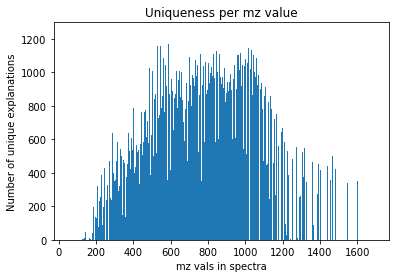

In [10]:
plt.bar(unique_matched_masses.keys(), [len(unique_matched_masses[x]) for x in unique_matched_masses.keys()])
plt.title('Uniqueness per mz value')
plt.xlabel("mz vals in spectra")
plt.ylabel("Number of unique explanations")

In [11]:
len_array = [len(unique_matched_masses[x]) for x in unique_matched_masses.keys()]
print(max(len_array), min(len_array))
print(sum(len_array)/len(len_array))

1237 0
299.99302832244007


# How many precursors have ambiguous masses?

In [ ]:
unique_from_precursors = dict()
precursor_array
for spectra in input_spectrum:
    
for key in unique_matched_masses:
    if key 

# What SpecMill sequences have max length between 20 and 23?

In [6]:
for i, ans in enumerate(correct_sequences):
    if len(ans) > 20 and len(ans) <= 23:
        print(i, ans)

19 DTGAGSIREAGGAFGKREKAEE
20 DTGAGSIREAGGAFGKREKAEE
22 DVTKGRKFYGPEGPYGVFAGR
31 DSRGGGGNFGPGPGSNFRGGS
43 DRETQRSRGFGFITFTNPEHAS
70 DPQVAQLELGGGPGAGDLQTLAL
80 DEVGGEALGRLLVVYPWTQRYF
96 DDLGKGGNEESTKTGNAGSRLA
101 DRVISLSGEHSIIGRTMVVHEKQ
110 DHVTNLRKMGAPEAGMAEYLF
117 DFPEFLTMMARKMKDTDSEEEIR
124 DFPEFLTMMARKMKDTDSEEEIR
129 DFPEFLTMMARKMKDTDSEEEIR
147 VEYPAHQAMNLVGPQSIEGGAH
152 DYPGLGKWNKKLLYEKMKGGQ
187 DLGATWVVLGHSERRHVFGES
236 DQELESLSAIEAELEKVAHQL
237 DQELESLSAIEAELEKVAHQLQ
238 DQELESLSAIEAELEKVAHQLQA
245 DQELESLSAIEAELEKVAHQLQA
285 LLSDTVRPTNAALPTDAAYPA
286 DGSPNAGTVEQTPKKPGLRRQT
296 DEVAEALQKLISKEANNYEETL
300 DKIVSKLLNLGLITESQAHTLE
304 DKIVSKLLNLGLITESQAHTLE
308 DNLNLLRAITEKETVEKERQSI
321 DEEKFITIFGTRSVSHLRRVF
352 DFPEEVAIAEELGRRHADGSFS
359 DTEENPRSFPASQTEAHEDPDEM
364 DVSSYLEGQAAKEFIAWLVKGR
371 ENPRSFPASQTEAHEDPDEMNED
374 LQDTEENPRSFPASQTEAHEDP
377 QDTEENPRSFPASQTEAHEDP
381 DFPEEVAIAEELGRRHADGSFS
383 DVSSYLEGQAAKEFIAWLVKGR
395 SSYLEGQAAKEFIAWLVKGRGRR
396 SYLEGQAAKEFIAWLVKGRGRR
397 YLEG

In [28]:
def Merge(dict1, dict2):
    return(dict2.update(dict1))

Merge(matched_masses_b, matched_masses_y)

Text(0, 0.5, 'Number of unique explanations')

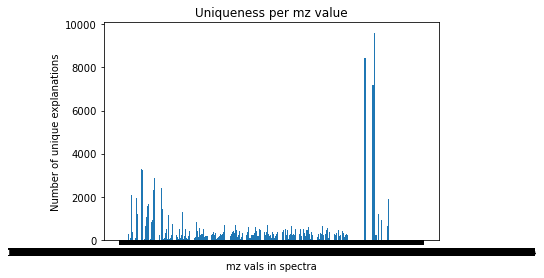

In [29]:
plt.bar(matched_masses_y.keys(), [len(matched_masses_y[x]) for x in matched_masses_y.keys()])
plt.title('Uniqueness per mz value')
plt.xlabel("mz vals in spectra")
plt.ylabel("Number of unique explanations")